In [1]:
#import dicom
import pydicom as dc
import os
import numpy as np
import matplotlib as plt
import natsort as ns
import cv2
#print(cv2.__version__)
#%pylab inline
#import imutils
#import scipy
from scipy import ndimage
from matplotlib import pyplot
import imutils

In [2]:
# Use os to get list of filepaths:

dataDir = r'C:\\DICOM'

fpaths = []  # create an empty list of all DICOM file paths

for dirName, subdirList, fileList in os.walk(dataDir):
    for filename in fileList:
        if ".dcm" in filename.lower():  # check for DICOM files only
            fpaths.append(os.path.join(dirName,filename))
            
#len(fpaths) # =22 (OK)

# Since ordering is 3-1, 3-10, 3-11, ... 
# use natsort to sort in natural way:
fpaths = ns.natsorted(fpaths)

In [9]:
# Try reading in a file:
frame = dc.read_file(fpaths[11])
#frame = dc.read_file(fpaths[11], dtype=np.int8)


#someData
frame.pixel_array

array([[15,  9, 10, ..., 25, 19, 21],
       [ 2, 10, 16, ..., 18, 26, 20],
       [ 7, 16, 13, ..., 15, 30, 23],
       ...,
       [ 5,  6,  6, ..., 47, 45, 38],
       [17, 10,  6, ..., 46, 45, 38],
       [17,  4,  9, ..., 55, 37, 42]], dtype=uint16)

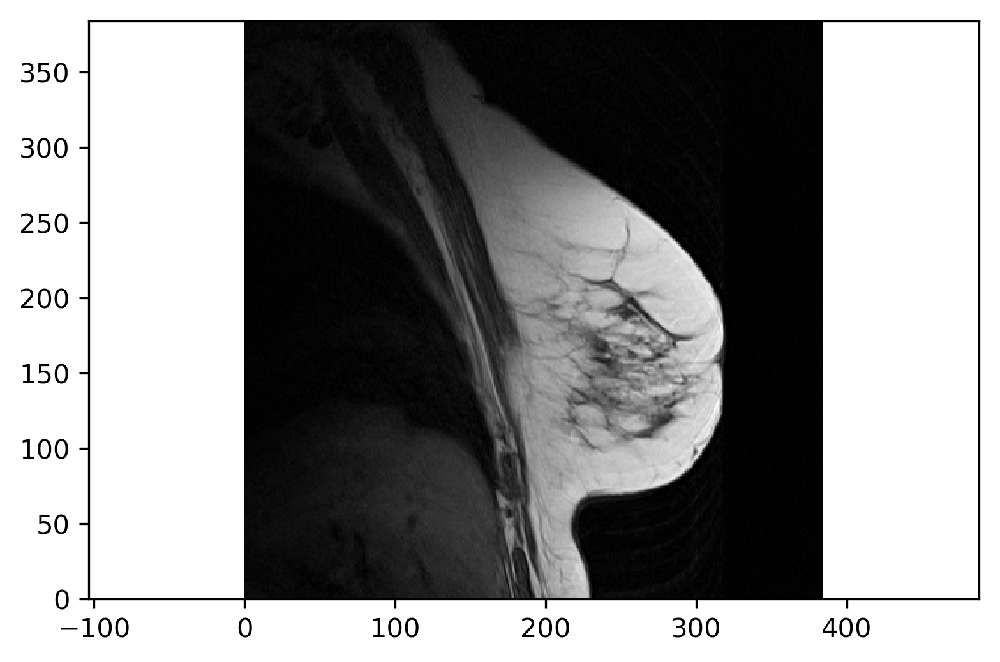

In [10]:
# Plot data:
pyplot.figure(dpi=300)
pyplot.axes().set_aspect('equal', 'datalim')
pyplot.set_cmap(pyplot.gray())
#pyplot.pcolormesh(someData.pixel_array);
pyplot.pcolormesh(np.fliplr(np.flipud(frame.pixel_array)));

In [11]:
# Now load in all images and store in 3D numpy array:

# Need to create an empty array so need dims:

# The 3D array will have dims Columns x Rows x Slices (X x Y x Z):
"""
data.Columns  =384
data.Rows  =384
"""
dimX = frame.Columns
dimY = frame.Rows
dimZ = len(fpaths)

print('Pixel dims = ', dimX , 'x', dimY, 'x', dimZ, '\n')

# To display the images in the correct physiological scalings, 
# need to know the pixel spacing (dpix) along x, y and z:
"""
data.PixelSpacing  = ['0.625', '0.625'] <-- strings
data.SliceThickness  = '4' <-- string
"""
dpixY = float(frame.PixelSpacing[0])
dpixX = float(frame.PixelSpacing[1])
dpixZ = float(frame.SliceThickness)

print('Pixel spacing = ', dpixX , 'x', dpixY, 'x', dpixZ, '\n')

# Create empty 3D array using same datatype as pixel_array:
data = np.zeros((dimY, dimX, dimZ), dtype=frame.pixel_array.dtype)

#data.shape # = (384, 384, 22)

# Create x, y and z axes for plotting:
x = np.arange(0.0, dimX*dpixX, dpixX)
y = np.arange(0.0, dimY*dpixY, dpixY)
z = np.arange(0.0, dimZ*dpixZ, dpixZ)

print('Axes lengths = ', x.shape , 'x', y.shape, 'x', z.shape, '\n')

# Load image data into data array by looping through each slice:
for f in range(dimZ):
    frame = dc.read_file(fpaths[f])
    #frame = np.fliplr(np.flipud(frame)) # fliplf and flipup
    
    data[:, :, f] = frame.pixel_array # store in array
    
data = np.fliplr(np.flipud(data)) # fliplf and flipup

print('data.shape = ', data.shape, '\n')

Pixel dims =  384 x 384 x 22 

Pixel spacing =  0.625 x 0.625 x 4.0 

Axes lengths =  (384,) x (384,) x (22,) 

data.shape =  (384, 384, 22) 



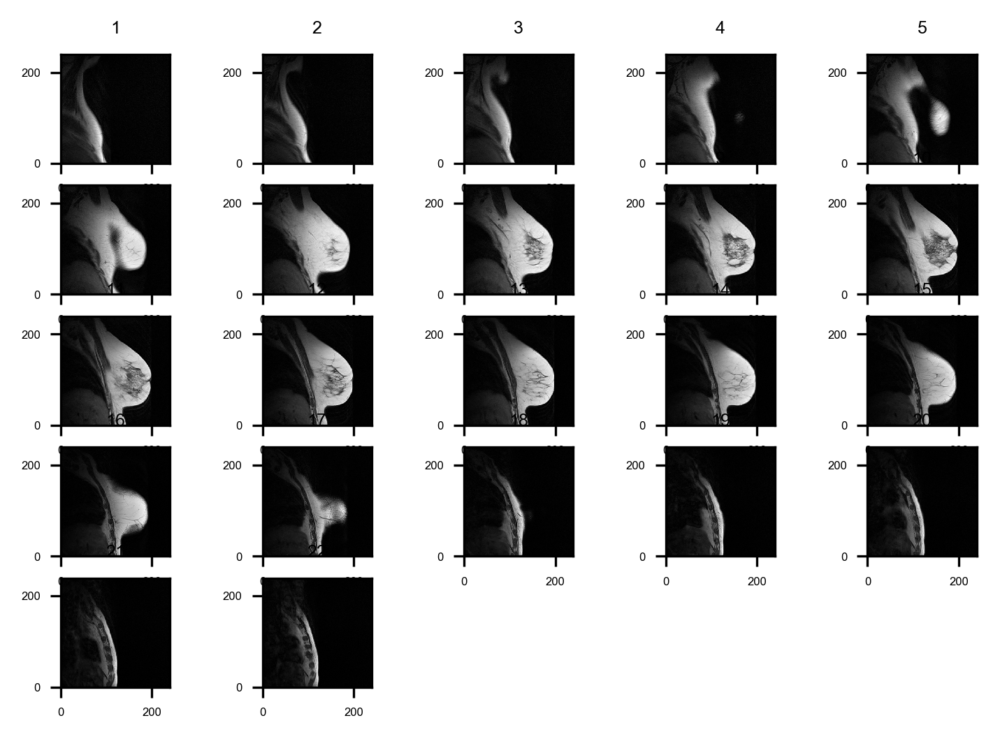

In [12]:
# Display all frames:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(dpi=300)

for f in range(dimZ):
    frame = data[:,:,f]

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

for f in range(dimZ):
    pyplot.figure(dpi=300)
    pyplot.axes().set_aspect('equal', 'datalim')
    pyplot.set_cmap(pyplot.gray())
    pyplot.pcolormesh(x, y, np.fliplf(np.flipud(data[:, :, f])))

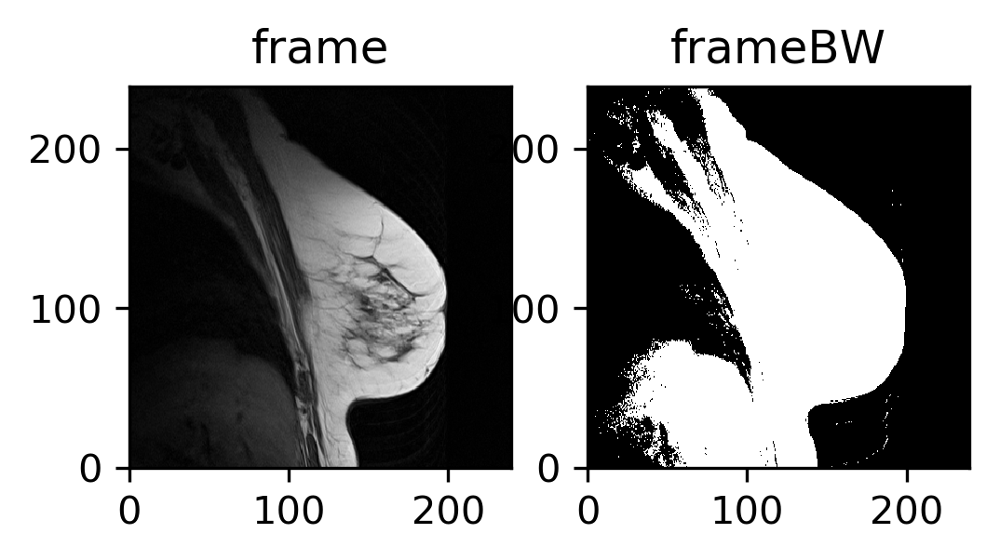

In [14]:
# Now start working on segmenting the images. Start with the background
# as it should be the easiest:

# Define threshold for B&W image:
thresh = 5
thresh = 20
#thresh = 25
#thresh = 30
thresh = 50
thresh = 60
#thresh = 70


# Work on one slice for now:
f = 11
#frame = np.fliplr(np.flipud(data[:, :, f]))
frame = data[:, :, f]

# Convert to B&W using thresh as threshold:
frameBW = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]
    
pyplot.figure(dpi=300)
#pyplot.axes().set_aspect('equal', 'datalim')
pyplot.set_cmap(pyplot.gray())
pyplot.subplot(2,3,1, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.title('frame')
pyplot.subplot(2,3,2, aspect='equal')
pyplot.pcolormesh(x, y, frameBW);
pyplot.title('frameBW');

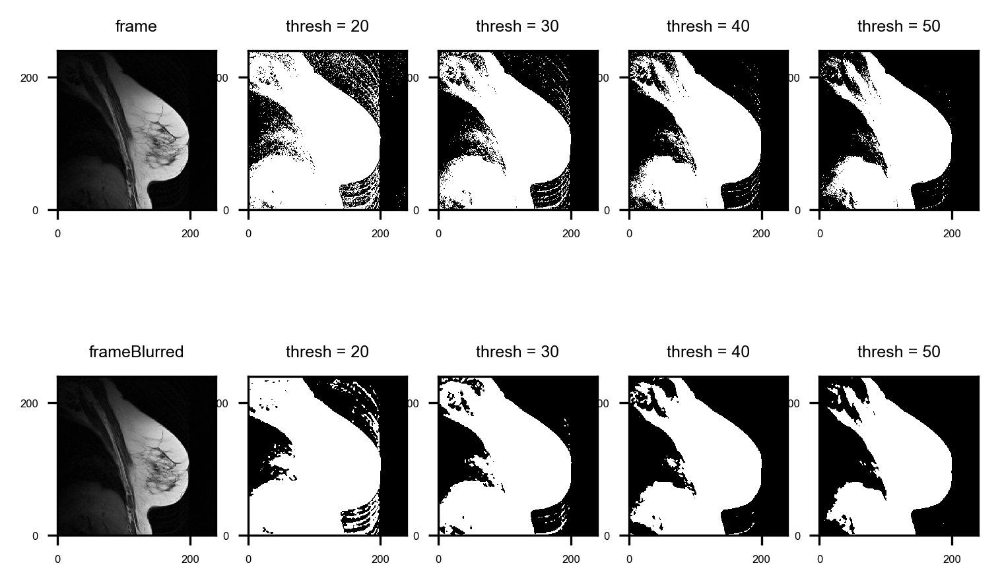

In [7]:
# Now start working on segmenting the images. Start with the background
# as it should be the easiest:

# Define threshold for B&W image:
thresh = 5
thresh = 20
#thresh = 25
#thresh = 30
thresh = 50
thresh = 60
#thresh = 70

threshs = [5, 20, 30, 40, 50, 60]
threshs = [20, 30, 40, 50]

# Work on one slice for now:
f = 11
#frame = np.fliplr(np.flipud(data[:, :, f]))
frame = data[:, :, f]

blurKernel = 5
blurKernel = 7

frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)


# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(dpi=300)

ax = pyplot.subplot(251, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.title('frame', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(256, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.title('frameBlurred', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

for t in range(len(threshs)):
    thresh = threshs[t]
    
    # Convert to B&W using thresh as threshold:
    frameBW = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]
    frameBlurredBW = cv2.threshold(frameBlurred, thresh, 255, cv2.THRESH_BINARY)[1]

    ax = pyplot.subplot(2,5,2+t, aspect='equal')
    pyplot.pcolormesh(x, y, frameBW);
    pyplot.title('thresh = ' + str(thresh), **title_font)
    #pyplot.xlabel('', **axis_font)
    #pyplot.ylabel('', **axis_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
        
    ax = pyplot.subplot(2,5,7+t, aspect='equal')
    pyplot.pcolormesh(x, y, frameBlurredBW);
    pyplot.title('thresh = ' + str(thresh), **title_font)
    #pyplot.xlabel('', **axis_font)
    #pyplot.ylabel('', **axis_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    


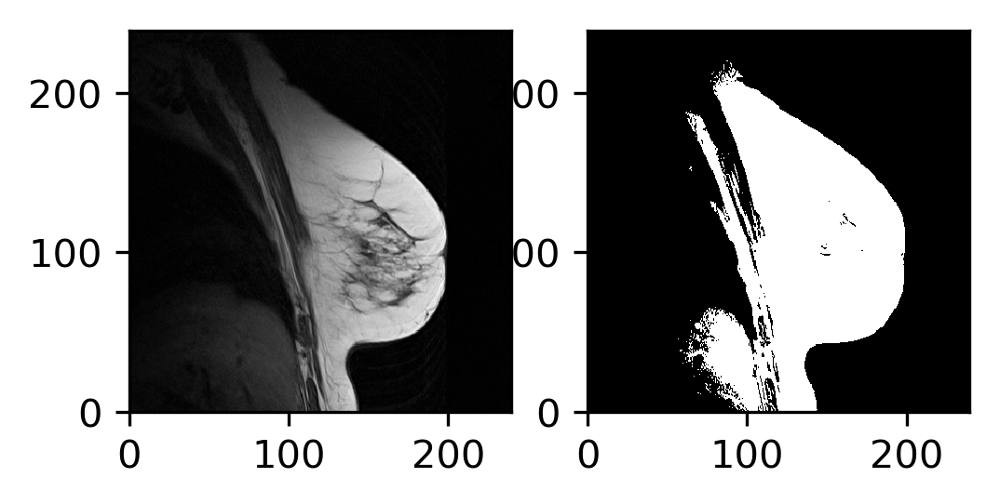

In [154]:
# Take mean intensity of image and use that as threshold:

mask = numpy.zeros((dimY, dimX), dtype='bool')

frameAve = np.average(frame)

for r in range(dimY):
    for c in range(dimX):
        if frame[r,c] > frameAve:
            mask[r,c] = 1
            
pyplot.figure(dpi=300)
#pyplot.axes().set_aspect('equal', 'datalim')
pyplot.set_cmap(pyplot.gray())
pyplot.subplot(231, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.subplot(232, aspect='equal')
pyplot.pcolormesh(x, y, mask);

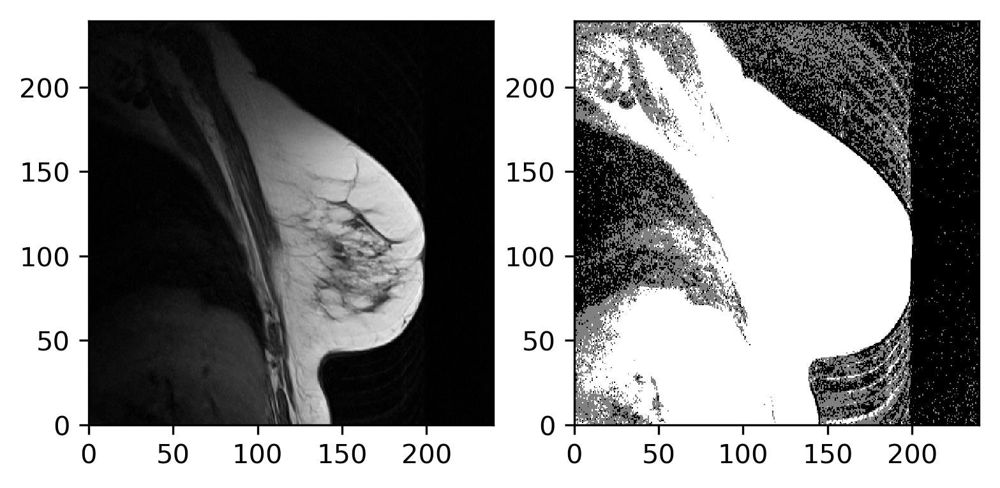

In [128]:
# Use many thresholds:

thresh_background = 2
thresh_body = 15
thresh_breast = 40

mask = numpy.zeros((dimY, dimX), dtype='float')

frameAve = np.average(frame)

for r in range(dimY):
    for c in range(dimX):
        if frame[r,c] < thresh_background:
            mask[r,c] = 0
        elif frame[r,c] > thresh_body and frame[r,c] < thresh_breast:
            mask[r,c] = 0.5
        elif frame[r,c] > thresh_breast:
            mask[r,c] = 1
            
            
pyplot.figure(dpi=300)
#pyplot.axes().set_aspect('equal', 'datalim')
pyplot.set_cmap(pyplot.gray())
pyplot.subplot(121, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.subplot(122, aspect='equal')
pyplot.pcolormesh(x, y, mask);

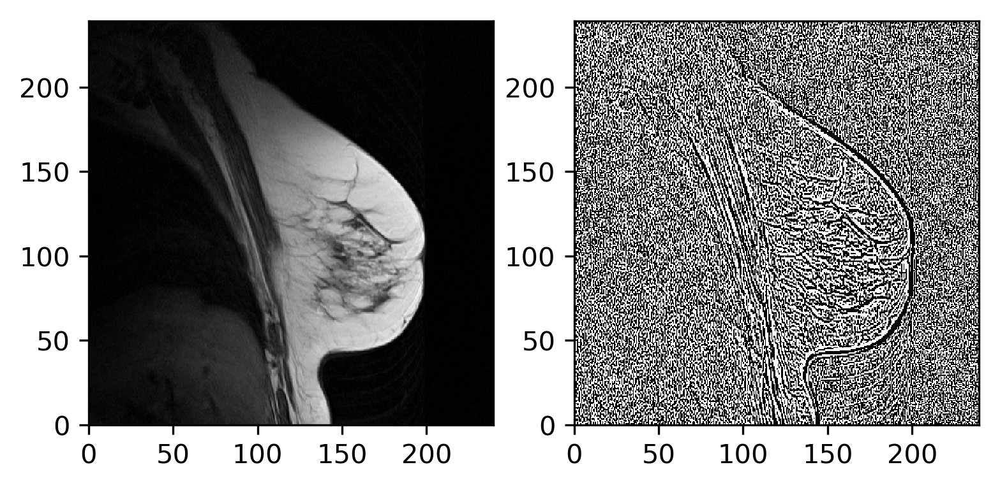

In [15]:
kernel_laplace = np.array([np.array([1, 1, 1]), np.array([1, -8, 1]), np.array([1, 1, 1])])

result = ndimage.convolve(frame, kernel_laplace, mode='reflect')

pyplot.figure(dpi=300)
#pyplot.axes().set_aspect('equal', 'datalim')
pyplot.set_cmap(pyplot.gray())
pyplot.subplot(121, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.subplot(122, aspect='equal')
pyplot.pcolormesh(x, y, result);

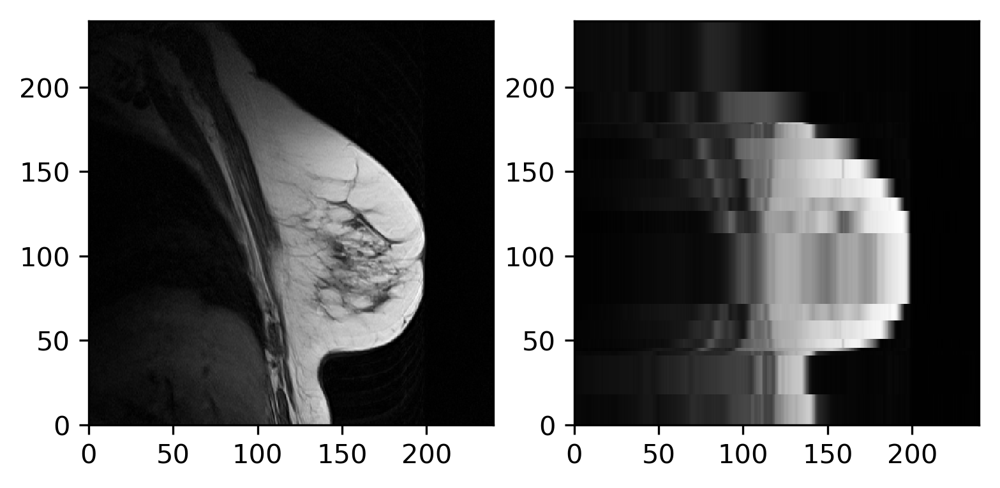

In [20]:
# Try using k-means clustering:

from sklearn.cluster import KMeans
#kmeans = KMeans(n_clusters=3, random_state=0).fit(frame)
kmeans = KMeans(n_clusters=10, random_state=0).fit(frame)
result = kmeans.cluster_centers_[kmeans.labels_]

pyplot.figure(dpi=300)
#pyplot.axes().set_aspect('equal', 'datalim')
pyplot.set_cmap(pyplot.gray())
pyplot.subplot(121, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.subplot(122, aspect='equal')
pyplot.pcolormesh(x, y, result);

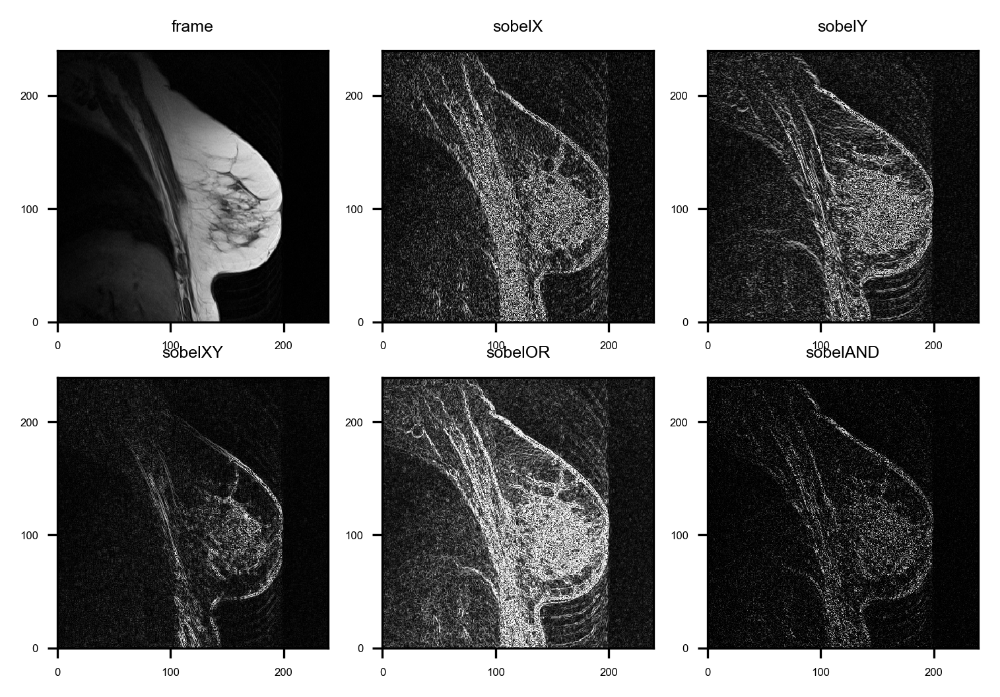

In [8]:
sobelX = cv2.Sobel(frame, cv2.CV_64F, 1, 0)
sobelY = cv2.Sobel(frame, cv2.CV_64F, 0, 1)
sobelXY = cv2.Sobel(frame, cv2.CV_64F, 1, 1)

sobelX = np.uint8(np.absolute(sobelX))
sobelY = np.uint8(np.absolute(sobelY))
sobelXY = np.uint8(np.absolute(sobelXY))

sobelOR = cv2.bitwise_or(sobelX, sobelY)
sobelAND = cv2.bitwise_and(sobelX, sobelY)

pyplot.figure(dpi=300)

ax = pyplot.subplot(231, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.title('frame', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
        
ax = pyplot.subplot(232, aspect='equal')
pyplot.pcolormesh(x, y, sobelX);
pyplot.title('sobelX', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(233, aspect='equal')
pyplot.pcolormesh(x, y, sobelY);
pyplot.title('sobelY', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(234, aspect='equal')
pyplot.pcolormesh(x, y, sobelXY);
pyplot.title('sobelXY', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(235, aspect='equal')
pyplot.pcolormesh(x, y, sobelOR);
pyplot.title('sobelOR', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(236, aspect='equal')
pyplot.pcolormesh(x, y, sobelAND);
pyplot.title('sobelAND', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

In [239]:
sobelXY.dtype

dtype('uint8')

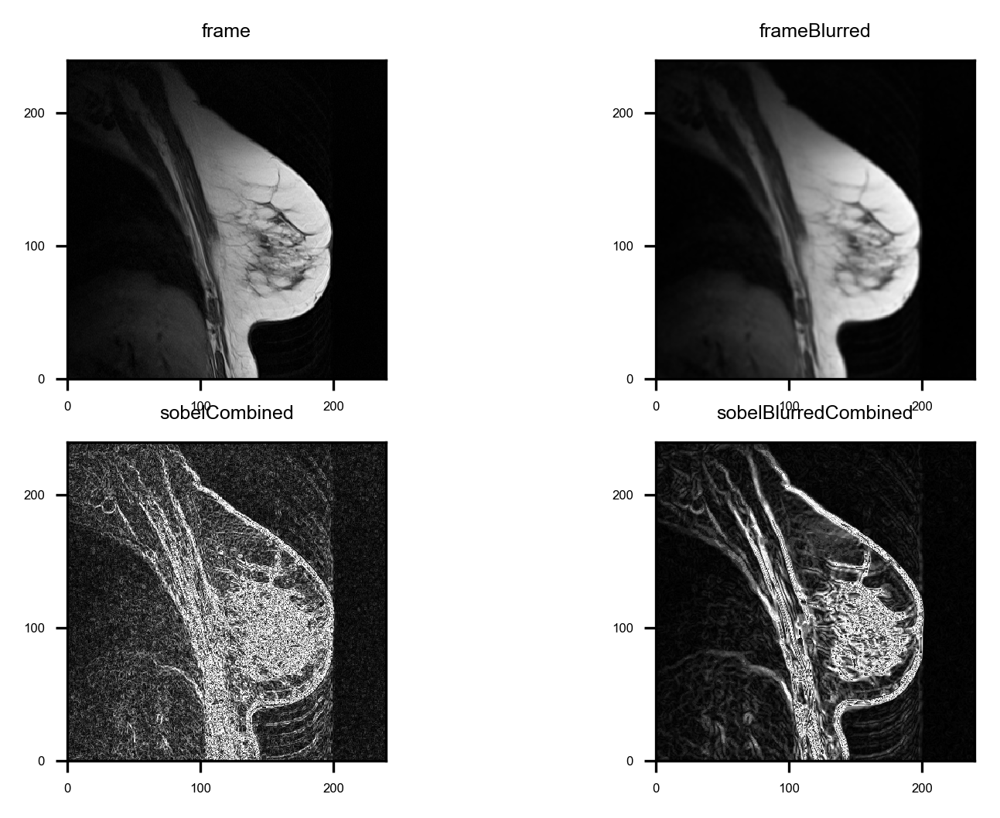

In [9]:
sobelX = cv2.Sobel(frame, cv2.CV_64F, 1, 0)
sobelY = cv2.Sobel(frame, cv2.CV_64F, 0, 1)
sobelXY = cv2.Sobel(frame, cv2.CV_64F, 1, 1)

sobelX2 = np.uint8(np.absolute(sobelX))
sobelY2 = np.uint8(np.absolute(sobelY))
sobelCombined = cv2.bitwise_or(sobelX2, sobelY2)

sobelBlurredX = cv2.Sobel(frameBlurred, cv2.CV_64F, 1, 0)
sobelBlurredY = cv2.Sobel(frameBlurred, cv2.CV_64F, 0, 1)
sobelBlurredXY = cv2.Sobel(frameBlurred, cv2.CV_64F, 1, 1)

sobelBlurredX2 = np.uint8(np.absolute(sobelBlurredX))
sobelBlurredY2 = np.uint8(np.absolute(sobelBlurredY))
sobelBlurredCombined = cv2.bitwise_or(sobelBlurredX2, sobelBlurredY2)

pyplot.figure(dpi=300)

ax = pyplot.subplot(221, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.title('frame', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
        
ax = pyplot.subplot(222, aspect='equal')
pyplot.pcolormesh(x, y, frameBlurred);
pyplot.title('frameBlurred', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(223, aspect='equal')
pyplot.pcolormesh(x, y, sobelCombined);
pyplot.title('sobelCombined', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(224, aspect='equal')
pyplot.pcolormesh(x, y, sobelBlurredCombined);
pyplot.title('sobelBlurredCombined', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

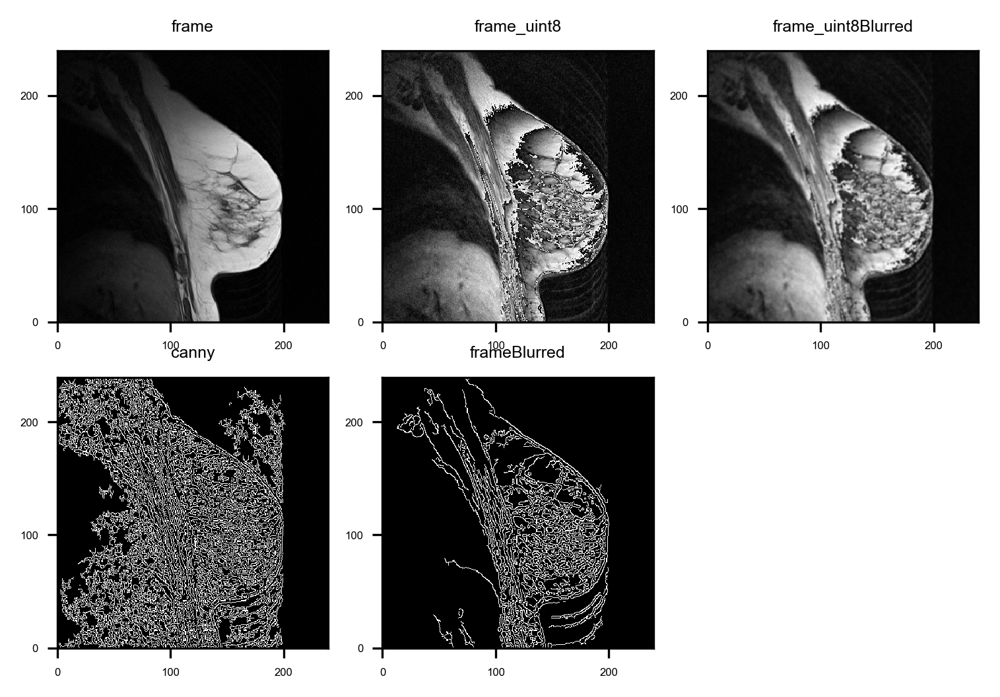

In [14]:
blurKernel = 5

frame_uint8 = np.uint8(frame)

frame_uint8Blurred = cv2.GaussianBlur(frame_uint8, (blurKernel, blurKernel), 0)

thresh_nonEdges = 30
thresh_edges = 150

canny = cv2.Canny(frame_uint8, thresh_nonEdges, thresh_edges)

cannyBlurred = cv2.Canny(frame_uint8Blurred, thresh_nonEdges, thresh_edges)

pyplot.figure(dpi=300)

ax = pyplot.subplot(231, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.title('frame', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(232, aspect='equal')
pyplot.pcolormesh(x, y, frame_uint8);
pyplot.title('frame_uint8', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(233, aspect='equal')
pyplot.pcolormesh(x, y, frame_uint8Blurred);
pyplot.title('frame_uint8Blurred', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(234, aspect='equal')
pyplot.pcolormesh(x, y, canny);
pyplot.title('canny', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(235, aspect='equal')
pyplot.pcolormesh(x, y, cannyBlurred);
pyplot.title('frameBlurred', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

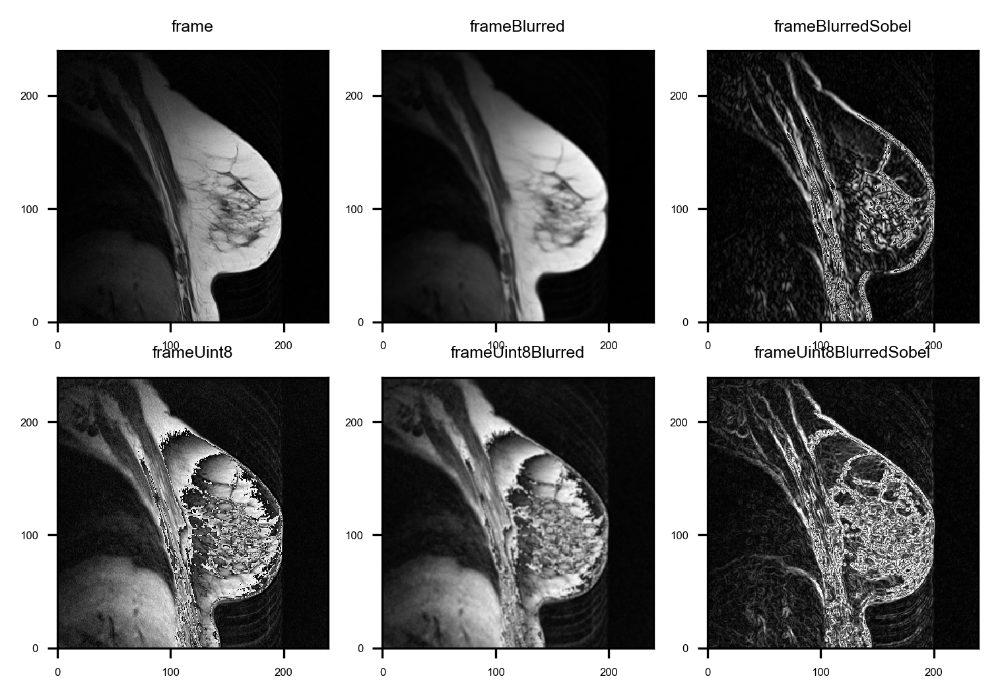

In [10]:
frameBlurredSobelX = cv2.Sobel(frameBlurred, cv2.CV_64F, 1, 0)
frameBlurredSobelY = cv2.Sobel(frameBlurred, cv2.CV_64F, 0, 1)
frameBlurredSobelX = np.uint8(np.absolute(frameBlurredSobelX))
frameBlurredSobelY = np.uint8(np.absolute(frameBlurredSobelY))
frameBlurredSobel = cv2.bitwise_or(frameBlurredSobelX, frameBlurredSobelX)

frameUint8 = np.uint8(frame)

frameUint8SobelX = cv2.Sobel(frameUint8, cv2.CV_64F, 1, 0)
frameUint8SobelY = cv2.Sobel(frameUint8, cv2.CV_64F, 0, 1)
frameUint8SobelX = np.uint8(np.absolute(frameUint8SobelX))
frameUint8SobelY = np.uint8(np.absolute(frameUint8SobelY))
frameUint8Sobel = cv2.bitwise_or(frameUint8SobelX, frameUint8SobelY)

blurKernel = 5
frameUint8Blurred = cv2.GaussianBlur(frameUint8, (blurKernel, blurKernel), 0)

frameUint8BlurredSobelX = cv2.Sobel(frameUint8Blurred, cv2.CV_64F, 1, 0)
frameUint8BlurredSobelY = cv2.Sobel(frameUint8Blurred, cv2.CV_64F, 0, 1)
frameUint8BlurredSobelX = np.uint8(np.absolute(frameUint8BlurredSobelX))
frameUint8BlurredSobelY = np.uint8(np.absolute(frameUint8BlurredSobelY))
frameUint8BlurredSobel = cv2.bitwise_or(frameUint8BlurredSobelX, frameUint8BlurredSobelY)


pyplot.figure(dpi=300)

ax = pyplot.subplot(231, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.title('frame', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(232, aspect='equal')
pyplot.pcolormesh(x, y, frameBlurred);
pyplot.title('frameBlurred', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

ax = pyplot.subplot(233, aspect='equal')
pyplot.pcolormesh(x, y, frameBlurredSobel);
pyplot.title('frameBlurredSobel', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(234, aspect='equal')
pyplot.pcolormesh(x, y, frameUint8);
pyplot.title('frameUint8', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(235, aspect='equal')
pyplot.pcolormesh(x, y, frameUint8Blurred);
pyplot.title('frameUint8Blurred', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    

ax = pyplot.subplot(236, aspect='equal')
pyplot.pcolormesh(x, y, frameUint8BlurredSobel);
pyplot.title('frameUint8BlurredSobel', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

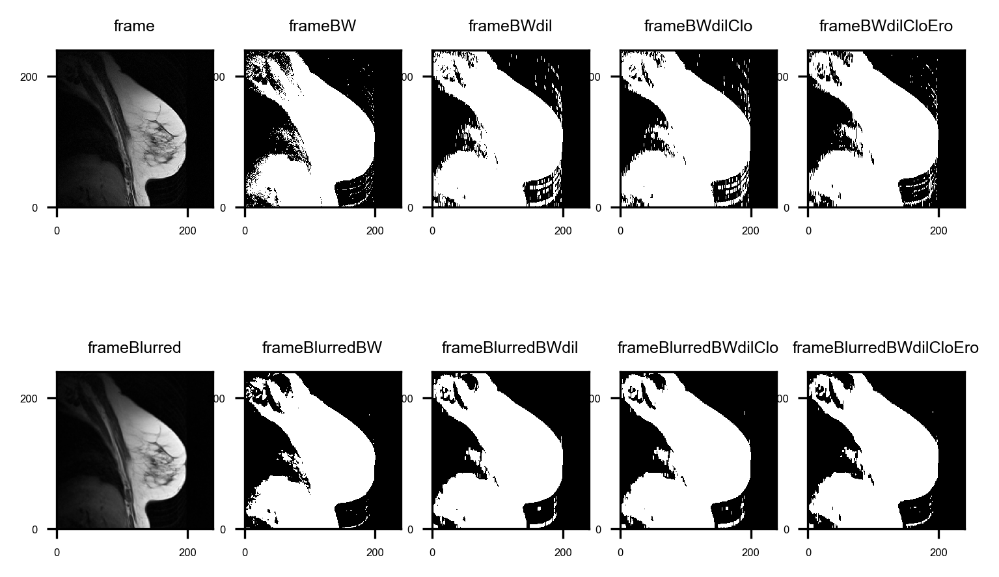

In [11]:
# Define threshold for B&W image:
thresh = 5
thresh = 20
#thresh = 25
thresh = 30
thresh = 40
#thresh = 50
#thresh = 60
#thresh = 70

blurKernel = 5
frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)

# Convert to B&W using 'Tolerance' as threshold:
frameBW = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]
frameBlurredBW = cv2.threshold(frameBlurred, thresh, 255, cv2.THRESH_BINARY)[1]


# Dilate diffBW:
kernel = 3
iters = 7

#diffBWdil = cv2.dilate(diffBW, Kernel5, iterations = 10) # dilate
#diffBWdil = cv2.dilate(diffBW, Kernel2, iterations = 5) # dilate (holes not closing with kernel2)
#diffBWdil = cv2.dilate(diffBW, Kernel3, iterations = 5) # dilate (better)
frameBWdil = cv2.dilate(frameBW, (kernel, kernel), iterations = iters) # dilate (seems decent)
frameBlurredBWdil = cv2.dilate(frameBlurredBW, (kernel, kernel), iterations = iters) # dilate (seems decent)

# Close holes in diffBWdil:
kernel = 11
#diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel3) # close holes (seem decent)
#diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel5) # close holes (a bit better)
frameBWdilClo = cv2.morphologyEx(frameBWdil, cv2.MORPH_CLOSE, (kernel, kernel)) # close holes (seems fine)
frameBlurredBWdilClo = cv2.morphologyEx(frameBlurredBWdil, cv2.MORPH_CLOSE, (kernel, kernel)) # close holes (seems fine)

# Erode diffBWdilClo:
kernel = 3
iters = 5
#diffBWdilCloEro = cv2.erode(diffBWdilClo, Kernel5, iterations = 5) # erode (a bit too much)
frameBWdilCloEro = cv2.erode(frameBWdilClo, (kernel, kernel), iterations = iters) # erode (seems decent)
frameBlurredBWdilCloEro = cv2.erode(frameBlurredBWdilClo, (kernel, kernel), iterations = iters) # erode (seems decent)

pyplot.figure(dpi=300)

ax = pyplot.subplot(251, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.title('frame', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(252, aspect='equal')
pyplot.pcolormesh(x, y, frameBW);
pyplot.title('frameBW', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

ax = pyplot.subplot(253, aspect='equal')
pyplot.pcolormesh(x, y, frameBWdil);
pyplot.title('frameBWdil', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(254, aspect='equal')
pyplot.pcolormesh(x, y, frameBWdilClo);
pyplot.title('frameBWdilClo', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(255, aspect='equal')
pyplot.pcolormesh(x, y, frameBWdilCloEro);
pyplot.title('frameBWdilCloEro', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(256, aspect='equal')
pyplot.pcolormesh(x, y, frameBlurred);
pyplot.title('frameBlurred', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

ax = pyplot.subplot(257, aspect='equal')
pyplot.pcolormesh(x, y, frameBlurredBW);
pyplot.title('frameBlurredBW', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(258, aspect='equal')
pyplot.pcolormesh(x, y, frameBlurredBWdil);
pyplot.title('frameBlurredBWdil', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(259, aspect='equal')
pyplot.pcolormesh(x, y, frameBlurredBWdilClo);
pyplot.title('frameBlurredBWdilClo', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(2,5,10, aspect='equal')
pyplot.pcolormesh(x, y, frameBlurredBWdilCloEro);
pyplot.title('frameBlurredBWdilCloEro', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

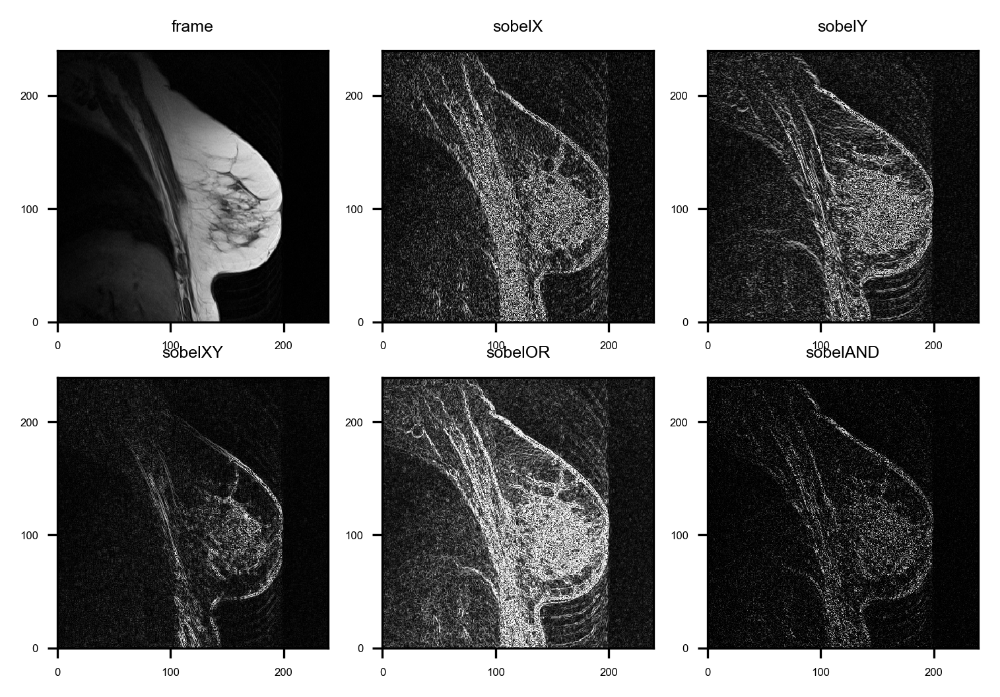

In [12]:
sobelX = cv2.Sobel(frame, cv2.CV_64F, 1, 0)
sobelY = cv2.Sobel(frame, cv2.CV_64F, 0, 1)
sobelXY = cv2.Sobel(frame, cv2.CV_64F, 1, 1)

sobelX = np.uint8(np.absolute(sobelX))
sobelY = np.uint8(np.absolute(sobelY))
sobelXY = np.uint8(np.absolute(sobelXY))

sobelOR = cv2.bitwise_or(sobelX, sobelY)
sobelAND = cv2.bitwise_and(sobelX, sobelY)

pyplot.figure(dpi=300)

ax = pyplot.subplot(231, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.title('frame', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
        
ax = pyplot.subplot(232, aspect='equal')
pyplot.pcolormesh(x, y, sobelX);
pyplot.title('sobelX', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(233, aspect='equal')
pyplot.pcolormesh(x, y, sobelY);
pyplot.title('sobelY', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(234, aspect='equal')
pyplot.pcolormesh(x, y, sobelXY);
pyplot.title('sobelXY', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(235, aspect='equal')
pyplot.pcolormesh(x, y, sobelOR);
pyplot.title('sobelOR', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(236, aspect='equal')
pyplot.pcolormesh(x, y, sobelAND);
pyplot.title('sobelAND', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

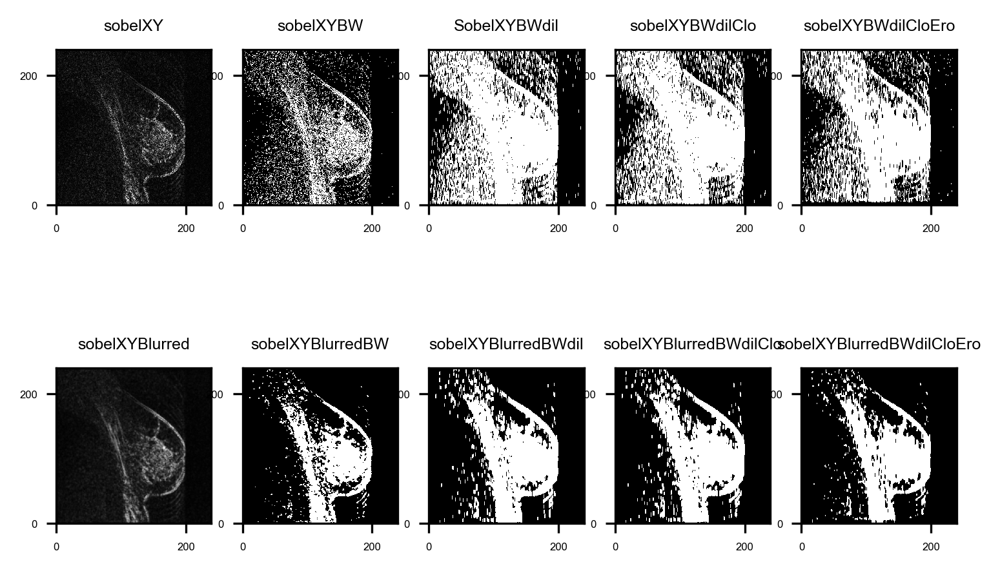

In [13]:
# Define threshold for B&W image:
thresh = 5
thresh = 20
thresh = 25
#thresh = 30
#thresh = 40
#thresh = 50
#thresh = 60
#thresh = 70

blurKernel = 5
sobelXYBlurred = cv2.GaussianBlur(sobelXY, (blurKernel, blurKernel), 0)

# Convert to B&W using 'Tolerance' as threshold:
sobelXYBW = cv2.threshold(sobelXY, thresh, 255, cv2.THRESH_BINARY)[1]
sobelXYBlurredBW = cv2.threshold(sobelXYBlurred, thresh, 255, cv2.THRESH_BINARY)[1]


# Dilate diffBW:
kernel = 3
iters = 7

#diffBWdil = cv2.dilate(diffBW, Kernel5, iterations = 10) # dilate
#diffBWdil = cv2.dilate(diffBW, Kernel2, iterations = 5) # dilate (holes not closing with kernel2)
#diffBWdil = cv2.dilate(diffBW, Kernel3, iterations = 5) # dilate (better)
sobelXYBWdil = cv2.dilate(sobelXYBW, (kernel, kernel), iterations = iters) # dilate (seems decent)
sobelXYBlurredBWdil = cv2.dilate(sobelXYBlurredBW, (kernel, kernel), iterations = iters) # dilate (seems decent)

# Close holes in diffBWdil:
kernel = 11
#diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel3) # close holes (seem decent)
#diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel5) # close holes (a bit better)
sobelXYBWdilClo = cv2.morphologyEx(sobelXYBWdil, cv2.MORPH_CLOSE, (kernel, kernel)) # close holes (seems fine)
sobelXYBlurredBWdilClo = cv2.morphologyEx(sobelXYBlurredBWdil, cv2.MORPH_CLOSE, (kernel, kernel)) # close holes (seems fine)

# Erode diffBWdilClo:
kernel = 3
iters = 5
#diffBWdilCloEro = cv2.erode(diffBWdilClo, Kernel5, iterations = 5) # erode (a bit too much)
sobelXYBWdilCloEro = cv2.erode(sobelXYBWdilClo, (kernel, kernel), iterations = iters) # erode (seems decent)
sobelXYBlurredBWdilCloEro = cv2.erode(sobelXYBlurredBWdilClo, (kernel, kernel), iterations = iters) # erode (seems decent)

pyplot.figure(dpi=300)

ax = pyplot.subplot(251, aspect='equal')
pyplot.pcolormesh(x, y, sobelXY);
pyplot.title('sobelXY', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(252, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBW);
pyplot.title('sobelXYBW', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

ax = pyplot.subplot(253, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBWdil);
pyplot.title('SobelXYBWdil', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(254, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBWdilClo);
pyplot.title('sobelXYBWdilClo', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(255, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBWdilCloEro);
pyplot.title('sobelXYBWdilCloEro', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(256, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBlurred);
pyplot.title('sobelXYBlurred', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

ax = pyplot.subplot(257, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBlurredBW);
pyplot.title('sobelXYBlurredBW', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(258, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBlurredBWdil);
pyplot.title('sobelXYBlurredBWdil', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(259, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBlurredBWdilClo);
pyplot.title('sobelXYBlurredBWdilClo', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(2,5,10, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBlurredBWdilCloEro);
pyplot.title('sobelXYBlurredBWdilCloEro', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

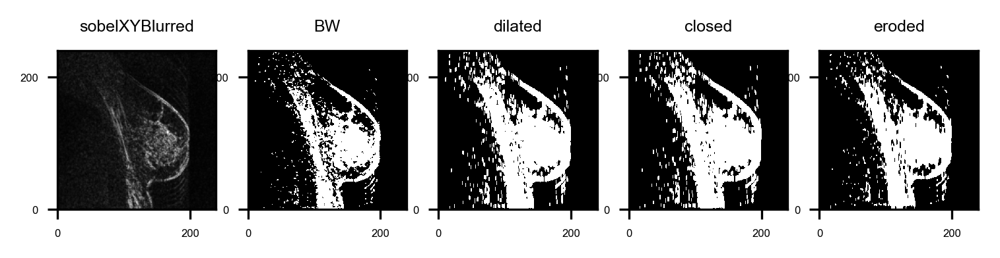

In [14]:
# Define threshold for B&W image:
thresh = 5
thresh = 20
thresh = 25
#thresh = 30
#thresh = 40
#thresh = 50
#thresh = 60
#thresh = 70

blurKernel = 5
sobelXYBlurred = cv2.GaussianBlur(sobelXY, (blurKernel, blurKernel), 0)

# Convert to B&W using 'Tolerance' as threshold:
sobelXYBW = cv2.threshold(sobelXY, thresh, 255, cv2.THRESH_BINARY)[1]
sobelXYBlurredBW = cv2.threshold(sobelXYBlurred, thresh, 255, cv2.THRESH_BINARY)[1]


# Dilate diffBW:
kernel = 3
#kernel = 11
iters = 7
#iters = 21

#diffBWdil = cv2.dilate(diffBW, Kernel5, iterations = 10) # dilate
#diffBWdil = cv2.dilate(diffBW, Kernel2, iterations = 5) # dilate (holes not closing with kernel2)
#diffBWdil = cv2.dilate(diffBW, Kernel3, iterations = 5) # dilate (better)
sobelXYBWdil = cv2.dilate(sobelXYBW, (kernel, kernel), iterations = iters) # dilate (seems decent)
sobelXYBlurredBWdil = cv2.dilate(sobelXYBlurredBW, (kernel, kernel), iterations = iters) # dilate (seems decent)

# Close holes in diffBWdil:
kernel = 11
#kernel = 21
#diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel3) # close holes (seem decent)
#diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel5) # close holes (a bit better)
sobelXYBWdilClo = cv2.morphologyEx(sobelXYBWdil, cv2.MORPH_CLOSE, (kernel, kernel)) # close holes (seems fine)
sobelXYBlurredBWdilClo = cv2.morphologyEx(sobelXYBlurredBWdil, cv2.MORPH_CLOSE, (kernel, kernel)) # close holes (seems fine)

# Erode diffBWdilClo:
kernel = 3
iters = 5
#diffBWdilCloEro = cv2.erode(diffBWdilClo, Kernel5, iterations = 5) # erode (a bit too much)
sobelXYBWdilCloEro = cv2.erode(sobelXYBWdilClo, (kernel, kernel), iterations = iters) # erode (seems decent)
sobelXYBlurredBWdilCloEro = cv2.erode(sobelXYBlurredBWdilClo, (kernel, kernel), iterations = iters) # erode (seems decent)

pyplot.figure(dpi=300)
    
ax = pyplot.subplot(251, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBlurred);
pyplot.title('sobelXYBlurred', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

ax = pyplot.subplot(252, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBlurredBW);
pyplot.title('BW', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(253, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBlurredBWdil);
pyplot.title('dilated', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(254, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBlurredBWdilClo);
pyplot.title('closed', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(2,5,5, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBlurredBWdilCloEro);
pyplot.title('eroded', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

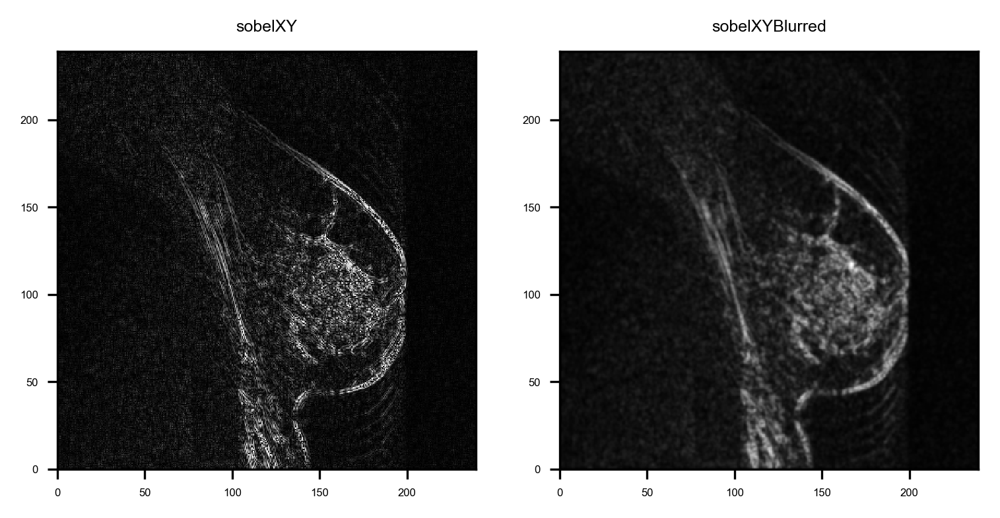

In [20]:

pyplot.figure(dpi=300)

ax = pyplot.subplot(121, aspect='equal')
pyplot.pcolormesh(x, y, sobelXY);
pyplot.title('sobelXY', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

    
ax = pyplot.subplot(122, aspect='equal')
pyplot.pcolormesh(x, y, sobelXYBlurred);
pyplot.title('sobelXYBlurred', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)


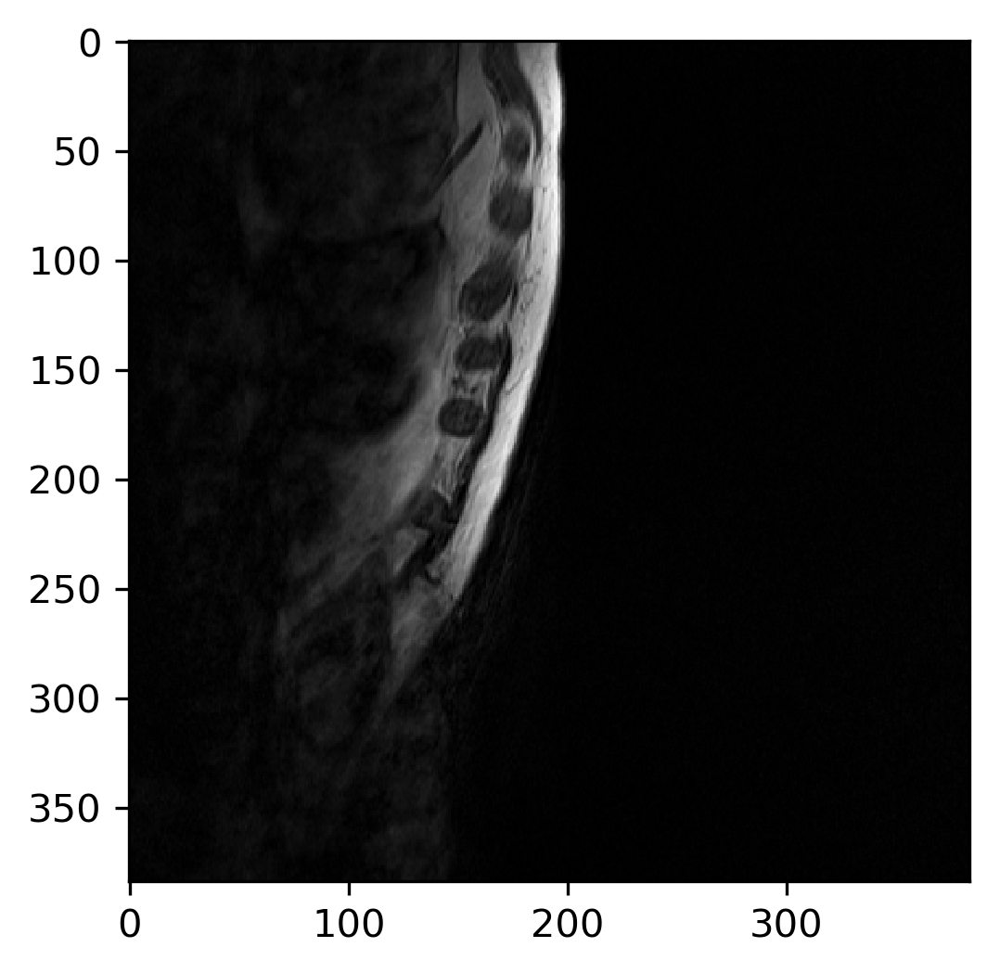

In [16]:
pyplot.figure(dpi=300)

for f in range(dimZ):
    frame = np.fliplr(np.flipud(data[:, :, f]))

    #pyplot.pcolormesh(frame);
    #cv2.imshow('frame', frame)
    pyplot.imshow(frame)
pyplot.show()
    

frame = np.fliplr(np.flipud(data[:, :, 11]))

#frameUint8 = frame.astype(np.uint8)

#cv2.imshow('try', frameUint8)
#cv2.waitKey(0)

def remove_keymap_conflicts(new_keys_set):
    for prop in plt.rcParams:
        if prop.startswith('keymap.'):
            keys = plt.rcParams[prop]
            remove_list = set(keys) & new_keys_set
            for key in remove_list:
                keys.remove(key)
                
def multi_slice_viewer(volume):
    remove_keymap_conflicts({'j', 'k'})
    fig, ax = pyplot.subplots()
    ax.volume = volume
    #ax.index = volume.shape[0] // 2
    ax.index = volume.shape[2] // 2
    ax.imshow(volume[ax.index])
    fig.canvas.mpl_connect('key_press_event', process_key)

def process_key(event):
    fig = event.canvas.figure
    ax = fig.axes[0]
    if event.key == 'j':
        previous_slice(ax)
    elif event.key == 'k':
        next_slice(ax)
    fig.canvas.draw()

def previous_slice(ax):
    volume = ax.volume
    #ax.index = (ax.index - 1) % volume.shape[0]  # wrap around using %
    ax.index = (ax.index - 1) % volume.shape[2]  # wrap around using %
    ax.images[0].set_array(volume[ax.index])

def next_slice(ax):
    volume = ax.volume
    #ax.index = (ax.index + 1) % volume.shape[0]
    ax.index = (ax.index + 1) % volume.shape[2]
    ax.images[0].set_array(volume[ax.index])

multi_slice_viewer(data)

In [24]:
1 // 2

0

In [29]:
data.shape

(384, 384, 22)

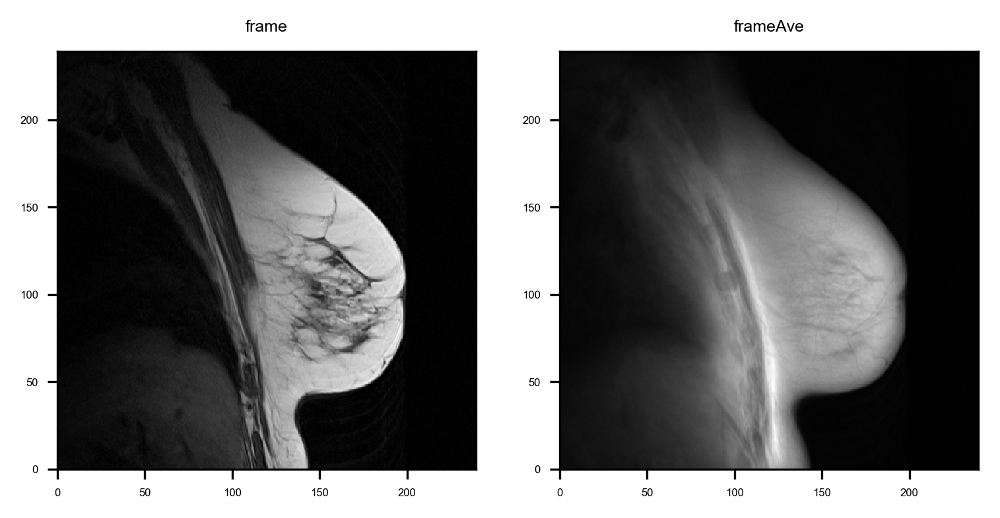

In [240]:
# Work on one slice for now:
f = 11
frame = data[:, :, f]

frameAve = np.average(data, axis=2)

pyplot.figure(dpi=300)

ax = pyplot.subplot(121, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.title('frame', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

    
ax = pyplot.subplot(122, aspect='equal')
pyplot.pcolormesh(x, y, frameAve);
pyplot.title('frameAve', **title_font)
# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

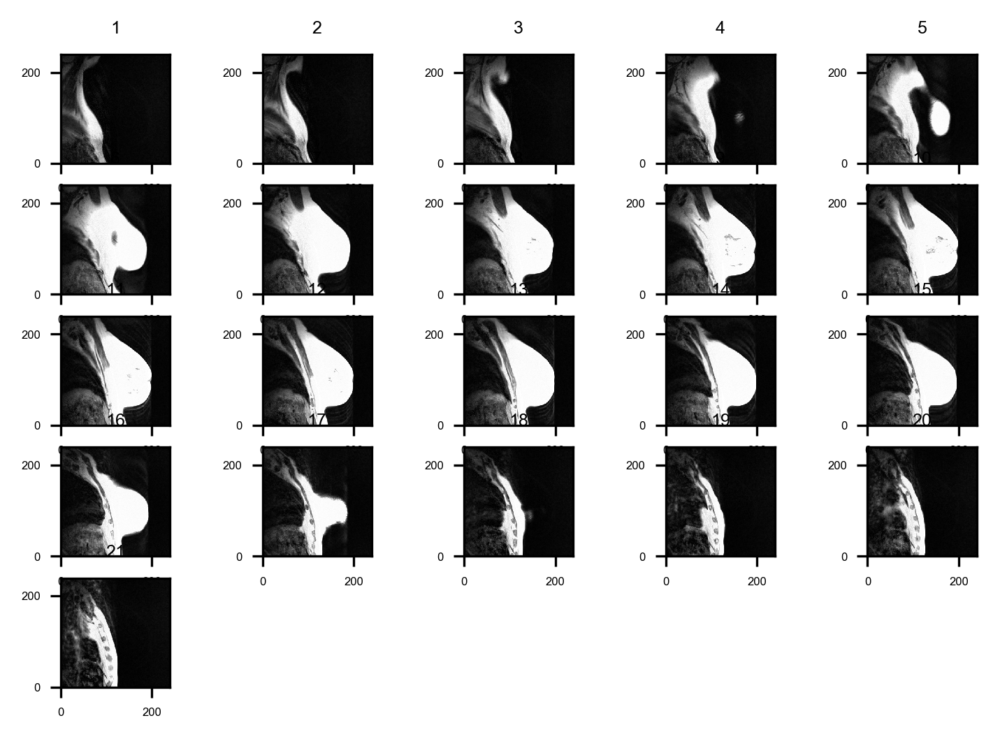

In [266]:


# Subtract the min frame from all *blurred* frames:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

#frameLast = data[:,:,dimZ-1]

blurKernel = 3
blurKernel = 5
#blurKernel = 7
#frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

# Create empty 3D array:
dataDiff = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    #frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameLastBlurred))
    frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameMin))
    
    dataDiff[:,:,f] = frameDiff
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, frameDiff);
    #pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

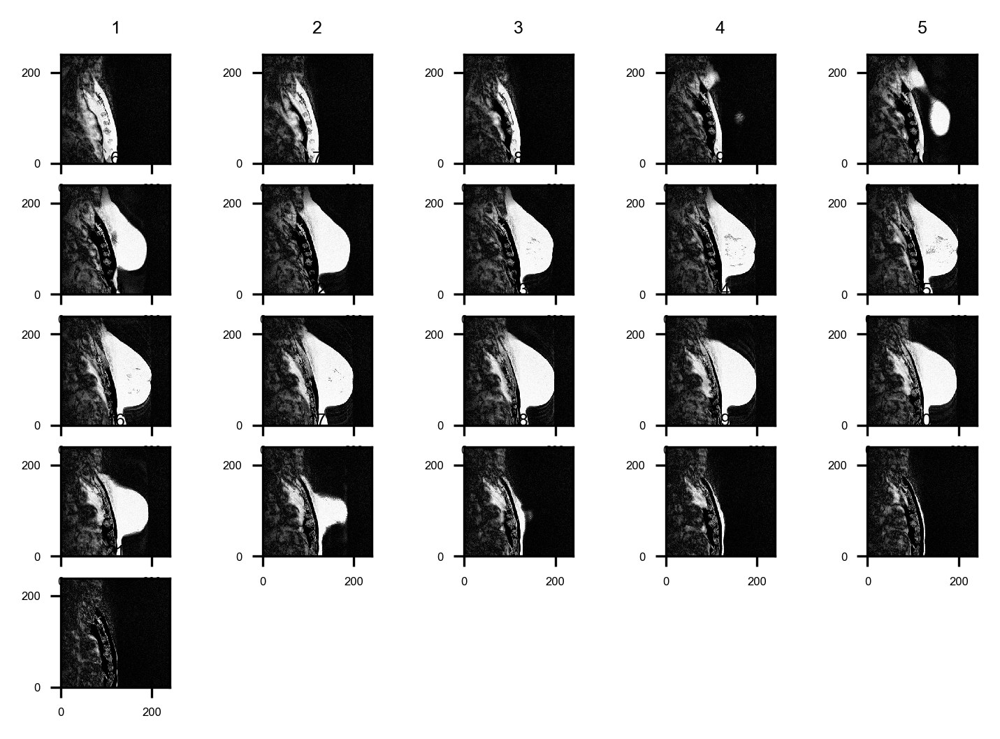

In [91]:
# Subtract the last frame from all frames:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

frameLast = data[:,:,dimZ-1]

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    #frameDiff = - (data[:,:,f] - frameLast)
    frameDiff = cv2.absdiff(cv2.convertScaleAbs(frame), cv2.convertScaleAbs(frameLast))

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, frameDiff);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

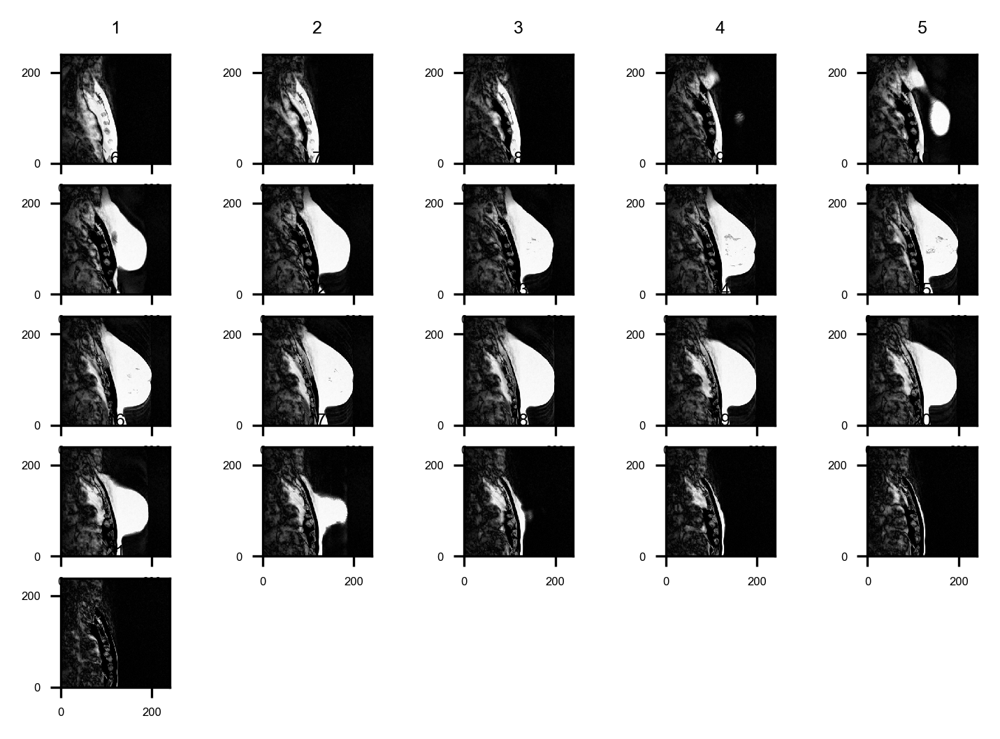

In [103]:
"""
I think this is the best result
"""

# Subtract the *blurred* last frame from all *blurred* frames:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

frameLast = data[:,:,dimZ-1]

blurKernel = 3
blurKernel = 5
#blurKernel = 7
frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

# Create empty 3D array:
dataDiff = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameLastBlurred))
    
    dataDiff[:,:,f] = frameDiff
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, frameDiff);
    #pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

In [110]:
frameDiff.shape
frameDiff.dtype

dtype('uint8')

In [111]:
dataDiff.shape
dataDiff.dtype

dtype('uint8')

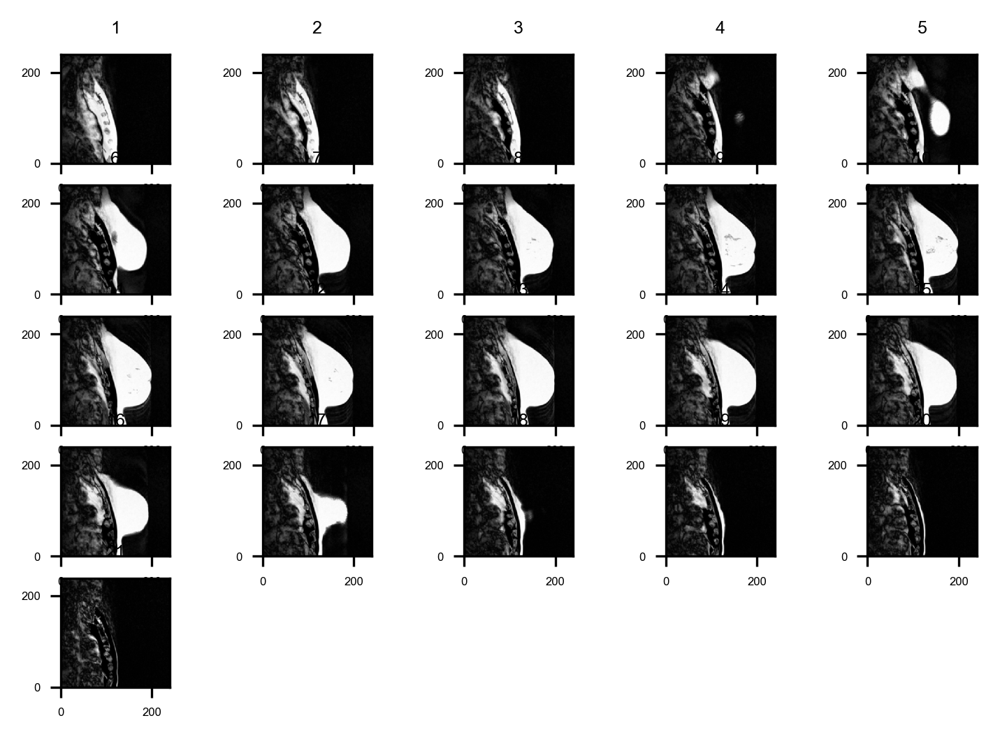

In [88]:
# Subtract the *blurred* last frame from all *blurred* frames, 
# then blur their difference:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

frameLast = data[:,:,dimZ-1]

blurKernel = 5
#blurKernel = 7
frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)


pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameLastBlurred))
    
    frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    #pyplot.pcolormesh(x, y, frameDiff);
    pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

In [83]:
frame.dtype

dtype('float64')

In [84]:
frameLastBlurred.dtype

dtype('uint16')

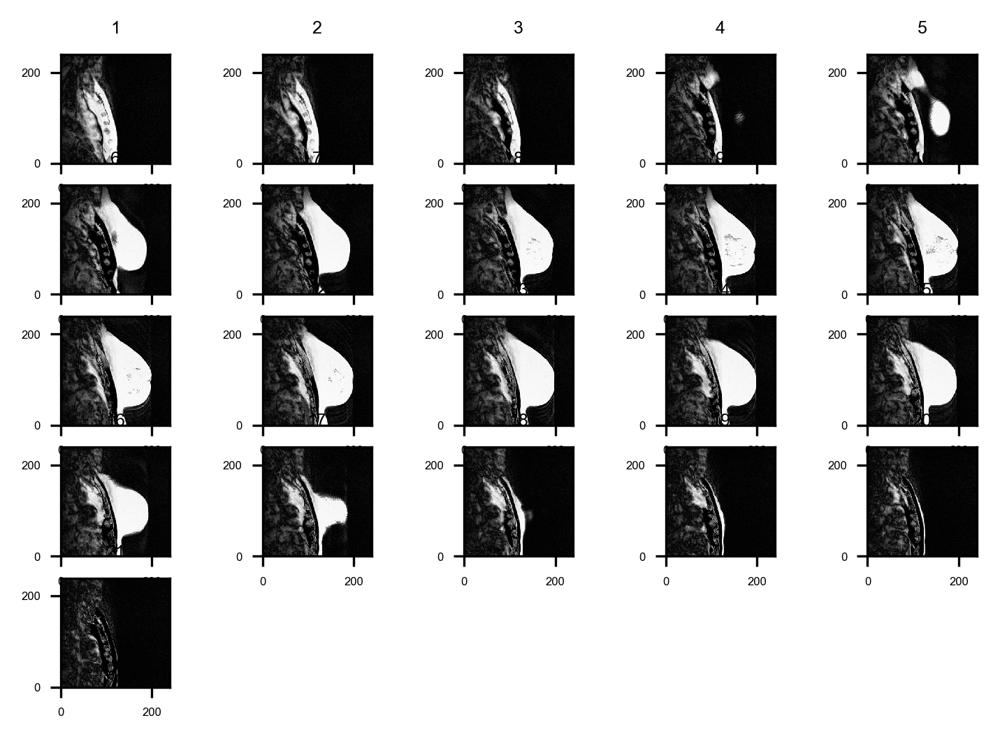

In [85]:
# Subtract the *blurred* last frame from all *un-blurred* frames:
# Result looks similar to subtraction without any blurring.

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

frameLast = data[:,:,dimZ-1]

blurKernel = 5
#blurKernel = 7
frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

# Create empty 3D array:
dataMinusBlurredLast = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    #frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    
    #frameDiff = - (frame - frameLastBlurred)
    frameDiff = cv2.absdiff(cv2.convertScaleAbs(frame), cv2.convertScaleAbs(frameLastBlurred))
    
    dataMinusBlurredLast[:,:,f] = frameDiff
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, frameDiff);
    #pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

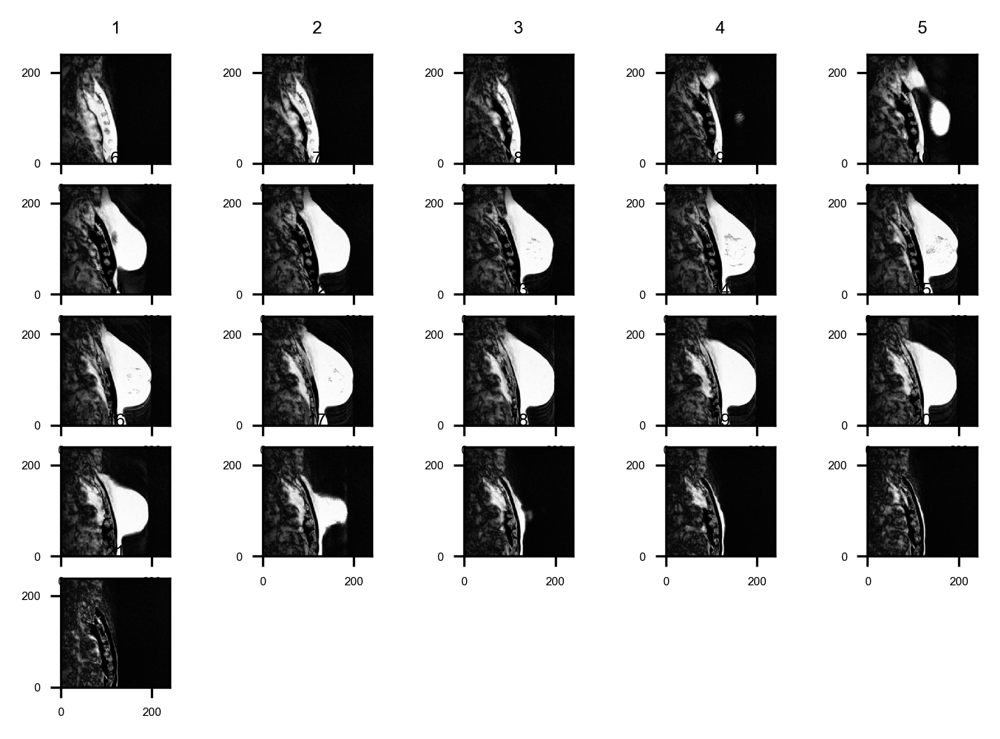

In [142]:
# Subtract the *blurred* last frame from all *un-blurred* frames, then
# blur their difference:
# Other than blurring of speckle, the result looks similar to subtraction 
# without any blurring, or to subtraction with blurring of last frame only.

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

frameLast = data[:,:,dimZ-1]

blurKernel = 5
#blurKernel = 7
frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

# Create empty 3D array:
dataMinusBlurredLastBlurred = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    #frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    
    #frameDiff = - (frame - frameLastBlurred)
    frameDiff = cv2.absdiff(cv2.convertScaleAbs(frame), cv2.convertScaleAbs(frameLastBlurred))
    
    frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    dataMinusBlurredLastBlurred[:,:,f] = frameDiffBlurred
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    #pyplot.pcolormesh(x, y, frameDiff);
    pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

In [51]:
se1 = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))
se2 = cv2.getStructuringElement(cv2.MORPH_RECT, (2,2))
mask = cv2.morphologyEx(frame, cv2.MORPH_CLOSE, se1)
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, se2)

#mask = np.dstack([mask, mask, mask]) / 255
out = frame * mask

#cv2.imshow('Output', out)
#cv2.waitKey(0)
#cv2.destroyAllWindows()
##cv2.imwrite('output.png', out)

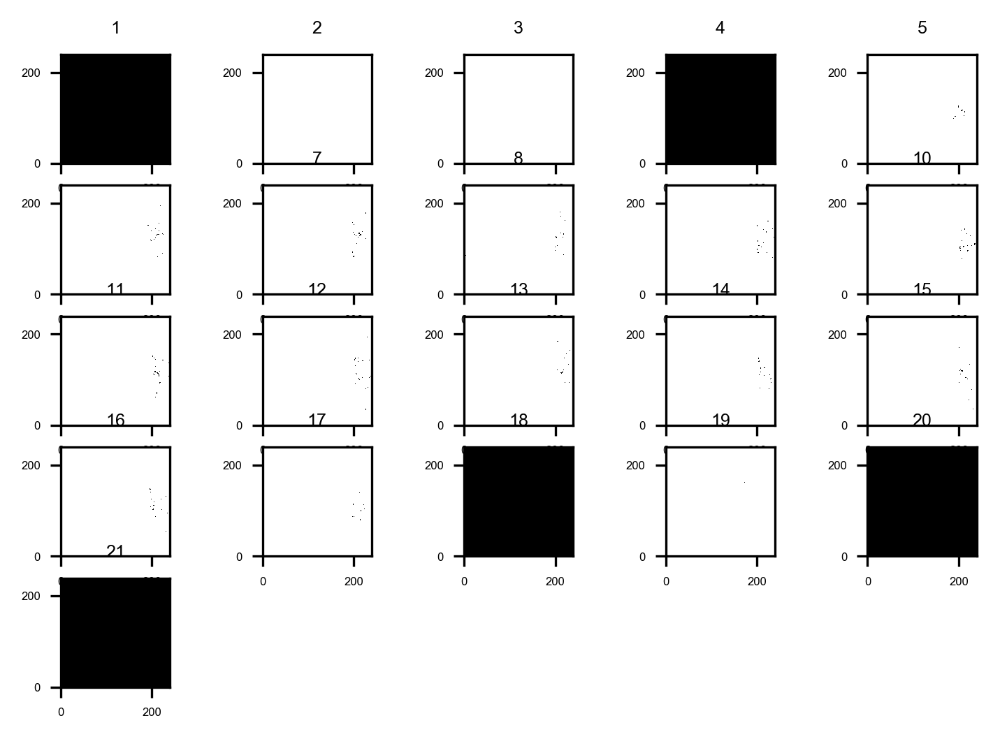

In [62]:
# Use structuring element and closing and dilation to filter speckle:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

frameLast = data[:,:,dimZ-1]

use_blurring = 0
use_blurring = 1

blur_all_frames = 0 # only blur last frame
#blur_all_frames = 1 # blur all frames

blur_difference = 0
#blur_difference = 1

blurKernel = 5
blurKernel = 7

if use_blurring:
    frameLast = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

se1 = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))
se2 = cv2.getStructuringElement(cv2.MORPH_RECT, (2,2))

thresh = 5

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    if use_blurring and blur_all_frames:
        frame = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
        
    frameDiff = - (frame - frameLast)
    
    if blur_difference:
        frameDiff = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBW = 255*(cv2.cvtColor(frameDiff, cv2.COLOR_BGR2GRAY) > 5).astype('uint8')
    frameDiffBW = cv2.threshold(frameDiff, thresh, 255, cv2.THRESH_BINARY)[1]
    
    mask = cv2.morphologyEx(frameDiffBW, cv2.MORPH_CLOSE, se1)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, se2)

    #mask = np.dstack([mask, mask, mask]) / 255
    out = frameDiffBW * mask

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, out);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

In [81]:
dataMinusBlurredLast.dtype

dtype('float64')

In [82]:
dataMinusBlurredLastBlurred.dtype

dtype('float64')

In [93]:
dataDiff.dtype

dtype('uint8')

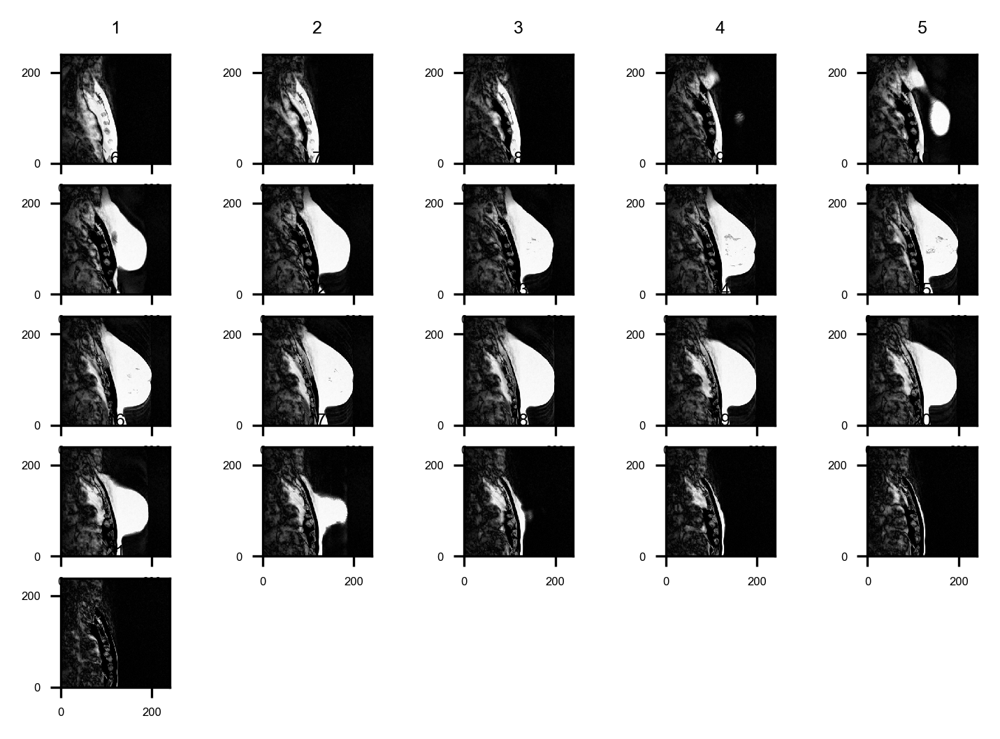

In [103]:
"""
I think this is the best result
"""

# Subtract the *blurred* last frame from all *blurred* frames:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

frameLast = data[:,:,dimZ-1]

blurKernel = 3
blurKernel = 5
#blurKernel = 7
frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

# Create empty 3D array:
dataDiff = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameLastBlurred))
    
    dataDiff[:,:,f] = frameDiff
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, frameDiff);
    #pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

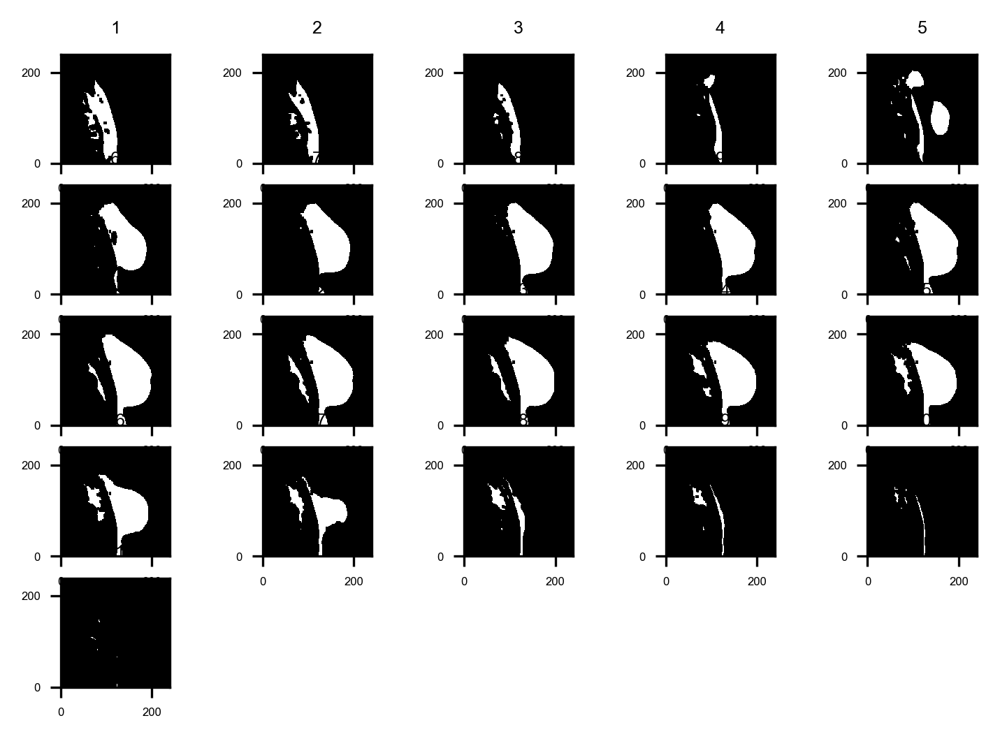

In [134]:
# Working with dataDiff, dilate then erode: 
"""Seems that dilate then erode works slightly better 
than erode then dilate (see below)"""

thresh = 20
thresh = 70
thresh = 90
thresh = 200

Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes

# Create empty 3D array:
dilateThenErode = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = dataDiff[:,:,f]
    #frame = data[:,:,f]
    
    #frameAve = np.average(frame)
    
    # Convert to B&W using thresh:
    out = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]

    # Dilate:
    #diffBWdil = cv2.dilate(diffBW, Kernel5, iterations = 10) # dilate
    #diffBWdil = cv2.dilate(diffBW, Kernel2, iterations = 5) # dilate (holes not closing with kernel2)
    #diffBWdil = cv2.dilate(diffBW, Kernel3, iterations = 5) # dilate (better)
    #out = cv2.dilate(out, Kernel3, iterations = 7) # dilate (seems decent)
    out = cv2.dilate(out, Kernel3, iterations = 3) # dilate (seems decent)

    # Close holes:
    #diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel3) # close holes (seem decent)
    #diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel5) # close holes (a bit better)
    out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) # close holes (seems fine)

    # Erode:
    #diffBWdilCloEro = cv2.erode(diffBWdilClo, Kernel5, iterations = 5) # erode (a bit too much)
    #out = cv2.erode(out, Kernel3, iterations = 5) # erode (seems decent)
    out = cv2.erode(out, Kernel3, iterations = 3) # erode (seems decent)
    
    dilateThenErode[:,:,f] = out
    
    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, out);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

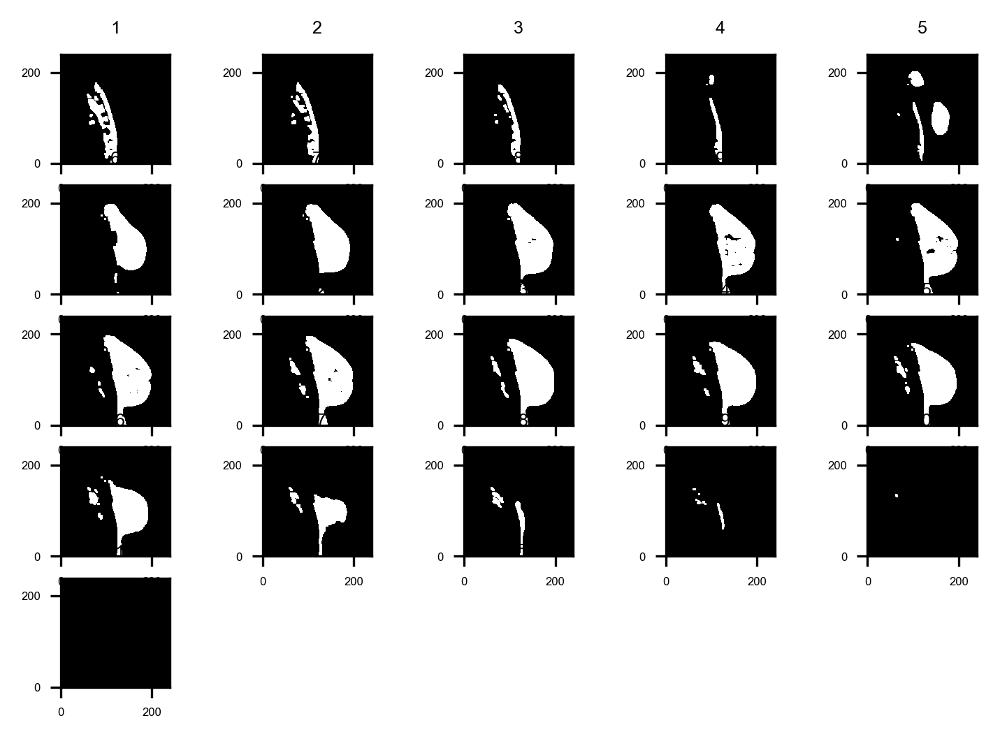

In [135]:
# Working with dataDiff, erode then dilate:
"""Seems that dilate then erode works slightly better (see above)"""

thresh = 20
thresh = 70
thresh = 90
thresh = 200

Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes

# Create empty 3D array:
erodeThenDilate = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = dataDiff[:,:,f]
    #frame = data[:,:,f]
    
    #frameAve = np.average(frame)
    
    # Convert to B&W using thresh:
    out = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]

    # Erode:
    #diffBWdilCloEro = cv2.erode(diffBWdilClo, Kernel5, iterations = 5) # erode (a bit too much)
    #out = cv2.erode(out, Kernel3, iterations = 5) # erode (seems decent)
    out = cv2.erode(out, Kernel3, iterations = 3) # erode (seems decent)
    
    # Close holes:
    #diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel3) # close holes (seem decent)
    #diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel5) # close holes (a bit better)
    out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) # close holes (seems fine)

    # Dilate:
    #diffBWdil = cv2.dilate(diffBW, Kernel5, iterations = 10) # dilate
    #diffBWdil = cv2.dilate(diffBW, Kernel2, iterations = 5) # dilate (holes not closing with kernel2)
    #diffBWdil = cv2.dilate(diffBW, Kernel3, iterations = 5) # dilate (better)
    #out = cv2.dilate(out, Kernel3, iterations = 7) # dilate (seems decent)
    out = cv2.dilate(out, Kernel3, iterations = 3) # dilate (seems decent)

    erodeThenDilate[:,:,f] = out
    
    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, out);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

In [116]:
out.dtype

dtype('uint8')

In [122]:
np.max(data[:,:,11])

945

[ 84 207]
84
207


TypeError: Input must be a 2D array.

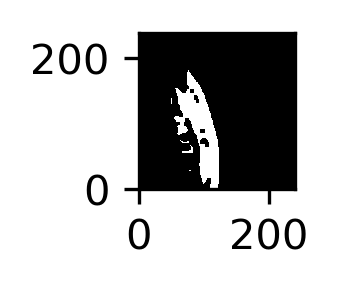

In [238]:
# Working with dataDiff, dilate then erode: 
"""This seems to be the best result"""

thresh = 20
thresh = 70
thresh = 90
thresh = 200

Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes

# Create empty 3D array:
dilateThenErode = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

MinDetArea = 10

contourAreas = []
contourAreasGTMinDetArea = []
contoursGTMinDetArea = []
#dict_contours = {}

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = dataDiff[:,:,f]
    #frame = data[:,:,f]
    
    #frameAve = np.average(frame)
    
    # Convert to B&W using thresh:
    out = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]

    # Dilate:
    #diffBWdil = cv2.dilate(diffBW, Kernel5, iterations = 10) # dilate
    #diffBWdil = cv2.dilate(diffBW, Kernel2, iterations = 5) # dilate (holes not closing with kernel2)
    #diffBWdil = cv2.dilate(diffBW, Kernel3, iterations = 5) # dilate (better)
    #out = cv2.dilate(out, Kernel3, iterations = 7) # dilate (seems decent)
    out = cv2.dilate(out, Kernel3, iterations = 3) # dilate (seems decent)

    # Close holes:
    #diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel3) # close holes (seem decent)
    #diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel5) # close holes (a bit better)
    out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) # close holes (seems fine)

    # Erode:
    #diffBWdilCloEro = cv2.erode(diffBWdilClo, Kernel5, iterations = 5) # erode (a bit too much)
    #out = cv2.erode(out, Kernel3, iterations = 5) # erode (seems decent)
    out = cv2.erode(out, Kernel3, iterations = 3) # erode (seems decent)
    
    dilateThenErode[:,:,f] = out
    
    
        
    # Find contours on the dilated thresholded image:
    contours = cv2.findContours(out.copy(), cv2.RETR_EXTERNAL,
                               cv2.CHAIN_APPROX_SIMPLE)
    contours = imutils.grab_contours(contours)
    
    #dict_contours.update({'Contours in frame {}'.format(f):contours})


    # Loop over the contours:
    #contourAreaMax = 0
    #contours_MinDetArea = [] # all contours > MinDetArea
    #contours_MinDetArea_Area = [] # area of all contours in contours_MinDetArea
    
    contourAreas_thisFrame = []
    contourAreasGTMinDetArea_thisFrame = []
    
    contoursGTMinDetArea_thisFrame = []

    for i in range(len(contours)):
        contour = contours[i] # this contour

        contourArea = round(cv2.contourArea(contour)) # contour area
        contourAreas_thisFrame.append(contourArea)       

        if contourArea < MinDetArea:
            #print('frame ', str(f), ', has contourArea < MinDetArea...\n')

            #history.append([frame_no, cat_detected])

            #areaText = 'N/A'
            continue

        # For all contours > MinDetArea:

        #contours_MinDetArea.append(contour)
        #contours_MinDetArea_Area.append(contourArea)
        contourAreasGTMinDetArea_thisFrame.append(contourArea) 
        
        #contoursGTMinDetArea_thisFrame.append(contour)
        contoursGTMinDetArea_thisFrame.extend(contour)

        # Compute the bounding box for the contour and draw it on the frame:
        (boxX, boxY, boxW, boxH) = cv2.boundingRect(contour)
        cv2.rectangle(out, (boxX, boxY), (boxX + boxW, boxY + boxH), (0, 255, 0), 2)
        #cv2.rectangle(diffBWdilCloEro, (x, y), (x + w, y + h), (255, 255, 255), 2)
        areaText = str(contourArea)

    contourAreas.append(contourAreas_thisFrame)
    contourAreasGTMinDetArea.append(contourAreasGTMinDetArea_thisFrame)
    
    contoursGTMinDetArea.append(contoursGTMinDetArea_thisFrame)
    
    #dict_contours.update({'Contour areas for frame {}'.format(f):contourAreas})
    
    areaText = areaText + 'Contour area = {} pix\n'.format(contourArea) 
    
    if 0:
        r = []
        c = []

        for i in range(len(contoursGTMinDetArea_thisFrame)):
            for j in range(len(contoursGTMinDetArea_thisFrame[i])):
                r_ij = contoursGTMinDetArea_thisFrame[i][0][0][0]
                c_ij = contoursGTMinDetArea_thisFrame[i][0][0][1]

                r.append(r_ij)
                c.append(c_ij)
    
    
            
        
    
    
    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, out);
    #for contour in contoursGTMinDetArea_thisFrame:
    #    pyplot.contour(contour);
    #pyplot.contour([r, c]);
    for contour in contoursGTMinDetArea_thisFrame:
        print(contour[0])
        print(contour[0][0])
        print(contour[0][1])
        pyplot.contour([contour[0][0], contour[0][1]])
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

In [227]:
contoursGTMinDetArea_thisFrame

[array([[137, 228]], dtype=int32),
 array([[136, 229]], dtype=int32),
 array([[136, 230]], dtype=int32),
 array([[135, 231]], dtype=int32),
 array([[135, 232]], dtype=int32),
 array([[133, 234]], dtype=int32),
 array([[134, 235]], dtype=int32),
 array([[134, 236]], dtype=int32),
 array([[135, 237]], dtype=int32),
 array([[136, 236]], dtype=int32),
 array([[136, 234]], dtype=int32),
 array([[137, 233]], dtype=int32),
 array([[112, 173]], dtype=int32),
 array([[111, 174]], dtype=int32),
 array([[111, 175]], dtype=int32),
 array([[110, 176]], dtype=int32),
 array([[108, 176]], dtype=int32),
 array([[107, 177]], dtype=int32),
 array([[110, 177]], dtype=int32),
 array([[111, 176]], dtype=int32),
 array([[112, 176]], dtype=int32),
 array([[113, 175]], dtype=int32),
 array([[114, 175]], dtype=int32),
 array([[115, 174]], dtype=int32),
 array([[115, 173]], dtype=int32)]

In [228]:
len(contoursGTMinDetArea_thisFrame)

25

In [229]:
contoursGTMinDetArea_thisFrame[0]

array([[137, 228]], dtype=int32)

In [230]:
contoursGTMinDetArea_thisFrame[0][0]

array([137, 228], dtype=int32)

In [231]:
contoursGTMinDetArea_thisFrame[1][0]

array([136, 229], dtype=int32)

In [150]:
contourAreas

[[8, 55, 63, 216, 12, 13845],
 [1, 620, 29, 139, 9909],
 [130, 144, 0, 38, 7284],
 [4, 1020, 0, 20, 44, 3632],
 [32, 0, 42, 2658, 0, 20, 20, 111, 5801, 64, 2988],
 [6, 0, 20, 0, 0, 4, 8, 20270, 384, 102],
 [2, 0, 20, 0, 23917, 355],
 [4, 0, 20, 0, 26384],
 [0, 19, 0, 27218],
 [0, 6, 0, 128, 0, 160, 28223],
 [11, 1258, 28612],
 [0, 0, 4, 0, 2288, 28530],
 [2, 0, 1966, 27370],
 [4, 8, 20, 1769, 0, 2, 492, 25939],
 [0, 8, 7, 0, 2930, 23754],
 [0, 10, 2148, 539, 0, 19604],
 [1, 0, 2436, 2, 11374],
 [2, 0, 4, 8, 0, 2, 24, 2148, 0, 16, 2798],
 [2, 0, 1464, 31, 1387],
 [0, 0, 0, 0, 16, 236, 55, 8, 541],
 [16, 12, 6, 4, 0, 0, 0, 0, 3]]

In [152]:
MinDetArea

10

In [151]:
contourAreasGTMinDetArea

[[55, 63, 216, 12, 13845],
 [620, 29, 139, 9909],
 [130, 144, 38, 7284],
 [1020, 20, 44, 3632],
 [32, 42, 2658, 20, 20, 111, 5801, 64, 2988],
 [20, 20270, 384, 102],
 [20, 23917, 355],
 [20, 26384],
 [19, 27218],
 [128, 160, 28223],
 [11, 1258, 28612],
 [2288, 28530],
 [1966, 27370],
 [20, 1769, 492, 25939],
 [2930, 23754],
 [10, 2148, 539, 19604],
 [2436, 11374],
 [24, 2148, 16, 2798],
 [1464, 31, 1387],
 [16, 236, 55, 541],
 [16, 12]]

In [158]:
contours

[array([[[137, 228]],
 
        [[136, 229]],
 
        [[136, 230]],
 
        [[135, 231]],
 
        [[135, 232]],
 
        [[133, 234]],
 
        [[134, 235]],
 
        [[134, 236]],
 
        [[135, 237]],
 
        [[136, 236]],
 
        [[136, 234]],
 
        [[137, 233]]], dtype=int32), array([[[112, 173]],
 
        [[111, 174]],
 
        [[111, 175]],
 
        [[110, 176]],
 
        [[108, 176]],
 
        [[107, 177]],
 
        [[110, 177]],
 
        [[111, 176]],
 
        [[112, 176]],
 
        [[113, 175]],
 
        [[114, 175]],
 
        [[115, 174]],
 
        [[115, 173]]], dtype=int32), array([[[123, 167]],
 
        [[122, 168]],
 
        [[121, 168]],
 
        [[118, 171]],
 
        [[120, 171]],
 
        [[123, 168]]], dtype=int32), array([[[132, 128]],
 
        [[130, 130]],
 
        [[130, 134]],
 
        [[131, 133]],
 
        [[131, 129]]], dtype=int32), array([[[198, 106]],
 
        [[198, 108]]], dtype=int32), array([[[199,  95]],
 
    

In [167]:
contoursGTMinDetArea_thisFrame

[array([[[ 84, 207]],
 
        [[ 84, 208]],
 
        [[ 81, 211]],
 
        [[ 80, 211]],
 
        [[ 79, 212]],
 
        [[ 79, 213]],
 
        [[ 78, 214]],
 
        [[ 78, 216]],
 
        [[ 79, 216]],
 
        [[ 80, 217]],
 
        [[ 80, 223]],
 
        [[ 82, 223]],
 
        [[ 82, 216]],
 
        [[ 83, 215]],
 
        [[ 84, 215]],
 
        [[ 84, 214]],
 
        [[ 86, 212]],
 
        [[ 86, 208]],
 
        [[ 85, 208]]], dtype=int32), array([[[108, 112]],
 
        [[107, 113]],
 
        [[107, 114]],
 
        [[106, 115]],
 
        [[106, 117]],
 
        [[104, 119]],
 
        [[103, 119]],
 
        [[103, 120]],
 
        [[102, 121]],
 
        [[103, 122]],
 
        [[104, 121]],
 
        [[104, 120]],
 
        [[107, 117]],
 
        [[109, 117]],
 
        [[111, 115]],
 
        [[119, 115]],
 
        [[120, 116]],
 
        [[120, 117]],
 
        [[121, 118]],
 
        [[122, 118]],
 
        [[123, 117]],
 
        [[123, 115]],
 
    

In [161]:
boxX

85

In [162]:
boxY

0

In [163]:
boxW

114

In [164]:
boxH

293

In [285]:
frameMin = np.min(data, axis=2)
frameMax = np.max(data, axis=2)
frameAve = np.average(data, axis=2)
frameStd = np.std(data, axis=2)

print('frameMin is ', frameMin.dtype)
print('frameMax is ', frameMax.dtype)
print('frameAve is ', frameAve.dtype)
print('frameStd is ', frameStd.dtype)

if 0:
    print('min(frameMin) = ', str(min(frameMin.all())))
    print('max(frameMax) = ', str(max(frameMax.all())))
    print('min(frameStd) = ', str(min(frameStd[:])))
    print('max(frameStd) = ', str(max(frameStd[:,:])))

frameMin is  uint16
frameMax is  uint16
frameAve is  float64
frameStd is  float64


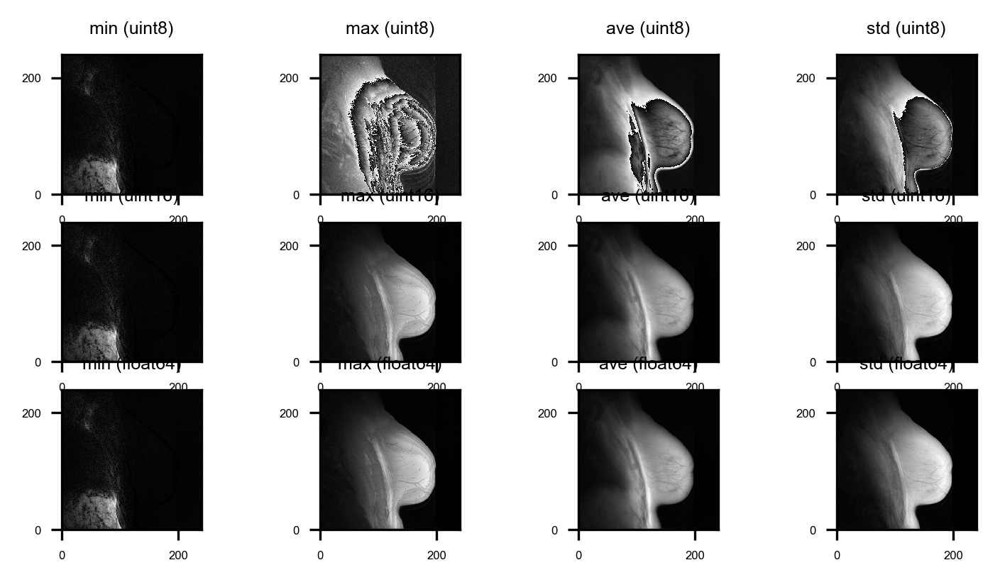

In [291]:
thresh = 20
#thresh = 40
#thresh = 30
thresh = 25

frameMin = np.min(data, axis=2)
frameMax = np.max(data, axis=2)
frameAve = np.average(data, axis=2)
frameStd = np.std(data, axis=2)
if 0:
    frameMin = 255 - np.min(data, axis=2)
    frameMax = 255 - np.max(data, axis=2)
    frameAve = 255 - np.average(data, axis=2)
    frameStd = 255 - np.std(data, axis=2)


pyplot.figure(dpi=300)

ax = pyplot.subplot(3,4,1, aspect='equal')
pyplot.pcolormesh(x, y, frameMin);
pyplot.title('min (' + str(frameMin.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(3,4,2, aspect='equal')
pyplot.pcolormesh(x, y, frameMax);
pyplot.title('max (' + str(frameMax.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(3,4,3, aspect='equal')
pyplot.pcolormesh(x, y, frameAve);
pyplot.title('ave (' + str(frameAve.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(3,4,4, aspect='equal')
pyplot.pcolormesh(x, y, frameStd);
pyplot.title('std (' + str(frameStd.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

thresh = 200
thresh = 100
thresh = 10
thresh = 5

# Convert to B&W using thresh:
#out = cv2.threshold(frameMin, thresh, 255, cv2.THRESH_BINARY)[1]
out = np.uint8(frameMin)

ax = pyplot.subplot(4,4,5, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('min BW', **title_font)
pyplot.title('min (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

# Convert to B&W using thresh:
#out = cv2.threshold(frameMax, thresh, 255, cv2.THRESH_BINARY)[1]
out = np.uint8(frameMax)

ax = pyplot.subplot(4,4,6, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('max BW', **title_font)
pyplot.title('max (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
# Convert to B&W using thresh:
#out = cv2.threshold(frameAve, thresh, 255, cv2.THRESH_BINARY)[1]
out = np.uint8(frameAve)

ax = pyplot.subplot(4,4,7, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('ave BW', **title_font)
pyplot.title('ave (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
# Convert to B&W using thresh:
#out = cv2.threshold(frameStd, thresh, 255, cv2.THRESH_BINARY)[1]
out = np.uint8(frameStd)

ax = pyplot.subplot(4,4,8, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('std BW', **title_font)
pyplot.title('std (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)


out = np.uint16(frameMin)

ax = pyplot.subplot(4,4,9, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('min BW', **title_font)
pyplot.title('min (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

out = np.uint16(frameMax)

ax = pyplot.subplot(4,4,10, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('max BW', **title_font)
pyplot.title('max (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
out = np.uint16(frameAve)

ax = pyplot.subplot(4,4,11, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('ave BW', **title_font)
pyplot.title('ave (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
out = np.uint16(frameStd)

ax = pyplot.subplot(4,4,12, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('std BW', **title_font)
pyplot.title('std (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
    
    
out = np.float64(frameMin)

ax = pyplot.subplot(4,4,13, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('min BW', **title_font)
pyplot.title('min (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

out = np.float64(frameMax)

ax = pyplot.subplot(4,4,14, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('max BW', **title_font)
pyplot.title('max (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
out = np.float64(frameAve)

ax = pyplot.subplot(4,4,15, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('ave BW', **title_font)
pyplot.title('ave (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
out = np.float64(frameStd)

ax = pyplot.subplot(4,4,16, aspect='equal')
pyplot.pcolormesh(x, y, out);
#pyplot.title('std BW', **title_font)
pyplot.title('std (' + str(out.dtype) + ')', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

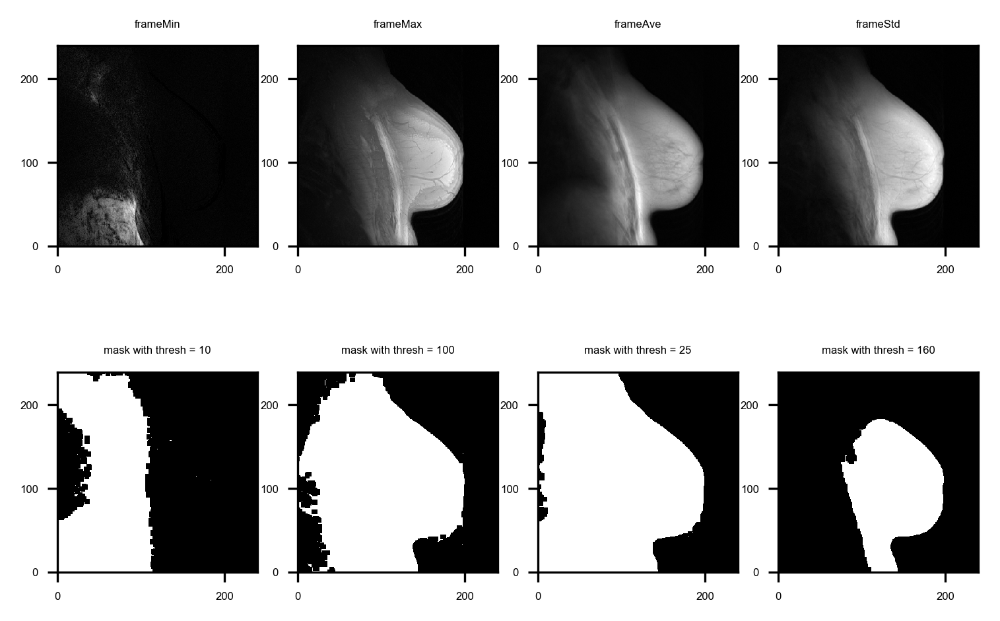

In [427]:
thresh = 20
#thresh = 40
#thresh = 30
thresh = 25 # for ave
#thresh = 100



frameAve = np.average(data, axis=2)
frameMax = np.max(data, axis=2)
frameMin = np.min(data, axis=2)
frameStd = np.std(data, axis=2)

threshMin = 10
threshMax = 100
threshAve = 25
threshStd = 80 # ok but ribs present
threshStd = 160

threshs = [threshMin, threshMax, threshAve, threshStd]

frameIn = [frameMin, frameMax, frameAve, frameStd]

frameIn_txt = ['frameMin', 'frameMax', 'frameAve', 'frameStd']

frameOut = []

#frameOut_txt = []
#frameOut_txt = frameIn_txt + ' mask'

frameOut_txt = ['mask with thresh = {}'.format(t) for t in threshs]



pyplot.figure(dpi=300)

for i in range(len(frameIn)):
    frame = frameIn[i]
    
    thresh = threshs[i]
    
    ax = pyplot.subplot(2,4,i+1, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title(frameIn_txt[i], **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    # Convert to B&W using thresh:
    out = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]

    # Dilate:
    #diffBWdil = cv2.dilate(diffBW, Kernel5, iterations = 10) # dilate
    #diffBWdil = cv2.dilate(diffBW, Kernel2, iterations = 5) # dilate (holes not closing with kernel2)
    #diffBWdil = cv2.dilate(diffBW, Kernel3, iterations = 5) # dilate (better)
    #out = cv2.dilate(out, Kernel3, iterations = 7) # dilate (seems decent)
    out = cv2.dilate(out, Kernel3, iterations = 3) # dilate (seems decent)

    # Close holes:
    #diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel3) # close holes (seem decent)
    #diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel5) # close holes (a bit better)
    out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) # close holes (seems fine)

    # Erode:
    #diffBWdilCloEro = cv2.erode(diffBWdilClo, Kernel5, iterations = 5) # erode (a bit too much)
    #out = cv2.erode(out, Kernel3, iterations = 5) # erode (seems decent)
    out = cv2.erode(out, Kernel3, iterations = 3) # erode (seems decent)
    
    frameOut.append(out)
    
    ax = pyplot.subplot(2,4,i+5, aspect='equal')
    pyplot.pcolormesh(x, y, out);
    pyplot.title(frameOut_txt[i], **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)


In [383]:
mask = frameOut[0]

mask

array([[255, 255, 255, ...,   0,   0,   0],
       [255, 255, 255, ...,   0,   0,   0],
       [255, 255, 255, ...,   0,   0,   0],
       ...,
       [255, 255, 255, ...,   0,   0,   0],
       [255, 255, 255, ...,   0,   0,   0],
       [255, 255, 255, ...,   0,   0,   0]], dtype=uint16)

In [391]:
maskNot = np.logical_not(mask)
maskNot

array([[False, False, False, ...,  True,  True,  True],
       [False, False, False, ...,  True,  True,  True],
       [False, False, False, ...,  True,  True,  True],
       ...,
       [False, False, False, ...,  True,  True,  True],
       [False, False, False, ...,  True,  True,  True],
       [False, False, False, ...,  True,  True,  True]])

In [393]:
frame

array([[39, 42, 40, ...,  5, 21, 25],
       [39, 37, 27, ...,  7, 13, 12],
       [30, 36, 29, ...,  2,  9, 18],
       ...,
       [17, 11, 11, ...,  9, 11,  8],
       [12, 13, 17, ..., 10,  7, 13],
       [ 8, 15, 24, ...,  7, 15, 11]], dtype=uint16)

In [392]:
frame*maskNot

array([[ 0,  0,  0, ...,  5, 21, 25],
       [ 0,  0,  0, ...,  7, 13, 12],
       [ 0,  0,  0, ...,  2,  9, 18],
       ...,
       [ 0,  0,  0, ...,  9, 11,  8],
       [ 0,  0,  0, ..., 10,  7, 13],
       [ 0,  0,  0, ...,  7, 15, 11]], dtype=uint16)

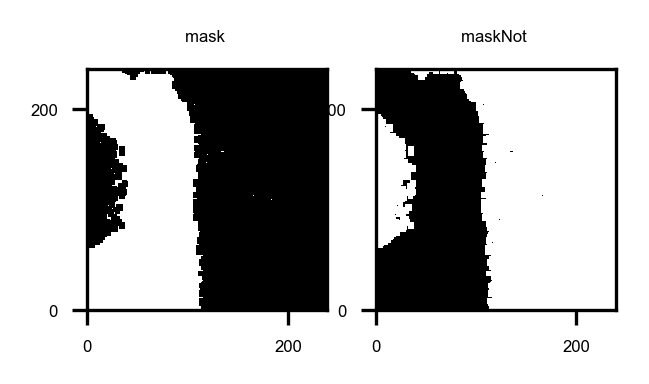

In [420]:
mask = frameOut[0]
maskNot = np.logical_not(mask) # take logical not

pyplot.figure(dpi=300)

ax = pyplot.subplot(3,5,1, aspect='equal')
pyplot.pcolormesh(x, y, mask);
pyplot.title('mask ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

ax = pyplot.subplot(3,5,2, aspect='equal')
pyplot.pcolormesh(x, y, maskNot);
pyplot.title('maskNot ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

In [400]:
dimZ

22

In [402]:
int(dimZ/2)

11

In [404]:
for f in range(int(dimZ/2)):
    #print(str(2*f+1) + str(2*i+2))
    print(str(2*f+1))
    print(str(2*f+2))

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22


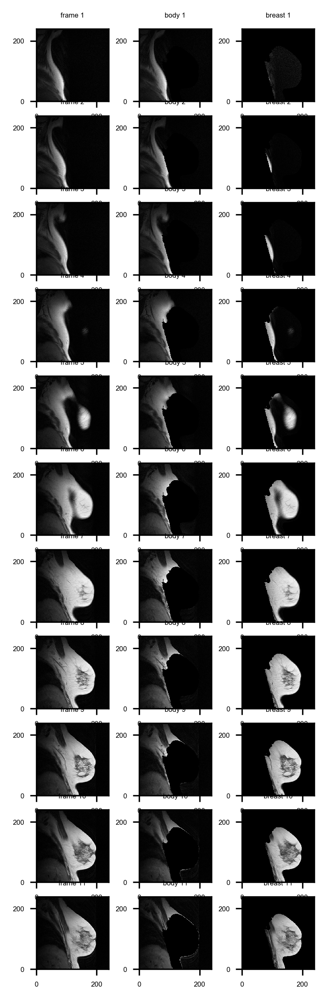

In [428]:

# Try different masks from above:

#mask = frameOut[0] # = frameMin
mask = frameOut[3] # = frameStd

maskNot = np.logical_not(mask) # take logical not

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot pos

for f in range(int(dimZ/2)):
    frame = data[:,:,f]
    
    i = i + 1
    
    ax = pyplot.subplot(dimZ,3,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    body = frame*maskNot
    
    i = i + 1
    
    ax = pyplot.subplot(dimZ,3,i, aspect='equal')
    pyplot.pcolormesh(x, y, body);
    pyplot.title('body ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
        
    breast = frame*mask
    
    i = i + 1
    
    ax = pyplot.subplot(dimZ,3,i, aspect='equal')
    pyplot.pcolormesh(x, y, breast);
    pyplot.title('breast ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    

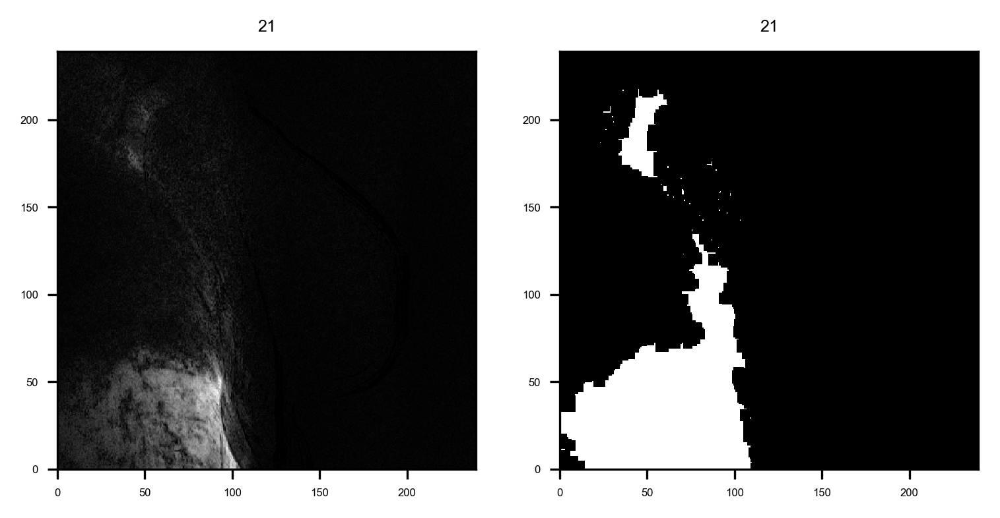

In [254]:
thresh = 20
#thresh = 40
#thresh = 30
thresh = 25


frameAve = np.average(data, axis=2)

frameMin = np.min(data, axis=2)

# Convert to B&W using thresh:
#out = cv2.threshold(frameAve, thresh, 255, cv2.THRESH_BINARY)[1]
out = cv2.threshold(frameMin, thresh, 255, cv2.THRESH_BINARY)[1]

# Dilate:
#diffBWdil = cv2.dilate(diffBW, Kernel5, iterations = 10) # dilate
#diffBWdil = cv2.dilate(diffBW, Kernel2, iterations = 5) # dilate (holes not closing with kernel2)
#diffBWdil = cv2.dilate(diffBW, Kernel3, iterations = 5) # dilate (better)
#out = cv2.dilate(out, Kernel3, iterations = 7) # dilate (seems decent)
out = cv2.dilate(out, Kernel3, iterations = 3) # dilate (seems decent)

# Close holes:
#diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel3) # close holes (seem decent)
#diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel5) # close holes (a bit better)
out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) # close holes (seems fine)

# Erode:
#diffBWdilCloEro = cv2.erode(diffBWdilClo, Kernel5, iterations = 5) # erode (a bit too much)
#out = cv2.erode(out, Kernel3, iterations = 5) # erode (seems decent)
out = cv2.erode(out, Kernel3, iterations = 3) # erode (seems decent)

pyplot.figure(dpi=300)

ax = pyplot.subplot(1,2,1, aspect='equal')
pyplot.pcolormesh(x, y, frameMin);
pyplot.title(str(1+f), **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(1,2,2, aspect='equal')
pyplot.pcolormesh(x, y, out);
pyplot.title(str(1+f), **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

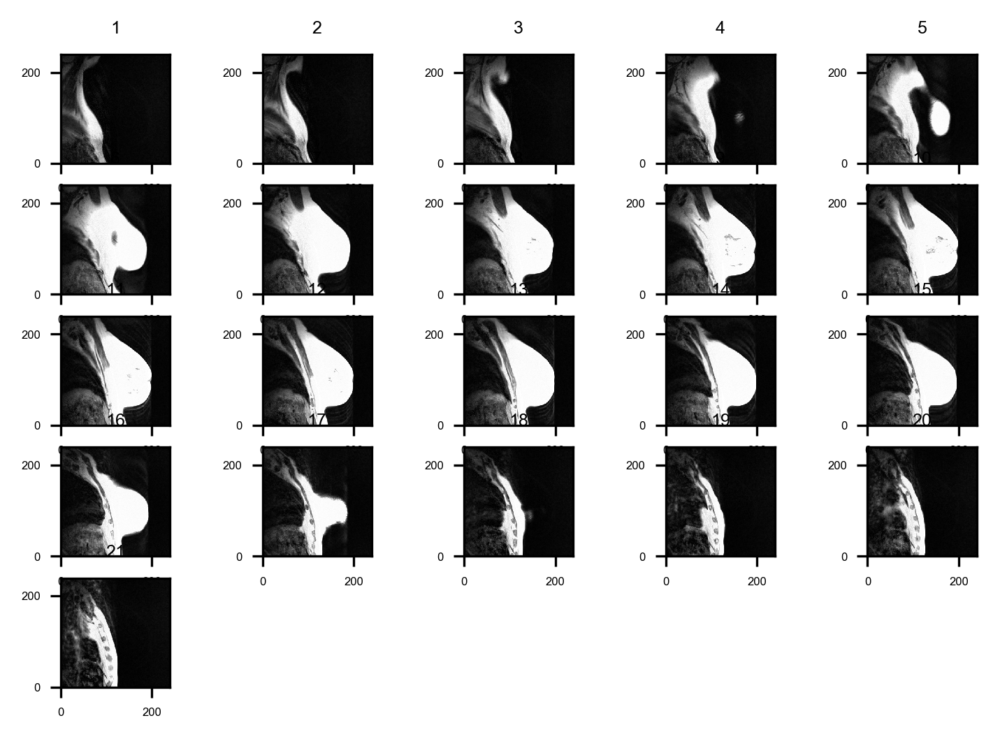

In [265]:


# Subtract the min frame from all *blurred* frames:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

#frameLast = data[:,:,dimZ-1]

blurKernel = 3
blurKernel = 5
#blurKernel = 7
#frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

# Create empty 3D array:
dataDiff = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    #frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameLastBlurred))
    frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameMin))
    
    dataDiff[:,:,f] = frameDiff
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, frameDiff);
    #pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

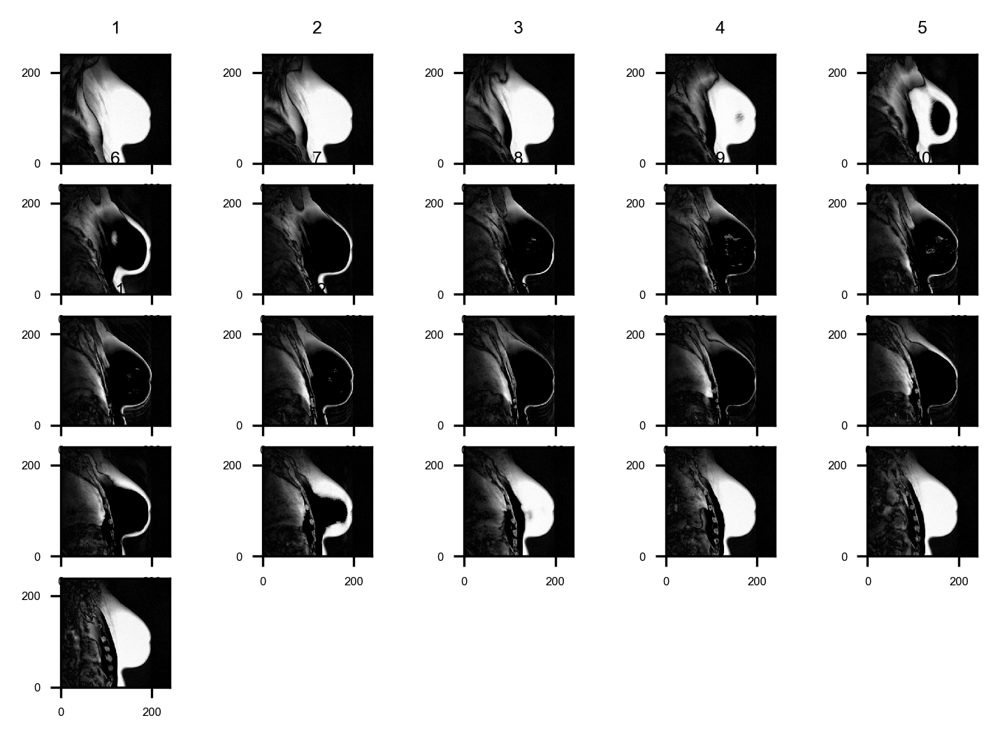

In [253]:


# Subtract the average frame from all *blurred* frames:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

#frameLast = data[:,:,dimZ-1]

blurKernel = 3
blurKernel = 5
#blurKernel = 7
#frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

# Create empty 3D array:
dataDiff = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    #frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameLastBlurred))
    frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameAve))
    
    dataDiff[:,:,f] = frameDiff
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, frameDiff);
    #pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

In [ ]:
frame_uint8 = np.uint8(frame)
sobelXY

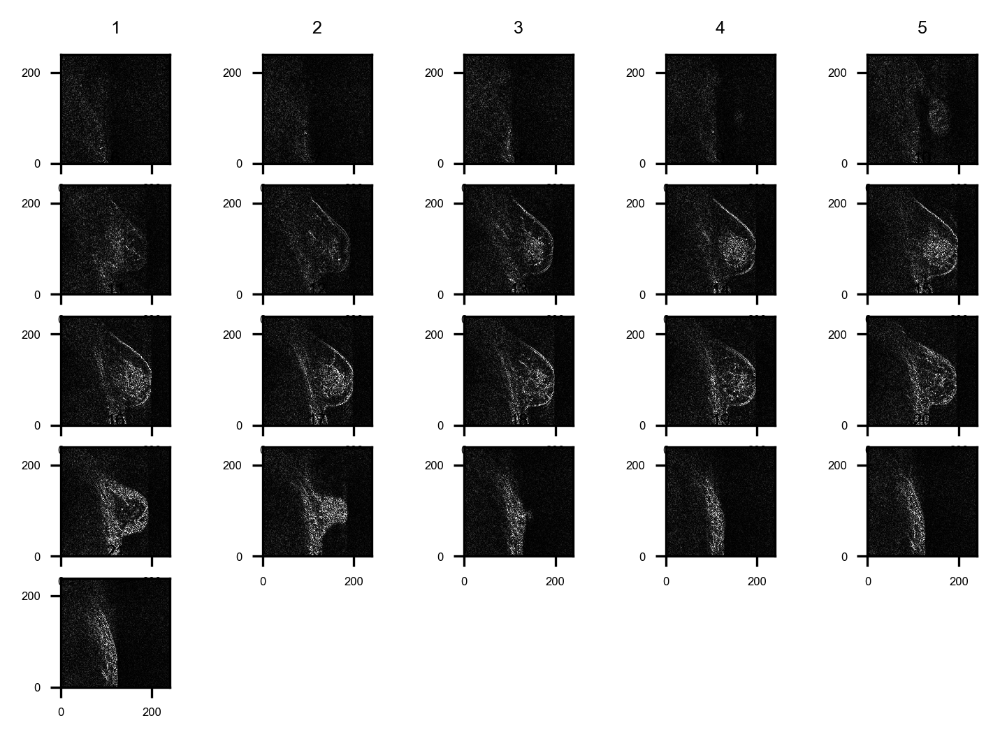

In [255]:
# Use sobelXY

# Subtract the *blurred* last frame from all *blurred* frames:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

#frameLast = data[:,:,dimZ-1]

#blurKernel = 3
#blurKernel = 5
#blurKernel = 7
#frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

# Create empty 3D array:
#dataDiff = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    #sobelX = cv2.Sobel(frame, cv2.CV_64F, 1, 0)
    #sobelY = cv2.Sobel(frame, cv2.CV_64F, 0, 1)
    sobelXY = cv2.Sobel(frame, cv2.CV_64F, 1, 1)

    #sobelX = np.uint8(np.absolute(sobelX))
    #sobelY = np.uint8(np.absolute(sobelY))
    sobelXY = np.uint8(np.absolute(sobelXY))
    
    #frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    #frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameLastBlurred))
    
    #dataDiff[:,:,f] = frameDiff
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, sobelXY);
    #pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

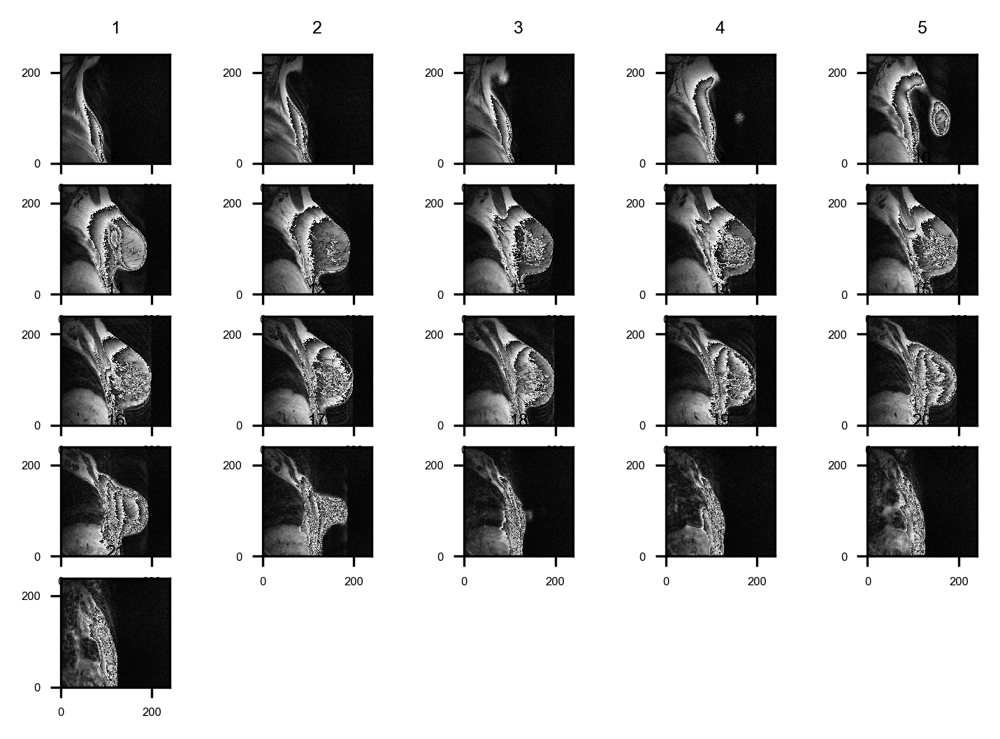

In [293]:
# Use frameUint8

# Subtract the *blurred* last frame from all *blurred* frames:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

#frameLast = data[:,:,dimZ-1]

#blurKernel = 3
#blurKernel = 5
#blurKernel = 7
#frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

# Create empty 3D array:
#dataDiff = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    frameUint8 = np.uint8(frame)
    
    #sobelX = cv2.Sobel(frame, cv2.CV_64F, 1, 0)
    #sobelY = cv2.Sobel(frame, cv2.CV_64F, 0, 1)
    #sobelXY = cv2.Sobel(frame, cv2.CV_64F, 1, 1)

    #sobelX = np.uint8(np.absolute(sobelX))
    #sobelY = np.uint8(np.absolute(sobelY))
    #sobelXY = np.uint8(np.absolute(sobelXY))
    
    #frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    #frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameLastBlurred))
    
    #dataDiff[:,:,f] = frameDiff
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, frameUint8);
    #pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

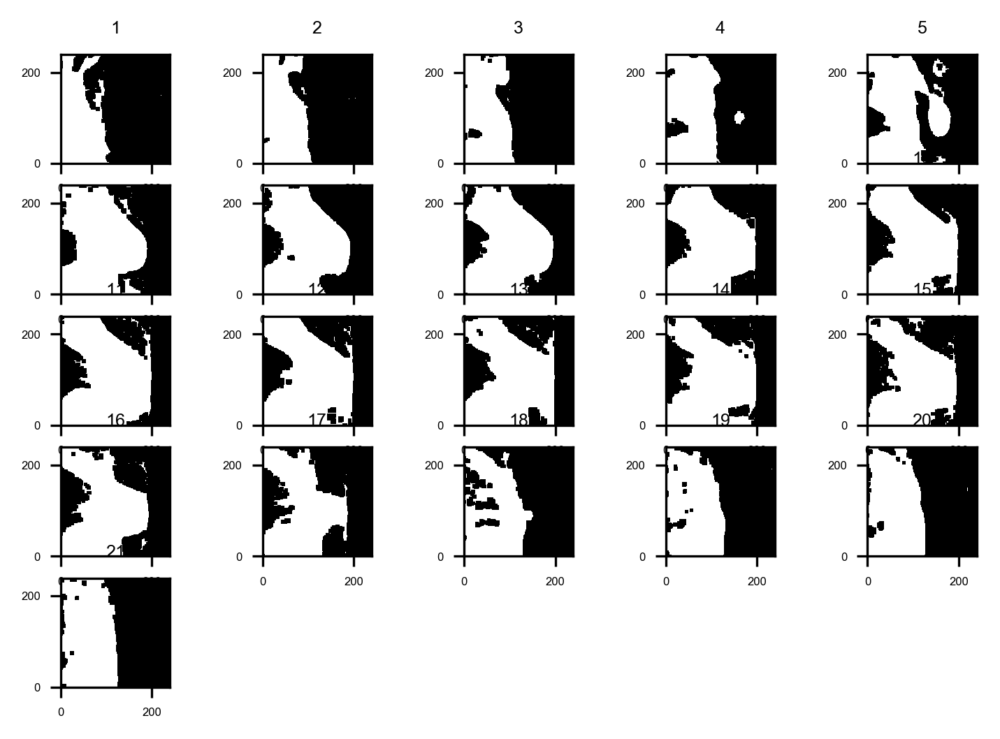

In [299]:
# Use uint8:

# Subtract the *blurred* last frame from all *blurred* frames:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

#frameLast = data[:,:,dimZ-1]

thresh = 20
thresh = 40
#thresh = 5
#thresh = 200
#thresh = 100
#thresh = 80
#thresh = 50

Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel7 = np.ones((7,7),np.uint8) # used for closing holes
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes

#blurKernel = 3
#blurKernel = 5
#blurKernel = 7
#frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

# Create empty 3D array:
#dataDiff = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    frame = np.uint8(frame)
    
    #frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    #frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameLastBlurred))
    
    #dataDiff[:,:,f] = frameDiff
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)
    
    
    # Convert to B&W using thresh:
    out = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]

    # Dilate:
    #diffBWdil = cv2.dilate(diffBW, Kernel5, iterations = 10) # dilate
    #diffBWdil = cv2.dilate(diffBW, Kernel2, iterations = 5) # dilate (holes not closing with kernel2)
    #diffBWdil = cv2.dilate(diffBW, Kernel3, iterations = 5) # dilate (better)
    #out = cv2.dilate(out, Kernel3, iterations = 7) # dilate (seems decent)
    out = cv2.dilate(out, Kernel3, iterations = 3) # dilate (seems decent)

    # Close holes:
    #diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel3) # close holes (seem decent)
    #diffBWdilClo = cv2.morphologyEx(diffBWdil, cv2.MORPH_CLOSE, Kernel5) # close holes (a bit better)
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) # close holes (seems fine)
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) # close holes (seems fine)
    out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel7) # close holes (seems fine)

    # Erode:
    #diffBWdilCloEro = cv2.erode(diffBWdilClo, Kernel5, iterations = 5) # erode (a bit too much)
    #out = cv2.erode(out, Kernel3, iterations = 5) # erode (seems decent)
    out = cv2.erode(out, Kernel3, iterations = 3) # erode (seems decent)
    

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, out);
    #pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

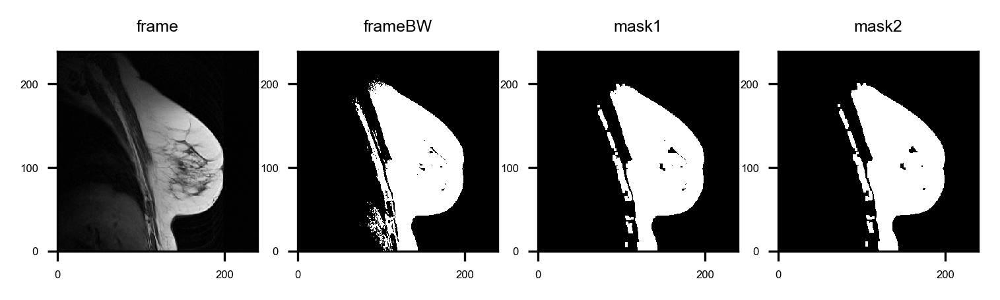

In [320]:
frame = data[:,:,11]

thresh = 200
#thresh = 20
#thresh = 15
#thresh = 10
#thresh = 5
#thresh = 1

#frameBW = 255*(cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) > thresh).astype('uint8')
frameBW = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]

se1 = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))
se2 = cv2.getStructuringElement(cv2.MORPH_RECT, (2,2))

mask1 = cv2.morphologyEx(frameBW, cv2.MORPH_CLOSE, se1)
mask2 = cv2.morphologyEx(mask1, cv2.MORPH_OPEN, se2)

mask1 = cv2.morphologyEx(frameBW, cv2.MORPH_CLOSE, se2)
mask2 = cv2.morphologyEx(mask1, cv2.MORPH_OPEN, se1)

mask1 = cv2.morphologyEx(frameBW, cv2.MORPH_OPEN, se1)
mask2 = cv2.morphologyEx(mask1, cv2.MORPH_CLOSE, se2)

#mask = np.dstack([mask, mask, mask]) / 255
#out = img * mask

pyplot.figure(dpi=300)

ax = pyplot.subplot(1,4,1, aspect='equal')
pyplot.pcolormesh(x, y, frame);
#pyplot.pcolormesh(x, y, frameDiffBlurred);
pyplot.title('frame', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(1,4,2, aspect='equal')
pyplot.pcolormesh(x, y, frameBW);
#pyplot.pcolormesh(x, y, frameDiffBlurred);
pyplot.title('frameBW', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(1,4,3, aspect='equal')
pyplot.pcolormesh(x, y, mask1);
#pyplot.pcolormesh(x, y, frameDiffBlurred);
pyplot.title('mask1', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(1,4,4, aspect='equal')
pyplot.pcolormesh(x, y, mask2);
#pyplot.pcolormesh(x, y, frameDiffBlurred);
pyplot.title('mask2', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

In [306]:
frame[25,100]

80

In [311]:
frame.dtype
frameBW.dtype

dtype('uint16')

frame is uint8
frameBlurred is uint8


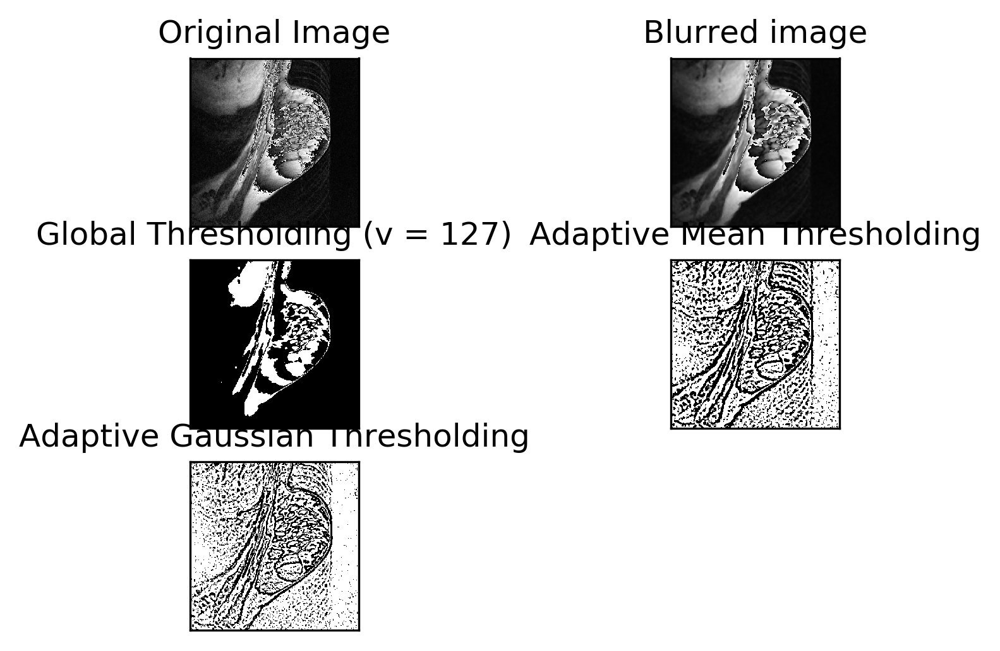

In [336]:
frame = data[:,:,11]

frameBlurred = cv2.medianBlur(frame,5)

frame = np.uint8(frame)
frameBlurred = np.uint8(frameBlurred)

print('frame is', str(frame.dtype))
print('frameBlurred is', str(frameBlurred.dtype))

thresh = 127

ret,th1 = cv2.threshold(frameBlurred,thresh,255,cv2.THRESH_BINARY)

th2 = cv2.adaptiveThreshold(frameBlurred,255,cv2.ADAPTIVE_THRESH_MEAN_C,\
            cv2.THRESH_BINARY,11,2)

th3 = cv2.adaptiveThreshold(frameBlurred,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv2.THRESH_BINARY,11,2)

titles = ['Original Image', 'Blurred image', 'Global Thresholding (v = {})'.format(thresh),
            'Adaptive Mean Thresholding', 'Adaptive Gaussian Thresholding']
images = [frame, frameBlurred, th1, th2, th3]

pyplot.figure(dpi=300)
for i in range(len(images)):
    pyplot.subplot(3,2,i+1),pyplot.imshow(images[i],'gray')
    pyplot.title(titles[i])
    pyplot.xticks([]),pyplot.yticks([])
pyplot.show()

In [341]:
2**16 - 1

65535

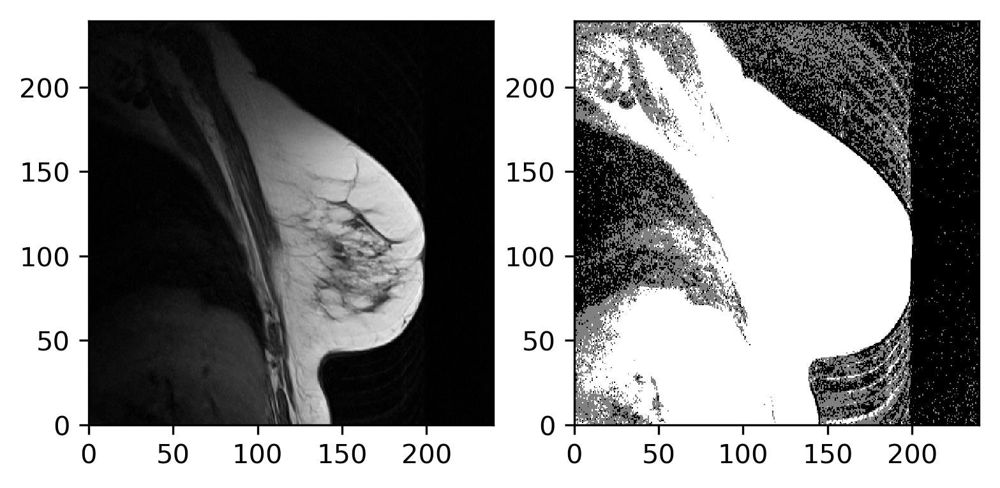

In [128]:
# Use many thresholds:

thresh_background = 2
thresh_body = 15
thresh_breast = 40

mask = numpy.zeros((dimY, dimX), dtype='float')

frameAve = np.average(frame)

for r in range(dimY):
    for c in range(dimX):
        if frame[r,c] < thresh_background:
            mask[r,c] = 0
        elif frame[r,c] > thresh_body and frame[r,c] < thresh_breast:
            mask[r,c] = 0.5
        elif frame[r,c] > thresh_breast:
            mask[r,c] = 1
            
            
pyplot.figure(dpi=300)
#pyplot.axes().set_aspect('equal', 'datalim')
pyplot.set_cmap(pyplot.gray())
pyplot.subplot(121, aspect='equal')
pyplot.pcolormesh(x, y, frame);
pyplot.subplot(122, aspect='equal')
pyplot.pcolormesh(x, y, mask);

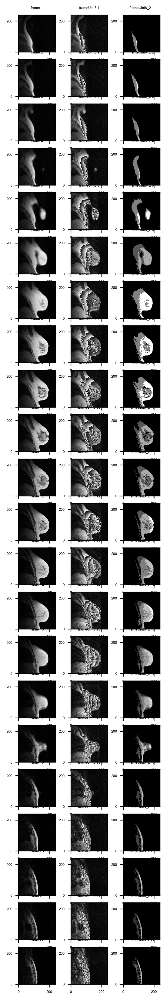

In [446]:



# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot pos

for f in range(dimZ):
    frame = data[:,:,f]
    
    frameUint8 = np.uint8(frame)
    
    #frameUint8_2 = frame.astype('uint8')# same as np.uint8(frame)
    frameUint8_2 = frame / 2**8
    frameUint8_2 = np.uint8(frameUint8_2)
    
    i = i + 1    
    
    ax = pyplot.subplot(dimZ,3,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    i = i + 1
    
    ax = pyplot.subplot(dimZ,3,i, aspect='equal')
    pyplot.pcolormesh(x, y, frameUint8);
    pyplot.title('frameUint8 ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    i = i + 1
    
    ax = pyplot.subplot(dimZ,3,i, aspect='equal')
    pyplot.pcolormesh(x, y, frameUint8_2);
    pyplot.title('frameUint8_2 ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

In [470]:
frame = data[:,:,f]
    
frameUint8 = np.uint8(frame)

frameUint8_2 = frame / 2**8

frameUint8_3 = np.uint8(frameUint8_2)


print('data is ', str(data.dtype), ' with max = ', str(np.max(data[:,:,:])))
print('frame is ', str(frame.dtype), ' with max = ', str(np.max(frame[:,:])))
print('frameUint8 is ', str(frameUint8.dtype), ' with max = ', str(np.max(frameUint8[:,:])))
print('frameUint8_2 is ', str(frameUint8_2.dtype), ' with max = ', str(np.max(frameUint8_2[:,:])))
print('frameUint8_3 is ', str(frameUint8_3.dtype), ' with max = ', str(np.max(frameUint8_3[:,:])))
print('')
print('2**8 = ', str(2**8))
print('2**16 = ', str(2**16))
print('')
print('256 * 1376/65536 = ', str((2**8)*(1376/65536)))

data is  uint16  with max =  1568
frame is  uint16  with max =  1376
frameUint8 is  uint8  with max =  255
frameUint8_2 is  float64  with max =  5.375
frameUint8_3 is  uint8  with max =  5

2**8 =  256
2**16 =  65536

256 * 1376/65536 =  5.375


In [471]:
# Normalise the pixel values to 255:

# Create empty 3D array using same datatype as pixel_array:
dataNorm = np.zeros((dimY, dimX, dimZ), dtype='uint8')

dataMaxVal = np.max(data[:,:,:])

for f in range(dimZ):
    frame = data[:,:,f]
    
    #frameNorm = frame/dataMaxVal
    frameNorm = 255.0*frame/dataMaxVal
    frameNorm = np.uint8(frameNorm)
    
    dataNorm[:,:,f] = frameNorm

In [467]:
print(dataMaxVal)
print(np.max(dataNorm[:,:,:]))

1568
255


In [472]:
frame

array([[39, 42, 40, ...,  5, 21, 25],
       [39, 37, 27, ...,  7, 13, 12],
       [30, 36, 29, ...,  2,  9, 18],
       ...,
       [17, 11, 11, ...,  9, 11,  8],
       [12, 13, 17, ..., 10,  7, 13],
       [ 8, 15, 24, ...,  7, 15, 11]], dtype=uint16)

In [473]:
frameNorm

array([[6, 6, 6, ..., 0, 3, 4],
       [6, 6, 4, ..., 1, 2, 1],
       [4, 5, 4, ..., 0, 1, 2],
       ...,
       [2, 1, 1, ..., 1, 1, 1],
       [1, 2, 2, ..., 1, 1, 2],
       [1, 2, 3, ..., 1, 2, 1]], dtype=uint8)

In [474]:
frameNorm.dtype

dtype('uint8')

In [502]:
# Add blurring to Normalise the pixel values to 255:

blurKernel = 3
#blurKernel = 5
#blurKernel = 7


# Create empty 3D array using same datatype as pixel_array:
dataNormBlurred = np.zeros((dimY, dimX, dimZ), dtype='uint8')

#dataMaxVal = np.max(data[:,:,:])

for f in range(dimZ):
    frame = dataNorm[:,:,f]
    
    frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameNorm = frame/dataMaxVal
    #frameNorm = 255.0*frame/dataMaxVal
    #frameNorm = np.uint8(frameNorm)
    
    dataNormBlurred[:,:,f] = frameBlurred

In [503]:
dataNormBlurred.dtype

dtype('uint8')

In [504]:
np.max(dataNormBlurred[:,:,:])

244

# Check result of conversion to uint8:

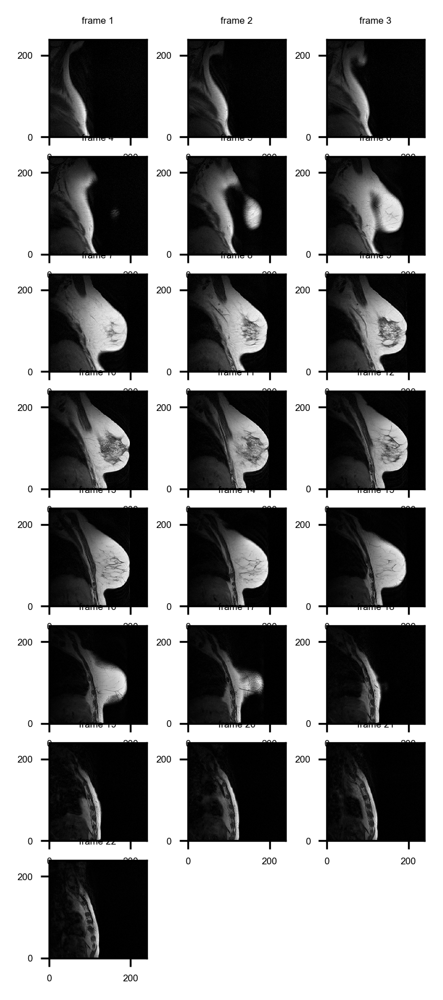

In [475]:
# Check result of convertion to uint8:


# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot pos

for f in range(dimZ):
    frame = dataNorm[:,:,f]
    
    if 0:
        frameUint8 = np.uint8(frame)

        #frameUint8_2 = frame.astype('uint8')# same as np.uint8(frame)
        frameUint8_2 = frame / 2**8
        frameUint8_2 = np.uint8(frameUint8_2)
    
    i = i + 1    
    
    ax = pyplot.subplot(dimZ,3,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    if 0:
        i = i + 1

        ax = pyplot.subplot(dimZ,3,i, aspect='equal')
        pyplot.pcolormesh(x, y, frameUint8);
        pyplot.title('frameUint8 ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)

        i = i + 1

        ax = pyplot.subplot(dimZ,3,i, aspect='equal')
        pyplot.pcolormesh(x, y, frameUint8_2);
        pyplot.title('frameUint8_2 ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)

# Use ave pix value for thresholding to obtain masks for body & breast:

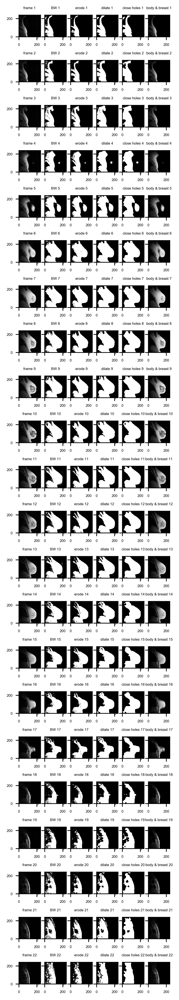

In [596]:
# Use dataNorm or dataNormBlurred:
use_blurred = 0 # use dataNorm
#use_blurred = 1 # use dataNormBlurred

if use_blurred:
    # Blur dataNorm:
    blurKernel = 3
    blurKernel = 5
    #blurKernel = 7

    # Create empty 3D array using same datatype as pixel_array:
    dataNormBlurred = np.zeros((dimY, dimX, dimZ), dtype='uint8')

    #dataMaxVal = np.max(data[:,:,:])

    for f in range(dimZ):
        frame = dataNorm[:,:,f]

        frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)

        dataNormBlurred[:,:,f] = frameBlurred
    
    
# Try different thresholds for body, breast and background
# using ave pix value (avePixVal) in each frame or
# using ave pix value across all frames:

ave_all_frames = 0 # use ave on frame-by-frame basis
ave_all_frames = 1 # use ave across all frames 

if use_blurred:
    avePixVal = np.average(dataNormBlurred[:,:,:]) # this will be updated if ave_all_frames = 0
else:
    avePixVal = np.average(dataNorm[:,:,:]) # this will be updated if ave_all_frames = 0

# Thresholds expressed as a % of avePixVal 
# for any given frame:
if use_blurred:
    #thresh_background = 0.2 # = 20%
    thresh_background = 0.1 # = 10%
#thresh_background = 0.02 # = 2%
#thresh_background = 0.005 # = 0.5%
if not use_blurred:
    thresh_background = 0.0001 # = 0.01% <-- seems good for dataNorm
    thresh_background = 0.5 # = 50%
    thresh_background = 0.25 # = 25%
    thresh_background = 0.35 # = 35%
    thresh_background = 0.4 # = 40% <---- seems to be ideal
    #thresh_background = 0.05 # = 5% 
#thresh_background = 0.00001 # = 0.001%
thresh_body = 0.15 # = 15%
thresh_breast = 0.40 # = 40%

Kernel1 = np.ones((1,1),np.uint8) # used for dilate
Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel7 = np.ones((7,7),np.uint8) # used for closing holes
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes
Kernel20 = np.ones((20,20),np.uint8) # used for closing holes
Kernel55 = np.ones((55,55),np.uint8) # used for closing holes

#blurKernel = 3
#blurKernel = 5
#blurKernel = 7

#mask = frameOut[0] # = frameMin
#mask = frameOut[3] # = frameStd

#maskNot = np.logical_not(mask) # take logical not

# Create empty 3D array for the bodyAndBreastMasks
# and backgroundMasks for each frame:
bodyAndBreastMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')
backgroundMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot pos

for f in range(dimZ):
    #frame = data[:,:,f]
    if use_blurred:
        frame = dataNormBlurred[:,:,f]
    else:
        frame = dataNorm[:,:,f]
    
    
    if not ave_all_frames:
        avePixVal = np.average(frame[:,:])
    
    i = i + 1    
    ax = pyplot.subplot(dimZ,6,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    """ First isolate the body and breast using thresh_background: """
    
    # Convert to B&W using thresh:
    thresh = avePixVal*thresh_background
    
    #print('thresh_background = ', str(thresh_background))
    #print('avePixVal = ', str(avePixVal))
    #print('thresh = ', str(thresh), '\n')
    
    mask = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]

    i = i + 1
    ax = pyplot.subplot(dimZ,6,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('BW ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

    # Erode:
    #out = cv2.erode(out, Kernel3, iterations = 5) 
    #mask = cv2.erode(mask, Kernel3, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 7)
    #mask = cv2.erode(mask, Kernel2, iterations = 10)
    #mask = cv2.erode(mask, Kernel2, iterations = 15)
    #mask = cv2.erode(mask, Kernel2, iterations = 20) # seems ok
    #mask = cv2.erode(mask, Kernel2, iterations = 30)
    #mask = cv2.erode(mask, Kernel3, iterations = 5)
    mask = cv2.erode(mask, Kernel2, iterations = 3)
    
    i = i + 1
    ax = pyplot.subplot(dimZ,6,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('erode ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

    # Dilate before closing holes!
    if 0:
        # Close holes:
        #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
        #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
        #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) # did nothing
        #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel55)

        i = i + 1
        ax = pyplot.subplot(dimZ,5,i, aspect='equal')
        pyplot.pcolormesh(x, y, mask);
        pyplot.title('close holes ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)

        
    # Dilate:
    #out = cv2.dilate(out, Kernel3, iterations = 7) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 3) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    mask = cv2.dilate(mask, Kernel2, iterations = 10)
    
    i = i + 1
    ax = pyplot.subplot(dimZ,6,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('dilate ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    

    # Close holes:
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) # no change
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11) # no change
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel20) # no change

    i = i + 1
    ax = pyplot.subplot(dimZ,6,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('close holes ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    # Convert mask to binary:
    bodyAndBreastMask = cv2.threshold(mask, 255/2, 1, cv2.THRESH_BINARY)[1]
    
    # Background mask is the logical compliment of bodyAndBreastMask:
    backgroundMask = np.logical_not(bodyAndBreastMask)
    
    # Store masks in 3D arrays:
    bodyAndBreastMasks[:,:,f] = bodyAndBreastMask
    backgroundMasks[:,:,f] = backgroundMask
    
    # Show result of bodyAndBreastMask:
    bodyAndBreast = bodyAndBreastMask*frame
    
    i = i + 1
    ax = pyplot.subplot(dimZ,6,i, aspect='equal')
    pyplot.pcolormesh(x, y, bodyAndBreast);
    pyplot.title('body & breast ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    

# Use similar approach to above but working with inverted images to obtain masks for body & background:

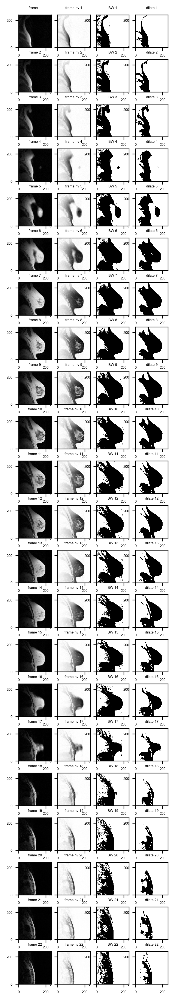

In [605]:
# Use dataNorm or dataNormBlurred:
use_blurred = 0 # use dataNorm
#use_blurred = 1 # use dataNormBlurred

if use_blurred:
    # Blur dataNorm:
    blurKernel = 3
    blurKernel = 5
    #blurKernel = 7

    # Create empty 3D array using same datatype as pixel_array:
    dataNormBlurred = np.zeros((dimY, dimX, dimZ), dtype='uint8')

    #dataMaxVal = np.max(data[:,:,:])

    for f in range(dimZ):
        frame = dataNorm[:,:,f]

        frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)

        dataNormBlurred[:,:,f] = frameBlurred
    
    
# Try different thresholds for body, breast and background
# using ave pix value (avePixVal) in each frame or
# using ave pix value across all frames:

ave_all_frames = 0 # use ave on frame-by-frame basis
ave_all_frames = 1 # use ave across all frames 

if use_blurred:
    avePixVal = np.average(dataNormBlurred[:,:,:]) # this will be updated if ave_all_frames = 0
else:
    avePixVal = np.average(dataNorm[:,:,:]) # this will be updated if ave_all_frames = 0

    
InvAvePixVal = np.average(dataNormInv[:,:,:])
    
# Thresholds expressed as a % of avePixVal 
# for any given frame:
if use_blurred:
    #thresh_background = 0.2 # = 20%
    thresh_background = 0.1 # = 10%
#thresh_background = 0.02 # = 2%
#thresh_background = 0.005 # = 0.5%
if not use_blurred:
    thresh_background = 0.0001 # = 0.01% <-- seems good for dataNorm
    thresh_background = 0.5 # = 50%
    thresh_background = 0.25 # = 25%
    thresh_background = 0.35 # = 35%
    thresh_background = 0.4 # = 40% <---- seems to be ideal for normal images
    thresh_background = 0.8 # = 80%
    thresh_background = 0.9 # = 90%
    thresh_background = 0.95 # = 95%
    thresh_background = 1.25 # = 125%
    thresh_background = 1.15 # = 115%
    thresh_background = 1.05 # = 105%
#thresh_background = 0.00001 # = 0.001%
thresh_body = 0.15 # = 15%
thresh_breast = 0.40 # = 40%

Kernel1 = np.ones((1,1),np.uint8) # used for dilate
Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel7 = np.ones((7,7),np.uint8) # used for closing holes
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes
Kernel20 = np.ones((20,20),np.uint8) # used for closing holes
Kernel55 = np.ones((55,55),np.uint8) # used for closing holes

#blurKernel = 3
#blurKernel = 5
#blurKernel = 7

#mask = frameOut[0] # = frameMin
#mask = frameOut[3] # = frameStd

#maskNot = np.logical_not(mask) # take logical not

# Create empty 3D array for the bodyAndBreastMasks
# and backgroundMasks for each frame:
bodyAndBreastMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')
backgroundMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot pos

cols = 4

for f in range(dimZ):
    #frame = data[:,:,f]
    if use_blurred:
        frame = dataNormBlurred[:,:,f]
    else:
        frame = dataNorm[:,:,f]
    
    
    if not ave_all_frames:
        avePixVal = np.average(frame[:,:])
    
    i = i + 1    
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
     
    
    # Work with inverted images:
    frameInv = dataNormInv[:,:,f]
    
    i = i + 1    
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, frameInv);
    pyplot.title('frameInv ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    
    """ First isolate the body and breast using thresh_background: """
    
    # Convert to B&W using thresh:
    #thresh = avePixVal*thresh_background
    thresh = InvAvePixVal*thresh_background
    
    #print('thresh_background = ', str(thresh_background))
    #print('avePixVal = ', str(avePixVal))
    #print('thresh = ', str(thresh), '\n')
    
    #mask = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]
    mask = cv2.threshold(frameInv, thresh, 255, cv2.THRESH_BINARY)[1]

    # Take inverse of mask:
    #mask = 255 - mask
    
    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('BW ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

        
    # Dilate:
    #out = cv2.dilate(out, Kernel3, iterations = 7) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 3) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    mask = cv2.dilate(mask, Kernel2, iterations = 10)
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    
    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('dilate ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
        
    if 0:  
        # Erode:
        #out = cv2.erode(out, Kernel3, iterations = 5) 
        #mask = cv2.erode(mask, Kernel3, iterations = 3)
        #mask = cv2.erode(mask, Kernel2, iterations = 3)
        #mask = cv2.erode(mask, Kernel2, iterations = 7)
        #mask = cv2.erode(mask, Kernel2, iterations = 10)
        #mask = cv2.erode(mask, Kernel2, iterations = 15)
        #mask = cv2.erode(mask, Kernel2, iterations = 20) # seems ok
        #mask = cv2.erode(mask, Kernel2, iterations = 30)
        #mask = cv2.erode(mask, Kernel3, iterations = 5)
        mask = cv2.erode(mask, Kernel2, iterations = 3)

        i = i + 1
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, mask);
        pyplot.title('erode ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)

        # Dilate before closing holes!
        if 0:
            # Close holes:
            #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
            #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
            #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) # did nothing
            #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11)
            mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel55)

            i = i + 1
            ax = pyplot.subplot(dimZ,5,i, aspect='equal')
            pyplot.pcolormesh(x, y, mask);
            pyplot.title('close holes ' + str(f+1), **title_font)

            # Set the tick labels font
            for label in (ax.get_xticklabels() + ax.get_yticklabels()):
                label.set_fontname('Arial')
                label.set_fontsize(4)


        # Dilate:
        #out = cv2.dilate(out, Kernel3, iterations = 7) 
        #mask = cv2.dilate(mask, Kernel3, iterations = 3) 
        #mask = cv2.dilate(mask, Kernel3, iterations = 10)
        #mask = cv2.dilate(mask, Kernel2, iterations = 10)
        mask = cv2.dilate(mask, Kernel3, iterations = 10)

        i = i + 1
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, mask);
        pyplot.title('dilate ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)


        # Close holes:
        #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
        #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
        #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) # no change
        #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11) # no change
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel20) # no change

        i = i + 1
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, mask);
        pyplot.title('close holes ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)

        # Convert mask to binary:
        bodyAndBreastMask = cv2.threshold(mask, 255/2, 1, cv2.THRESH_BINARY)[1]

        # Background mask is the logical compliment of bodyAndBreastMask:
        backgroundMask = np.logical_not(bodyAndBreastMask)

        # Store masks in 3D arrays:
        bodyAndBreastMasks[:,:,f] = bodyAndBreastMask
        backgroundMasks[:,:,f] = backgroundMask

        # Show result of bodyAndBreastMask:
        bodyAndBreast = bodyAndBreastMask*frame

        i = i + 1
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, bodyAndBreast);
        pyplot.title('body & breast ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)


# Instead of using cv.threshold use for loops and different thresholds:

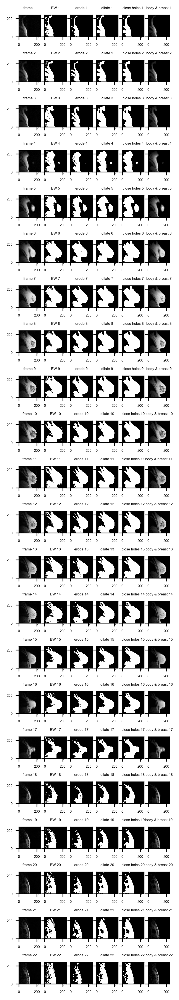

In [616]:
# Use dataNorm or dataNormBlurred:
use_blurred = 0 # use dataNorm
#use_blurred = 1 # use dataNormBlurred

if use_blurred:
    # Blur dataNorm:
    blurKernel = 3
    blurKernel = 5
    #blurKernel = 7

    # Create empty 3D array using same datatype as pixel_array:
    dataNormBlurred = np.zeros((dimY, dimX, dimZ), dtype='uint8')

    #dataMaxVal = np.max(data[:,:,:])

    for f in range(dimZ):
        frame = dataNorm[:,:,f]

        frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)

        dataNormBlurred[:,:,f] = frameBlurred
    
    
# Try different thresholds for body, breast and background
# using ave pix value (avePixVal) in each frame or
# using ave pix value across all frames:

ave_all_frames = 0 # use ave on frame-by-frame basis
ave_all_frames = 1 # use ave across all frames 

if use_blurred:
    avePixVal = np.average(dataNormBlurred[:,:,:]) # this will be updated if ave_all_frames = 0
else:
    avePixVal = np.average(dataNorm[:,:,:]) # this will be updated if ave_all_frames = 0

    
InvAvePixVal = np.average(dataNormInv[:,:,:])
    
# Thresholds expressed as a % of avePixVal 
# for any given frame:
if use_blurred:
    #thresh_background = 0.2 # = 20%
    thresh_background = 0.1 # = 10%
#thresh_background = 0.02 # = 2%
#thresh_background = 0.005 # = 0.5%
if not use_blurred:
    thresh_background = 0.0001 # = 0.01% <-- seems good for dataNorm
    thresh_background = 0.5 # = 50%
    thresh_background = 0.25 # = 25%
    thresh_background = 0.35 # = 35%
    thresh_background = 0.4 # = 40% of avePixVal <---- seems to be ideal for normal images
    #thresh_background = 0.8 # = 80%
    #thresh_background = 0.9 # = 90%
    #thresh_background = 0.95 # = 95%
    #thresh_background = 1.25 # = 125%
    #thresh_background = 1.15 # = 115%
    #thresh_background = 1.05 # = 105%
#thresh_background = 0.00001 # = 0.001%
thresh_body = 0.15 # = 15%
thresh_breast = 0.40 # = 40%

Kernel1 = np.ones((1,1),np.uint8) # used for dilate
Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel7 = np.ones((7,7),np.uint8) # used for closing holes
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes
Kernel20 = np.ones((20,20),np.uint8) # used for closing holes
Kernel50 = np.ones((50,50),np.uint8) # used for closing holes

#blurKernel = 3
#blurKernel = 5
#blurKernel = 7

#mask = frameOut[0] # = frameMin
#mask = frameOut[3] # = frameStd

#maskNot = np.logical_not(mask) # take logical not

# Create empty 3D array for the bodyAndBreastMasks
# and backgroundMasks for each frame:
bodyAndBreastMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')
backgroundMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot pos

cols = 6

for f in range(dimZ):
    #frame = data[:,:,f]
    if use_blurred:
        frame = dataNormBlurred[:,:,f]
    else:
        frame = dataNorm[:,:,f]
    
    
    if not ave_all_frames:
        avePixVal = np.average(frame[:,:])
    
    i = i + 1    
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
     
    
    if 0:
        # Work with inverted images:
        frameInv = dataNormInv[:,:,f]

        i = i + 1    
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, frameInv);
        pyplot.title('frameInv ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)
    
    
    """ First isolate the body and breast using thresh_background: """
    
    # Convert to B&W using thresh:
    thresh = avePixVal*thresh_background
    #thresh = InvAvePixVal*thresh_background
    
    #print('thresh_background = ', str(thresh_background))
    #print('avePixVal = ', str(avePixVal))
    #print('thresh = ', str(thresh), '\n')
    
    #mask = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]
    #mask = cv2.threshold(frameInv, thresh, 255, cv2.THRESH_BINARY)[1]

    # Take inverse of mask:
    #mask = 255 - mask
    
    # Create empty array for mask:
    mask = np.zeros((dimY, dimX), dtype='uint8')
    
    for r in range(dimY):
        for c in range(dimX):
            if frame[r,c] > thresh:
                mask[r,c] = 255
    
    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('BW ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

        
      
    # Erode:
    #out = cv2.erode(out, Kernel3, iterations = 5) 
    #mask = cv2.erode(mask, Kernel3, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 7)
    #mask = cv2.erode(mask, Kernel2, iterations = 10)
    #mask = cv2.erode(mask, Kernel2, iterations = 15)
    #mask = cv2.erode(mask, Kernel2, iterations = 20) # seems ok
    #mask = cv2.erode(mask, Kernel2, iterations = 30)
    #mask = cv2.erode(mask, Kernel3, iterations = 5)
    #mask = cv2.erode(mask, Kernel2, iterations = 3)
    mask = cv2.erode(mask, Kernel3, iterations = 3)

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('erode ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

    
    
    # Dilate:
    #out = cv2.dilate(out, Kernel3, iterations = 7) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 3) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    #mask = cv2.dilate(mask, Kernel2, iterations = 10)
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    mask = cv2.dilate(mask, Kernel5, iterations = 3)
    #mask = cv2.dilate(mask, Kernel3, iterations = 3)

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('dilate ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
            
            
    
    # Close holes:
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) 
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11) 
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel20) 

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('close holes ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
        
        

    # Convert mask to binary:
    bodyAndBreastMask = cv2.threshold(mask, 255/2, 1, cv2.THRESH_BINARY)[1]

    # Background mask is the logical compliment of bodyAndBreastMask:
    backgroundMask = np.logical_not(bodyAndBreastMask)

    # Store masks in 3D arrays:
    bodyAndBreastMasks[:,:,f] = bodyAndBreastMask
    backgroundMasks[:,:,f] = backgroundMask

    # Show result of bodyAndBreastMask:
    bodyAndBreast = bodyAndBreastMask*frame

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, bodyAndBreast);
    pyplot.title('body & breast ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)


In [619]:
avePixVal

18.450101910215437

In [620]:
maxPixVal

255

In [621]:
thresh

14.76008152817235

# Similar to above but now try to isolate the body from the rest:

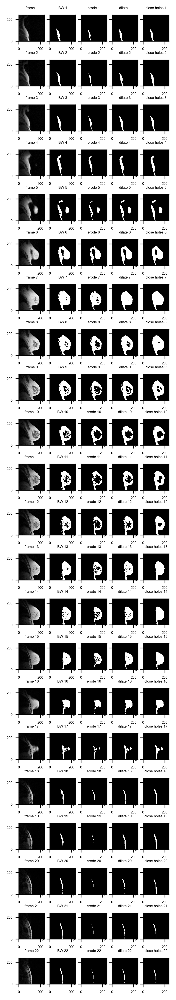

In [628]:
# Use dataNorm or dataNormBlurred:
use_blurred = 0 # use dataNorm
#use_blurred = 1 # use dataNormBlurred

if use_blurred:
    # Blur dataNorm:
    blurKernel = 3
    blurKernel = 5
    #blurKernel = 7

    # Create empty 3D array using same datatype as pixel_array:
    dataNormBlurred = np.zeros((dimY, dimX, dimZ), dtype='uint8')

    #dataMaxVal = np.max(data[:,:,:])

    for f in range(dimZ):
        frame = dataNorm[:,:,f]

        frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)

        dataNormBlurred[:,:,f] = frameBlurred
    
    
# Try different thresholds for body, breast and background
# using ave pix value (avePixVal) in each frame or
# using ave pix value across all frames:
ave_all_frames = 0 # use ave on frame-by-frame basis
ave_all_frames = 1 # use ave across all frames 

if use_blurred:
    avePixVal = np.average(dataNormBlurred[:,:,:]) # this will be updated if ave_all_frames = 0
else:
    avePixVal = np.average(dataNorm[:,:,:]) # this will be updated if ave_all_frames = 0

# Try different thresholds for body, breast and background
# using max pix value (maxPixVal) in each frame or
# using max pix value across all frames:
max_all_frames = 0 # use max on frame-by-frame basis
#max_all_frames = 1 # use max across all frames 

maxPixVal = np.max(dataNorm[:,:,:]) 
    
InvAvePixVal = np.average(dataNormInv[:,:,:])
    
# Thresholds expressed as a % of avePixVal 
# for any given frame:
if use_blurred:
    #thresh_background = 0.2 # = 20%
    thresh_background = 0.1 # = 10%
#thresh_background = 0.02 # = 2%
#thresh_background = 0.005 # = 0.5%
if not use_blurred:
    thresh_background = 0.0001 # = 0.01% <-- seems good for dataNorm
    thresh_background = 0.5 # = 50%
    thresh_background = 0.25 # = 25%
    thresh_background = 0.35 # = 35%
    thresh_background = 0.4 # = 40% of avePixVal <---- seems to be ideal for normal images
    #thresh_background = 0.8 # = 80%
    #thresh_background = 0.9 # = 90%
    #thresh_background = 0.95 # = 95%
    #thresh_background = 1.25 # = 125%
    #thresh_background = 1.15 # = 115%
    #thresh_background = 1.05 # = 105%
#thresh_background = 0.00001 # = 0.001%

#thresh_body = 0.15 # = 15%

# A threshold value of 40% of avePixVal was useful for isolating the body+breast from
# the background.  Now try to determine a suitable threshold value as a % of maxPixVal
# that isolates the breast from the body:
thresh_breast = 0.8 # = 80% of maxPixVal (too high)
thresh_breast = 0.7 # = 70% of maxPixVal (too high)
thresh_breast = 0.5 # = 50% of maxPixVal (too high)
#thresh_breast = 0.25 # = 20% of maxPixVal (ok-ish when using maxPixVal for all frames)

Kernel1 = np.ones((1,1),np.uint8) # used for dilate
Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel7 = np.ones((7,7),np.uint8) # used for closing holes
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes
Kernel20 = np.ones((20,20),np.uint8) # used for closing holes
Kernel50 = np.ones((50,50),np.uint8) # used for closing holes

#blurKernel = 3
#blurKernel = 5
#blurKernel = 7

#mask = frameOut[0] # = frameMin
#mask = frameOut[3] # = frameStd

#maskNot = np.logical_not(mask) # take logical not

# Create empty 3D array for the bodyAndBreastMasks
# and backgroundMasks for each frame:
bodyAndBreastMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')
backgroundMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot pos

cols = 5

for f in range(dimZ):
    #frame = data[:,:,f]
    if use_blurred:
        frame = dataNormBlurred[:,:,f]
    else:
        frame = dataNorm[:,:,f]
    
    
    if not ave_all_frames:
        avePixVal = np.average(frame[:,:])
    
    if not max_all_frames:
        maxPixVal = np.max(frame[:,:])
    
    i = i + 1    
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
     
    
    if 0:
        # Work with inverted images:
        frameInv = dataNormInv[:,:,f]

        i = i + 1    
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, frameInv);
        pyplot.title('frameInv ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)
    
    
    """ First isolate the body and breast using thresh_background: """
    
    # Convert to B&W using thresh:
    #thresh = avePixVal*thresh_background
    ##thresh = InvAvePixVal*thresh_background
    thresh = maxPixVal*thresh_breast
    
    #print('thresh_background = ', str(thresh_background))
    #print('avePixVal = ', str(avePixVal))
    #print('thresh = ', str(thresh), '\n')
    
    #mask = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]
    #mask = cv2.threshold(frameInv, thresh, 255, cv2.THRESH_BINARY)[1]

    # Take inverse of mask:
    #mask = 255 - mask
    
    # Create empty array for mask:
    mask = np.zeros((dimY, dimX), dtype='uint8')
    
    for r in range(dimY):
        for c in range(dimX):
            if frame[r,c] > thresh:
                mask[r,c] = 255
    
    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('BW ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

        
      
    # Erode:
    #out = cv2.erode(out, Kernel3, iterations = 5) 
    #mask = cv2.erode(mask, Kernel3, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 7)
    #mask = cv2.erode(mask, Kernel2, iterations = 10)
    #mask = cv2.erode(mask, Kernel2, iterations = 15)
    #mask = cv2.erode(mask, Kernel2, iterations = 20) # seems ok
    #mask = cv2.erode(mask, Kernel2, iterations = 30)
    #mask = cv2.erode(mask, Kernel3, iterations = 5)
    #mask = cv2.erode(mask, Kernel2, iterations = 3)
    mask = cv2.erode(mask, Kernel3, iterations = 3)

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('erode ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

    
    
    # Dilate:
    #out = cv2.dilate(out, Kernel3, iterations = 7) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 3) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    #mask = cv2.dilate(mask, Kernel2, iterations = 10)
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    #mask = cv2.dilate(mask, Kernel5, iterations = 3)
    mask = cv2.dilate(mask, Kernel3, iterations = 3)

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('dilate ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
            
            
    
    # Close holes:
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) 
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11) 
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel20) 

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('close holes ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
        
        

    if 0:
        # Convert mask to binary:
        bodyAndBreastMask = cv2.threshold(mask, 255/2, 1, cv2.THRESH_BINARY)[1]

        # Background mask is the logical compliment of bodyAndBreastMask:
        backgroundMask = np.logical_not(bodyAndBreastMask)

        # Store masks in 3D arrays:
        bodyAndBreastMasks[:,:,f] = bodyAndBreastMask
        backgroundMasks[:,:,f] = backgroundMask

        # Show result of bodyAndBreastMask:
        bodyAndBreast = bodyAndBreastMask*frame

        i = i + 1
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, bodyAndBreast);
        pyplot.title('body & breast ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)


# Similar to above but now try to isolate the body under the breast using the standard deviation of all frames:

frameStd = np.std(dataNorm, axis=2)

frameStdMax = np.max(frameStd[:,:])

thresh_std = 0.2 # 20% of frameStdMax


Kernel1 = np.ones((1,1),np.uint8) # used for dilate
Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel7 = np.ones((7,7),np.uint8) # used for closing holes
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes
Kernel20 = np.ones((20,20),np.uint8) # used for closing holes
Kernel50 = np.ones((50,50),np.uint8) # used for closing holes

#blurKernel = 3
#blurKernel = 5
#blurKernel = 7


# Create empty 3D array for the bodyAndBreastMasks
# and backgroundMasks for each frame:
#bodyAndBreastMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')
#backgroundMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot pos

cols = 5

for f in range(dimZ):
    #frame = data[:,:,f]
    if use_blurred:
        frame = dataNormBlurred[:,:,f]
    else:
        frame = dataNorm[:,:,f]
    
    
    if not ave_all_frames:
        avePixVal = np.average(frame[:,:])
    
    if not max_all_frames:
        maxPixVal = np.max(frame[:,:])
    
    i = i + 1    
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
     
    
    if 0:
        # Work with inverted images:
        frameInv = dataNormInv[:,:,f]

        i = i + 1    
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, frameInv);
        pyplot.title('frameInv ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)
    
    
    """ First isolate the body and breast using thresh_background: """
    
    # Convert to B&W using thresh:
    #thresh = avePixVal*thresh_background
    ##thresh = InvAvePixVal*thresh_background
    #thresh = maxPixVal*thresh_breast
    thresh = frameStdMax*thresh_std
    
    #print('thresh_background = ', str(thresh_background))
    #print('avePixVal = ', str(avePixVal))
    #print('thresh = ', str(thresh), '\n')
    
    #mask = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]
    #mask = cv2.threshold(frameInv, thresh, 255, cv2.THRESH_BINARY)[1]

    # Take inverse of mask:
    #mask = 255 - mask
    
    # Create empty array for mask:
    mask = np.zeros((dimY, dimX), dtype='uint8')
    
    for r in range(dimY):
        for c in range(dimX):
            if frame[r,c] < thresh:
                mask[r,c] = 255
    
    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('BW ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

        
      
    # Erode:
    #out = cv2.erode(out, Kernel3, iterations = 5) 
    #mask = cv2.erode(mask, Kernel3, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 7)
    #mask = cv2.erode(mask, Kernel2, iterations = 10)
    #mask = cv2.erode(mask, Kernel2, iterations = 15)
    #mask = cv2.erode(mask, Kernel2, iterations = 20) # seems ok
    #mask = cv2.erode(mask, Kernel2, iterations = 30)
    #mask = cv2.erode(mask, Kernel3, iterations = 5)
    #mask = cv2.erode(mask, Kernel2, iterations = 3)
    mask = cv2.erode(mask, Kernel3, iterations = 3)

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('erode ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

    
    
    # Dilate:
    #out = cv2.dilate(out, Kernel3, iterations = 7) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 3) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    #mask = cv2.dilate(mask, Kernel2, iterations = 10)
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    #mask = cv2.dilate(mask, Kernel5, iterations = 3)
    mask = cv2.dilate(mask, Kernel3, iterations = 3)

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('dilate ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
            
            
    
    # Close holes:
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) 
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11) 
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel20) 

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('close holes ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
        
        

    if 0:
        # Convert mask to binary:
        bodyAndBreastMask = cv2.threshold(mask, 255/2, 1, cv2.THRESH_BINARY)[1]

        # Background mask is the logical compliment of bodyAndBreastMask:
        backgroundMask = np.logical_not(bodyAndBreastMask)

        # Store masks in 3D arrays:
        bodyAndBreastMasks[:,:,f] = bodyAndBreastMask
        backgroundMasks[:,:,f] = backgroundMask

        # Show result of bodyAndBreastMask:
        bodyAndBreast = bodyAndBreastMask*frame

        i = i + 1
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, bodyAndBreast);
        pyplot.title('body & breast ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)


In [559]:
bodyAndBreastMasks

array([[[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]],

       [[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]],

       [[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, Fal

In [560]:
backgroundMasks

array([[[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]],

       [[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]],

       [[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  Tr

In [431]:
for f in range(dimZ):
    frame = data[:,:,f]
    
    avePixVal = np.average(frame[:,:])
    print(avePixVal)

42.70514594184028
49.133707682291664
51.792948404947914
66.39743381076389
99.99940999348958
154.31224229600696
163.08234320746527
156.38920084635416
152.01978217230902
153.21346706814236
152.35087076822916
157.61673312717014
172.51340060763889
184.91847059461804
188.69488525390625
177.6367662217882
104.88343641493056
63.346462673611114
64.46917046440973
67.23999701605902
70.98200819227431
72.378662109375


In [435]:
mask.dtype

dtype('uint16')

In [436]:
mask

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint16)

In [437]:
np.max(frame[:,:])

1376

In [553]:
# Use the min of bodyAndBreastMasks as the bodyMask:

bodyMask = np.min(bodyAndBreastMasks, axis=2) # this is too extreme in reducing the mask size

#bodyMask

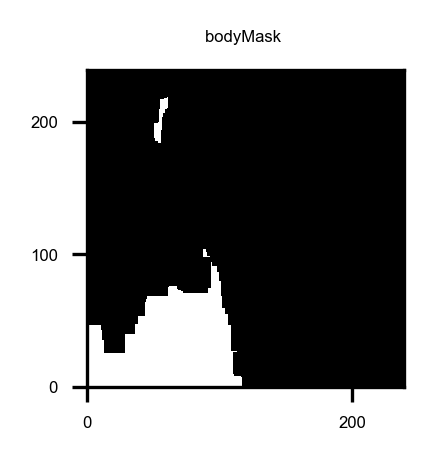

In [554]:
pyplot.figure(figsize=(3, 20), dpi=300)

ax = pyplot.subplot(2,2,1, aspect='equal')
pyplot.pcolormesh(x, y, bodyMask);
pyplot.title('bodyMask ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

In [555]:
# Instead of using np.min, use the mask that has the smallest area:

areas = []

for f in range(dimZ):
    mask = bodyAndBreastMasks[:,:,f]
    
    area = np.sum(mask)
    
    areas.append(area)

areas

[46710,
 52075,
 60389,
 62677,
 71425,
 83739,
 80153,
 84968,
 84205,
 86128,
 83532,
 82796,
 77088,
 78826,
 70296,
 67815,
 61446,
 51521,
 46790,
 49632,
 53205,
 53081]

In [556]:
# Find the index of the mask in bodyAndBreastMasks with the minimum area:

#maskMinInd = [mask in masks if areas==min(areas)]

bodyMaskInd = areas.index(min(areas))

bodyMask = bodyAndBreastMasks[:,:,bodyMaskInd]

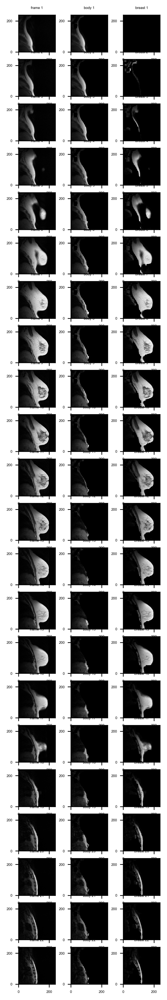

In [549]:
# Use bodyMask to try to isolate the bodyAndBreastMask:



# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot position

cols = 3

for f in range(dimZ):
    frame = dataNorm[:,:,f]
    
    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    """ Use dataMasksMin to isolate the body from body+breast """
    
    body = bodyMask*frame

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, body);
    pyplot.title('body ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

        
    """ Use dataMasksMin and dataMasks to isolate the breast from body+breast """
    
    #breastMask = dataMasks[:,:,f] - dataMasksMin
    breastMask = np.bitwise_xor(dataMasks[:,:,f], dataMasksMin)
    
    breast = breastMask*frame
    
    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, breast);
    pyplot.title('breast ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)


    if 0:
        i = i + 1

        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, mask);
        pyplot.title('dilate ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)



        i = i + 1

        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, mask);
        pyplot.title('close holes ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)

        # Convert mask to binary:
        #mask = cv2.threshold(mask, 255/2, 1, cv2.THRESH_BINARY)[1]

        #dataMasks[:,:,f] = mask


# Use ave pix value for thresholding:



# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot pos

for f in range(dimZ):
    #frame = data[:,:,f]
    if use_blurred:
        frame = dataNormBlurred[:,:,f]
    else:
        frame = dataNorm[:,:,f]
    
    
    if not ave_all_frames:
        avePixVal = np.average(frame[:,:])
    
    i = i + 1    
    
    ax = pyplot.subplot(dimZ,5,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    """ First isolate the body and breast using thresh_background: """
    
    # Convert to B&W using thresh:
    thresh = avePixVal*thresh_background
    
    print('thresh_background = ', str(thresh_background))
    print('avePixVal = ', str(avePixVal))
    print('thresh = ', str(thresh), '\n')
    
    mask = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]

    i = i + 1
    
    ax = pyplot.subplot(dimZ,5,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('BW ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

    # Erode:
    #out = cv2.erode(out, Kernel3, iterations = 5) 
    #mask = cv2.erode(mask, Kernel3, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 7)
    #mask = cv2.erode(mask, Kernel2, iterations = 10)
    #mask = cv2.erode(mask, Kernel2, iterations = 15)
    mask = cv2.erode(mask, Kernel2, iterations = 20) # seems ok
    #mask = cv2.erode(mask, Kernel2, iterations = 30)
    #mask = cv2.erode(mask, Kernel3, iterations = 5)
    
    i = i + 1
    
    ax = pyplot.subplot(dimZ,5,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('erode ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

    # Dilate before closing holes!
    if 0:
        # Close holes:
        #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
        #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
        #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) # did nothing
        #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel55)

        i = i + 1

        ax = pyplot.subplot(dimZ,5,i, aspect='equal')
        pyplot.pcolormesh(x, y, mask);
        pyplot.title('close holes ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)

        
    # Dilate:
    #out = cv2.dilate(out, Kernel3, iterations = 7) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 3) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    mask = cv2.dilate(mask, Kernel2, iterations = 10)
    
    i = i + 1
    
    ax = pyplot.subplot(dimZ,5,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('dilate ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    

    # Close holes:
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) # no change
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11) # no change
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel20) # no change

    i = i + 1

    ax = pyplot.subplot(dimZ,5,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('close holes ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    # Convert mask to binary:
    mask = cv2.threshold(mask, 255/2, 1, cv2.THRESH_BINARY)[1]
    
    dataMasks[:,:,f] = mask
    

# Try working with inverse of images:

In [566]:
# Start with 3D array of 255 values:
ones3D = 255*np.ones((dimY, dimX, dimZ), dtype='uint8')

ones3D

# Actually a 2D array is sufficient:
ones2D = 255*np.ones((dimY, dimX), dtype='uint8')

ones2D

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)

In [568]:
# Create empty 3D array for dataNormInv:
dataNormInv = np.zeros((dimY, dimX, dimZ), dtype='uint8')

for f in range(dimZ):
    frame = dataNorm[:,:,f]
    
    frameInv = ones2D - frame
    
    dataNormInv[:,:,f] = frameInv

# Use max pix value as thresholding:

# Use dataNorm or dataNormBlurred:
use_blurred = 0 # use dataNorm
#use_blurred = 1 # use dataNormBlurred


# Blur dataNorm:
blurKernel = 3
blurKernel = 5
#blurKernel = 7

# Create empty 3D array using same datatype as pixel_array:
dataNormBlurred = np.zeros((dimY, dimX, dimZ), dtype='uint8')

#dataMaxVal = np.max(data[:,:,:])

for f in range(dimZ):
    frame = dataNorm[:,:,f]

    frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)

    dataNormBlurred[:,:,f] = frameBlurred
    
    
# Try different thresholds for body, breast and background
# using max pix value (avePixVal) in each frame or
# using max pix value across all frames:

max_all_frames = 0 # use max on frame-by-frame basis
max_all_frames = 1 # use max across all frames 

if use_blurred:
    maxPixVal = np.max(dataNormBlurred[:,:,:]) # this will be updated if ave_all_frames = 0
else:
    maxPixVal = np.max(dataNorm[:,:,:]) # this will be updated if ave_all_frames = 0

# Thresholds expressed as a % of avePixVal 
# for any given frame:
if use_blurred:
    #thresh_background = 0.2 # = 20%
    thresh_background = 0.1 # = 10%
#thresh_background = 0.02 # = 2%
#thresh_background = 0.005 # = 0.5%
if not use_blurred:
    thresh_background = 0.0001 # = 0.01% <-- seems good for dataNorm using avePixVal
    thresh_background = 0.00001
#thresh_background = 0.00001 # = 0.001%
thresh_body = 0.15 # = 15%
thresh_breast = 0.40 # = 40%

Kernel1 = np.ones((1,1),np.uint8) # used for dilate
Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel7 = np.ones((7,7),np.uint8) # used for closing holes
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes
Kernel20 = np.ones((20,20),np.uint8) # used for closing holes
Kernel55 = np.ones((55,55),np.uint8) # used for closing holes

#blurKernel = 3
#blurKernel = 5
#blurKernel = 7

#mask = frameOut[0] # = frameMin
#mask = frameOut[3] # = frameStd

#maskNot = np.logical_not(mask) # take logical not

# Create empty 3D array for the bodyAndBreastMasks
# and backgroundMasks for each frame:
bodyAndBreastMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')
backgroundMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot pos

cols = 3

for f in range(dimZ):
    #frame = data[:,:,f]
    if use_blurred:
        frame = dataNormBlurred[:,:,f]
    else:
        frame = dataNorm[:,:,f]
    
    
    if not max_all_frames:
        maxPixVal = np.max(frame[:,:])
    
    i = i + 1    
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
        
    
    if 0:
        frameInv = dataNormInv[:,:,f]

        i = i + 1    
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, frameInv);
        pyplot.title('frameInv ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)
        
    if 0:  
        frameBlurred = dataNormBlurred[:,:,f]

        i = i + 1    
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, frameBlurred);
        pyplot.title('frameBlurred ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)
        
    
    
    """ First isolate the body and breast using thresh_background: """

    # Convert to B&W using thresh:
    thresh = maxPixVal*thresh_background
    
    print('thresh_background = ', str(thresh_background))
    print('maxPixVal = ', str(maxPixVal))
    print('thresh = ', str(thresh), '\n')

    mask = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('BW ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

    
    # Erode:
    #out = cv2.erode(out, Kernel3, iterations = 5) 
    #mask = cv2.erode(mask, Kernel3, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 7)
    #mask = cv2.erode(mask, Kernel2, iterations = 10)
    #mask = cv2.erode(mask, Kernel2, iterations = 15)
    mask = cv2.erode(mask, Kernel2, iterations = 20) # seems ok
    #mask = cv2.erode(mask, Kernel2, iterations = 30)
    #mask = cv2.erode(mask, Kernel3, iterations = 5)

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('erode ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

    # Dilate before closing holes!
    if 0:
        # Close holes:
        #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
        #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
        #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) # did nothing
        #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel55)

        i = i + 1
        ax = pyplot.subplot(dimZ,5,i, aspect='equal')
        pyplot.pcolormesh(x, y, mask);
        pyplot.title('close holes ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)

    
    if 0:
        # Dilate:
        #out = cv2.dilate(out, Kernel3, iterations = 7) 
        #mask = cv2.dilate(mask, Kernel3, iterations = 3) 
        #mask = cv2.dilate(mask, Kernel3, iterations = 10)
        mask = cv2.dilate(mask, Kernel2, iterations = 10)

        i = i + 1
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, mask);
        pyplot.title('dilate ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)


        # Close holes:
        #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
        #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
        #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) # no change
        #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11) # no change
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel20) # no change

        i = i + 1
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, mask);
        pyplot.title('close holes ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)

        # Convert mask to binary:
        bodyAndBreastMask = cv2.threshold(mask, 255/2, 1, cv2.THRESH_BINARY)[1]

        # Background mask is the logical compliment of bodyAndBreastMask:
        backgroundMask = np.logical_not(bodyAndBreastMask)

        # Store masks in 3D arrays:
        bodyAndBreastMasks[:,:,f] = bodyAndBreastMask
        backgroundMasks[:,:,f] = backgroundMask

        # Show result of bodyAndBreastMask:
        bodyAndBreast = bodyAndBreastMask*frame

        i = i + 1
        ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
        pyplot.pcolormesh(x, y, bodyAndBreast);
        pyplot.title('body & breast ' + str(f+1), **title_font)

        # Set the tick labels font
        for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontname('Arial')
            label.set_fontsize(4)


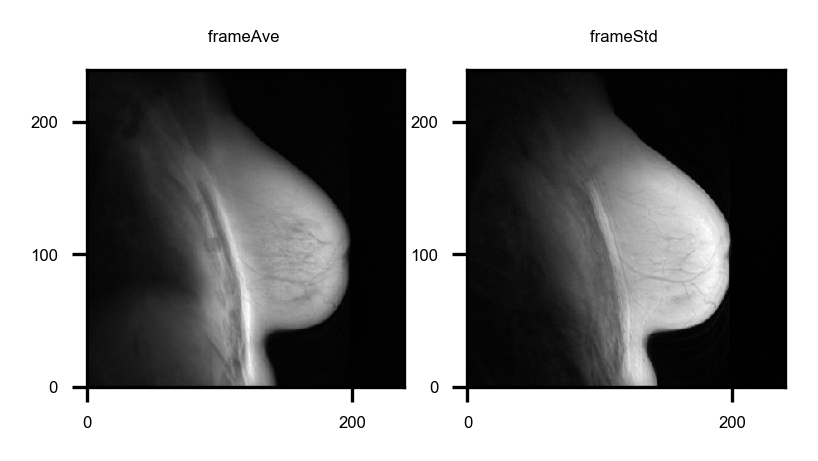

In [632]:


frameAve = np.average(dataNorm, axis=2)
frameStd = np.std(dataNorm, axis=2)

pyplot.figure(figsize=(3, 20), dpi=300)

ax = pyplot.subplot(1,2,1, aspect='equal')
pyplot.pcolormesh(x, y, frameAve);
pyplot.title('frameAve ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(1,2,2, aspect='equal')
pyplot.pcolormesh(x, y, frameStd);
pyplot.title('frameStd ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

In [631]:
frameAve2 = np.zeros((dimY, dimX), dtype='uint8')
frameStd2 = np.zeros((dimY, dimX), dtype='uint8')

for c in range(dimX):
    for r in range(dimY):
        vals = []
        
        for f in range(dimZ):
            vals.append(dataNorm[r,c,f])
            
        valsAve = np.average(vals)
        valsStd = np.std(vals)
        
        frameAve2[r,c] = valsAve
        frameStd2[r,c] = valsStd

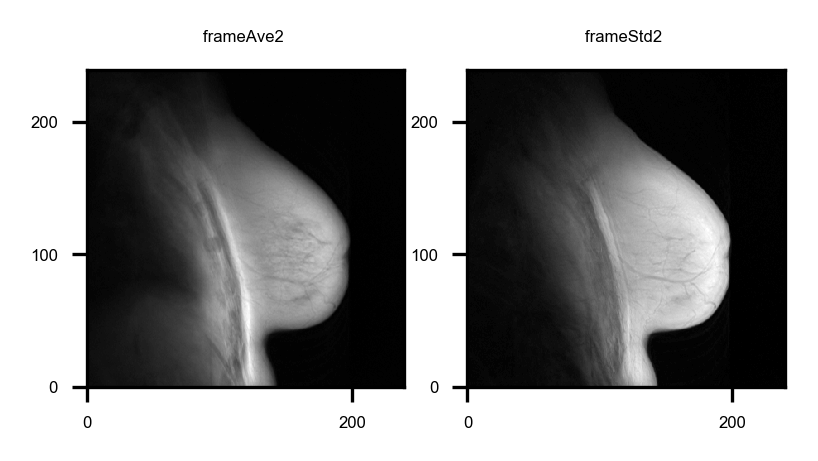

In [633]:


pyplot.figure(figsize=(3, 20), dpi=300)

ax = pyplot.subplot(1,2,1, aspect='equal')
pyplot.pcolormesh(x, y, frameAve2);
pyplot.title('frameAve2 ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
ax = pyplot.subplot(1,2,2, aspect='equal')
pyplot.pcolormesh(x, y, frameStd2);
pyplot.title('frameStd2 ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)

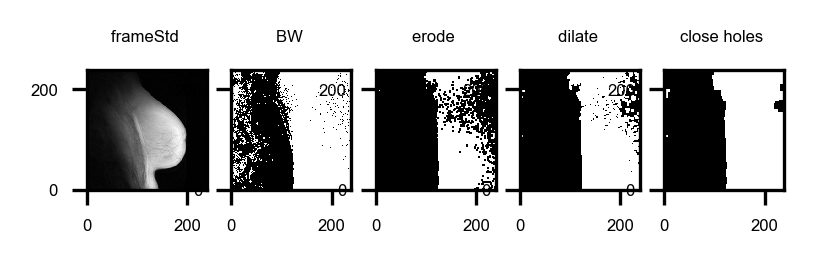

In [642]:
frameStd = np.std(dataNorm, axis=2)

frameStdMax = np.max(frameStd[:,:])

thresh_std = 0.2 # 20% of frameStdMax
thresh_std = 0.05 # 5% of frameStdMax
#thresh_std = 0.01 # 1% of frameStdMax
#thresh_std = 0.5 # 50% of frameStdMax
#thresh_std = 0.9 # 90% of frameStdMax


Kernel1 = np.ones((1,1),np.uint8) # used for dilate
Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel7 = np.ones((7,7),np.uint8) # used for closing holes
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes
Kernel20 = np.ones((20,20),np.uint8) # used for closing holes
Kernel50 = np.ones((50,50),np.uint8) # used for closing holes

#blurKernel = 3
#blurKernel = 5
#blurKernel = 7


# Create empty 3D array for the bodyAndBreastMasks
# and backgroundMasks for each frame:
#bodyAndBreastMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')
#backgroundMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

ax = pyplot.subplot(1,5,1, aspect='equal')
pyplot.pcolormesh(x, y, frameStd);
pyplot.title('frameStd ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)
    
# Convert to B&W using thresh:
thresh = frameStdMax*thresh_std

# Create empty array for mask:
mask = np.zeros((dimY, dimX), dtype='uint8')

for r in range(dimY):
    for c in range(dimX):
        if frame[r,c] < thresh:
            mask[r,c] = 255

ax = pyplot.subplot(1,5,2, aspect='equal')
pyplot.pcolormesh(x, y, mask);
pyplot.title('BW ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)



# Erode:
#out = cv2.erode(out, Kernel3, iterations = 5) 
#mask = cv2.erode(mask, Kernel3, iterations = 3)
#mask = cv2.erode(mask, Kernel2, iterations = 3)
#mask = cv2.erode(mask, Kernel2, iterations = 7)
#mask = cv2.erode(mask, Kernel2, iterations = 10)
#mask = cv2.erode(mask, Kernel2, iterations = 15)
#mask = cv2.erode(mask, Kernel2, iterations = 20) # seems ok
#mask = cv2.erode(mask, Kernel2, iterations = 30)
#mask = cv2.erode(mask, Kernel3, iterations = 5)
#mask = cv2.erode(mask, Kernel2, iterations = 3)
mask = cv2.erode(mask, Kernel3, iterations = 3)

ax = pyplot.subplot(1,5,3, aspect='equal')
pyplot.pcolormesh(x, y, mask);
pyplot.title('erode ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)



# Dilate:
#out = cv2.dilate(out, Kernel3, iterations = 7) 
#mask = cv2.dilate(mask, Kernel3, iterations = 3) 
#mask = cv2.dilate(mask, Kernel3, iterations = 10)
#mask = cv2.dilate(mask, Kernel2, iterations = 10)
#mask = cv2.dilate(mask, Kernel3, iterations = 10)
#mask = cv2.dilate(mask, Kernel5, iterations = 3)
mask = cv2.dilate(mask, Kernel3, iterations = 3)

ax = pyplot.subplot(1,5,4, aspect='equal')
pyplot.pcolormesh(x, y, mask);
pyplot.title('dilate ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)



# Close holes:
#out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
#out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
#mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) 
#mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11) 
mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel20) 

ax = pyplot.subplot(1,5,5, aspect='equal')
pyplot.pcolormesh(x, y, mask);
pyplot.title('close holes ', **title_font)

# Set the tick labels font
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontname('Arial')
    label.set_fontsize(4)


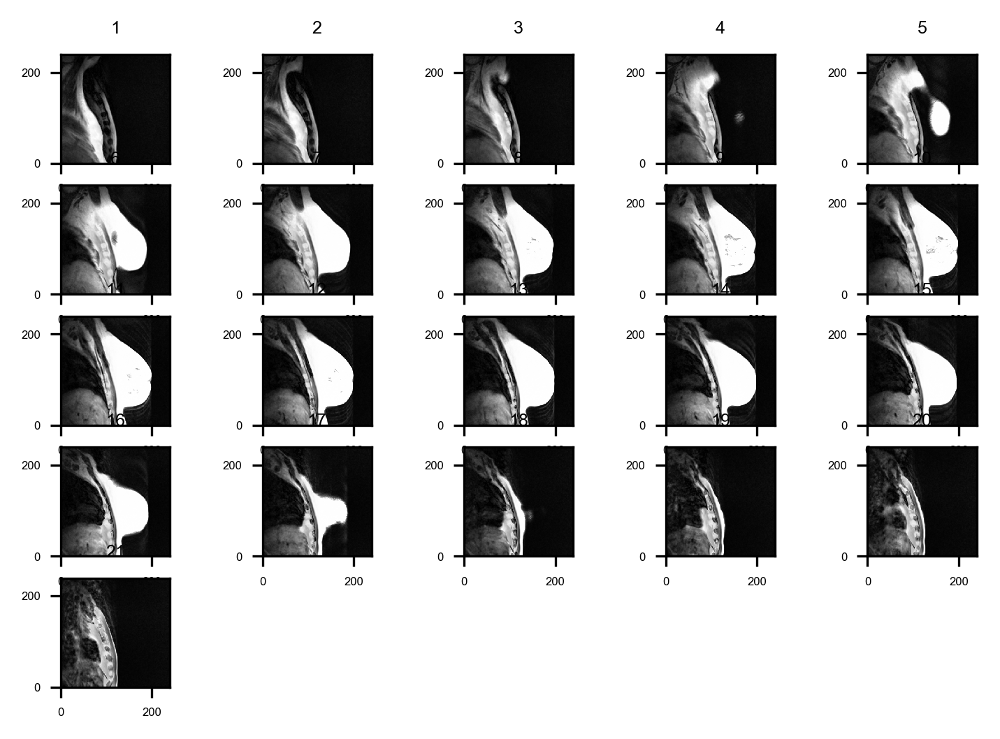

In [644]:
"""
This was the best result before the uint8 conversion.  Now try this using dataNorm...
"""

# Subtract the *blurred* last frame from all *blurred* frames:

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'6', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

#frameLast = data[:,:,dimZ-1]
frameLast = dataNorm[:,:,dimZ-1]

blurKernel = 3
blurKernel = 5
#blurKernel = 7
frameLastBlurred = cv2.GaussianBlur(frameLast, (blurKernel, blurKernel), 0)

# Create empty 3D array:
dataDiff = np.zeros((dimY, dimX, dimZ-1), dtype='uint8')

pyplot.figure(dpi=300)

for f in range(dimZ-1):
    frame = data[:,:,f]
    
    frameBlurred = cv2.GaussianBlur(frame, (blurKernel, blurKernel), 0)
    
    #frameDiff = - (frameBlurred - frameLastBlurred)
    frameDiff = cv2.absdiff(cv2.convertScaleAbs(frameBlurred), cv2.convertScaleAbs(frameLastBlurred))
    
    dataDiff[:,:,f] = frameDiff
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiff, (blurKernel, blurKernel), 0)
    
    #frameDiffBlurred = cv2.GaussianBlur(frameDiffBlurred, (blurKernel, blurKernel), 0)

    ax = pyplot.subplot(5,5,1+f, aspect='equal')
    pyplot.pcolormesh(x, y, frameDiff);
    #pyplot.pcolormesh(x, y, frameDiffBlurred);
    pyplot.title(str(1+f), **title_font)
    
    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

In [645]:
dataDiff.dtype

dtype('uint8')

# Instead of using cv.threshold use for loops and different thresholds:
# This time use dataDiff

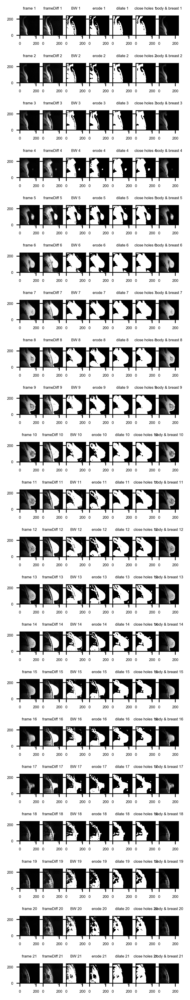

In [646]:
# Use dataDiff:

    
# Try different thresholds for body, breast and background
# using ave pix value (avePixVal) in each frame or
# using ave pix value across all frames:

ave_all_frames = 0 # use ave on frame-by-frame basis
ave_all_frames = 1 # use ave across all frames 

avePixVal = np.average(dataDiff[:,:,:]) # this will be updated if ave_all_frames = 0

    
# Thresholds expressed as a % of avePixVal 
# for any given frame:
if use_blurred:
    #thresh_background = 0.2 # = 20%
    thresh_background = 0.1 # = 10%
#thresh_background = 0.02 # = 2%
#thresh_background = 0.005 # = 0.5%
if not use_blurred:
    thresh_background = 0.0001 # = 0.01% <-- seems good for dataNorm
    thresh_background = 0.5 # = 50%
    thresh_background = 0.25 # = 25%
    thresh_background = 0.35 # = 35%
    thresh_background = 0.4 # = 40% of avePixVal <---- seems to be ideal for normal images
    #thresh_background = 0.8 # = 80%
    #thresh_background = 0.9 # = 90%
    #thresh_background = 0.95 # = 95%
    #thresh_background = 1.25 # = 125%
    #thresh_background = 1.15 # = 115%
    #thresh_background = 1.05 # = 105%
#thresh_background = 0.00001 # = 0.001%
thresh_body = 0.15 # = 15%
thresh_breast = 0.40 # = 40%

Kernel1 = np.ones((1,1),np.uint8) # used for dilate
Kernel2 = np.ones((2,2),np.uint8) # used for dilate
Kernel3 = np.ones((3,3),np.uint8) # used for dilate
Kernel5 = np.ones((5,5),np.uint8) # used for dilate
Kernel7 = np.ones((7,7),np.uint8) # used for closing holes
Kernel11 = np.ones((11,11),np.uint8) # used for closing holes
Kernel20 = np.ones((20,20),np.uint8) # used for closing holes
Kernel50 = np.ones((50,50),np.uint8) # used for closing holes



# Create empty 3D array for the bodyAndBreastMasks
# and backgroundMasks for each frame:
#bodyAndBreastMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')
#backgroundMasks = np.zeros((dimY, dimX, dimZ), dtype='bool')

# Set the font dictionaries (for plot title and axis titles)
title_font = {'fontname':'Arial', 'size':'4', 'color':'black', 'weight':'normal',
              'verticalalignment':'bottom'} # Bottom vertical alignment for more space
axis_font = {'fontname':'Arial', 'size':'6'}

pyplot.figure(figsize=(3, 20), dpi=300)

i = 0 # for subplot pos

cols = 7

for f in range(dimZ-1):
    frame = dataNorm[:,:,f]
    frameDiff = dataDiff[:,:,f]
    
    if not ave_all_frames:
        avePixVal = np.average(frame[:,:])
    
    i = i + 1    
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, frame);
    pyplot.title('frame ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
     
    
    i = i + 1    
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, frameDiff);
    pyplot.title('frameDiff ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
    
    
    
    """ First isolate the body and breast using thresh_background: """
    
    # Convert to B&W using thresh:
    thresh = avePixVal*thresh_background
    #thresh = InvAvePixVal*thresh_background
    
    #print('thresh_background = ', str(thresh_background))
    #print('avePixVal = ', str(avePixVal))
    #print('thresh = ', str(thresh), '\n')
    
    #mask = cv2.threshold(frame, thresh, 255, cv2.THRESH_BINARY)[1]
    #mask = cv2.threshold(frameInv, thresh, 255, cv2.THRESH_BINARY)[1]

    # Take inverse of mask:
    #mask = 255 - mask
    
    # Create empty array for mask:
    mask = np.zeros((dimY, dimX), dtype='uint8')
    
    for r in range(dimY):
        for c in range(dimX):
            #if frame[r,c] > thresh:
            if frameDiff[r,c] > thresh:
                mask[r,c] = 255
    
    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('BW ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

        
      
    # Erode:
    #out = cv2.erode(out, Kernel3, iterations = 5) 
    #mask = cv2.erode(mask, Kernel3, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 3)
    #mask = cv2.erode(mask, Kernel2, iterations = 7)
    #mask = cv2.erode(mask, Kernel2, iterations = 10)
    #mask = cv2.erode(mask, Kernel2, iterations = 15)
    #mask = cv2.erode(mask, Kernel2, iterations = 20) # seems ok
    #mask = cv2.erode(mask, Kernel2, iterations = 30)
    #mask = cv2.erode(mask, Kernel3, iterations = 5)
    #mask = cv2.erode(mask, Kernel2, iterations = 3)
    mask = cv2.erode(mask, Kernel3, iterations = 3)

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('erode ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)

    
    
    # Dilate:
    #out = cv2.dilate(out, Kernel3, iterations = 7) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 3) 
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    #mask = cv2.dilate(mask, Kernel2, iterations = 10)
    #mask = cv2.dilate(mask, Kernel3, iterations = 10)
    mask = cv2.dilate(mask, Kernel5, iterations = 3)
    #mask = cv2.dilate(mask, Kernel3, iterations = 3)

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('dilate ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
            
            
    
    # Close holes:
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel3) 
    #out = cv2.morphologyEx(out, cv2.MORPH_CLOSE, Kernel11) 
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel7) 
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel11) 
    #mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, Kernel20) 

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, mask);
    pyplot.title('close holes ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)
        
        

    
    # Convert mask to binary:
    bodyAndBreastMask = cv2.threshold(mask, 255/2, 1, cv2.THRESH_BINARY)[1]

    # Background mask is the logical compliment of bodyAndBreastMask:
    backgroundMask = np.logical_not(bodyAndBreastMask)

    # Store masks in 3D arrays:
    bodyAndBreastMasks[:,:,f] = bodyAndBreastMask
    backgroundMasks[:,:,f] = backgroundMask

    # Show result of bodyAndBreastMask:
    bodyAndBreast = bodyAndBreastMask*frame

    i = i + 1
    ax = pyplot.subplot(dimZ,cols,i, aspect='equal')
    pyplot.pcolormesh(x, y, bodyAndBreast);
    pyplot.title('body & breast ' + str(f+1), **title_font)

    # Set the tick labels font
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontname('Arial')
        label.set_fontsize(4)


In [647]:
# clearly there's a problem above - the ribs from the last frame, which was subtracted
# from the first frame is visible in frameDiff, although no ribs are visible in frame!
# So can't use dataDiff. 